# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

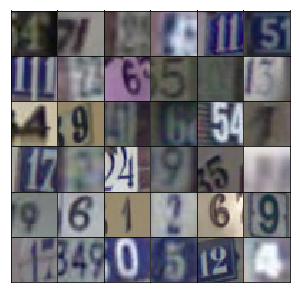

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [124]:
def LReLU (x, alpha=0.2):
    return tf.maximum (x * alpha, x)

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):

    print ("generator():")
    print ("...z.shape:", z.shape.as_list())
    print ("...output_dim:", output_dim)
    
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 16384)
        x = tf.reshape(x, [-1, 4, 4, 1024])
        x = tf.layers.batch_normalization(x, training=training)
        x = LReLU(x, alpha)
        
        print ("...x.shape():", x.shape.as_list())
        
        x = tf.layers.conv2d_transpose(x, filters=512, kernel_size=3, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=training)
        x = LReLU(x, alpha)
        print ("...x.shape():", x.shape.as_list())
        
        x = tf.layers.conv2d_transpose(x, filters=256, kernel_size=3, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=training)
        x = LReLU(x, alpha)
        print ("...x.shape():", x.shape.as_list())

        logits = tf.layers.conv2d_transpose(x, filters=output_dim, kernel_size=3, strides=2, padding="same")
        print ("...logits.shape():", logits.shape.as_list())
        
        # Output layer, 32x32x3
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [125]:
def discriminator(x, reuse=False, alpha=0.2):
    initial_depth=64
    
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, filters=initial_depth, kernel_size=3, strides=2, padding="same")
        #--- x = tf.layers.batch_normalization(x, training=True, reuse=reuse)
        x = LReLU(x, alpha)
        
        x = tf.layers.conv2d(x, filters=initial_depth*2, kernel_size=3, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=True)
        x = LReLU(x, alpha)
        
        x = tf.layers.conv2d(x, filters=initial_depth*4, kernel_size=3, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=True)
        x = LReLU(x, alpha)
        
        x_shape = x.shape.as_list()[1:3]
        
        flat = tf.reshape(x, [-1, np.prod(x_shape)])
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [126]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [127]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [128]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [129]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [130]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [131]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


Epoch 1/25... Discriminator Loss: 1.2808... Generator Loss: 0.6336
Epoch 1/25... Discriminator Loss: 1.3051... Generator Loss: 0.6451
Epoch 1/25... Discriminator Loss: 1.2273... Generator Loss: 0.7059
Epoch 1/25... Discriminator Loss: 1.3488... Generator Loss: 0.6809
Epoch 1/25... Discriminator Loss: 1.3288... Generator Loss: 0.7296
Epoch 1/25... Discriminator Loss: 1.3952... Generator Loss: 0.6833
Epoch 1/25... Discriminator Loss: 1.3963... Generator Loss: 0.6950
Epoch 1/25... Discriminator Loss: 1.3996... Generator Loss: 0.7169
Epoch 1/25... Discriminator Loss: 1.3830... Generator Loss: 0.7039
Epoch 1/25... Discriminator Loss: 1.3776... Generator Loss: 0.7114
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


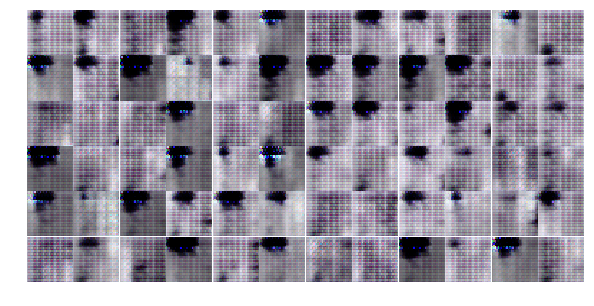

Epoch 1/25... Discriminator Loss: 1.3838... Generator Loss: 0.6945
Epoch 1/25... Discriminator Loss: 1.3547... Generator Loss: 0.7286
Epoch 1/25... Discriminator Loss: 1.3509... Generator Loss: 0.7123
Epoch 1/25... Discriminator Loss: 1.3548... Generator Loss: 0.7035
Epoch 1/25... Discriminator Loss: 1.3649... Generator Loss: 0.7287
Epoch 1/25... Discriminator Loss: 1.3489... Generator Loss: 0.7151
Epoch 1/25... Discriminator Loss: 1.3463... Generator Loss: 0.6913
Epoch 1/25... Discriminator Loss: 1.3411... Generator Loss: 0.7568
Epoch 1/25... Discriminator Loss: 1.3869... Generator Loss: 0.7790
Epoch 1/25... Discriminator Loss: 1.3700... Generator Loss: 0.7420
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


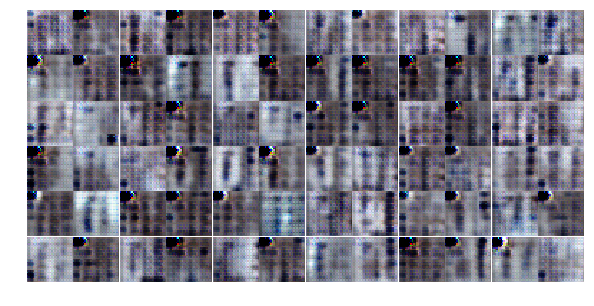

Epoch 1/25... Discriminator Loss: 1.3409... Generator Loss: 0.7392
Epoch 1/25... Discriminator Loss: 1.3536... Generator Loss: 0.7122
Epoch 1/25... Discriminator Loss: 1.3456... Generator Loss: 0.6835
Epoch 1/25... Discriminator Loss: 1.3032... Generator Loss: 0.7116
Epoch 1/25... Discriminator Loss: 1.3323... Generator Loss: 0.7498
Epoch 1/25... Discriminator Loss: 1.2883... Generator Loss: 0.7329
Epoch 1/25... Discriminator Loss: 1.2778... Generator Loss: 0.7323
Epoch 1/25... Discriminator Loss: 1.2337... Generator Loss: 0.8180
Epoch 1/25... Discriminator Loss: 1.3496... Generator Loss: 0.7468
Epoch 1/25... Discriminator Loss: 1.3442... Generator Loss: 0.7091
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


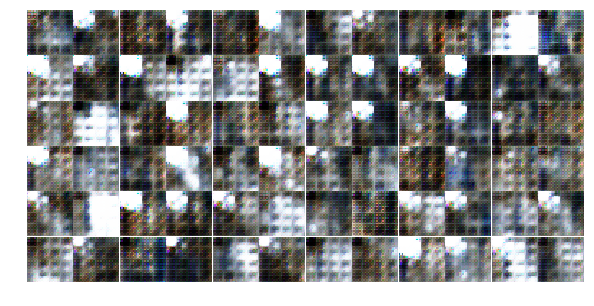

Epoch 1/25... Discriminator Loss: 1.3447... Generator Loss: 0.6990
Epoch 1/25... Discriminator Loss: 1.3588... Generator Loss: 0.8315
Epoch 1/25... Discriminator Loss: 1.2728... Generator Loss: 0.7936
Epoch 1/25... Discriminator Loss: 1.1612... Generator Loss: 0.7745
Epoch 1/25... Discriminator Loss: 1.1145... Generator Loss: 0.8555
Epoch 1/25... Discriminator Loss: 1.0144... Generator Loss: 0.9169
Epoch 1/25... Discriminator Loss: 1.0193... Generator Loss: 0.8983
Epoch 1/25... Discriminator Loss: 0.9587... Generator Loss: 0.9672
Epoch 1/25... Discriminator Loss: 0.8806... Generator Loss: 1.0299
Epoch 1/25... Discriminator Loss: 0.9069... Generator Loss: 1.0188
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


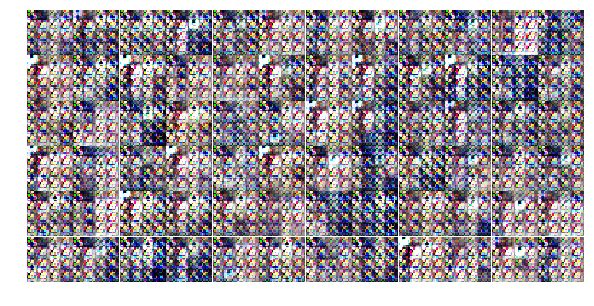

Epoch 1/25... Discriminator Loss: 0.8190... Generator Loss: 1.0771
Epoch 1/25... Discriminator Loss: 0.7563... Generator Loss: 1.1299
Epoch 1/25... Discriminator Loss: 0.7357... Generator Loss: 1.1761
Epoch 1/25... Discriminator Loss: 0.8229... Generator Loss: 1.2363
Epoch 1/25... Discriminator Loss: 0.6437... Generator Loss: 1.2842
Epoch 1/25... Discriminator Loss: 0.7007... Generator Loss: 1.3150
Epoch 1/25... Discriminator Loss: 0.5625... Generator Loss: 1.3993
Epoch 1/25... Discriminator Loss: 0.5319... Generator Loss: 1.5088
Epoch 1/25... Discriminator Loss: 0.8379... Generator Loss: 1.0633
Epoch 1/25... Discriminator Loss: 0.7651... Generator Loss: 1.4999
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


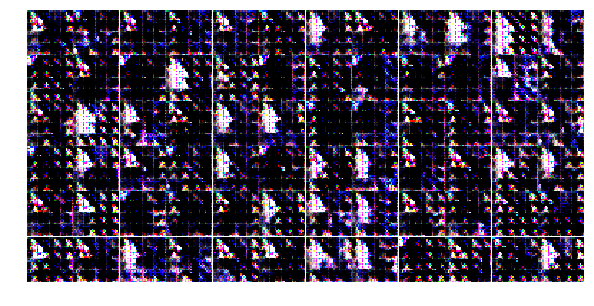

Epoch 1/25... Discriminator Loss: 1.1467... Generator Loss: 1.3245
Epoch 1/25... Discriminator Loss: 1.2347... Generator Loss: 0.8527
Epoch 1/25... Discriminator Loss: 1.1512... Generator Loss: 0.9900
Epoch 1/25... Discriminator Loss: 1.1810... Generator Loss: 0.6808
Epoch 1/25... Discriminator Loss: 1.2603... Generator Loss: 0.8960
Epoch 1/25... Discriminator Loss: 1.2263... Generator Loss: 0.6455
Epoch 1/25... Discriminator Loss: 1.2606... Generator Loss: 0.6565
Epoch 2/25... Discriminator Loss: 1.1826... Generator Loss: 0.6618
Epoch 2/25... Discriminator Loss: 1.3117... Generator Loss: 0.7485
Epoch 2/25... Discriminator Loss: 1.4247... Generator Loss: 0.5561
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


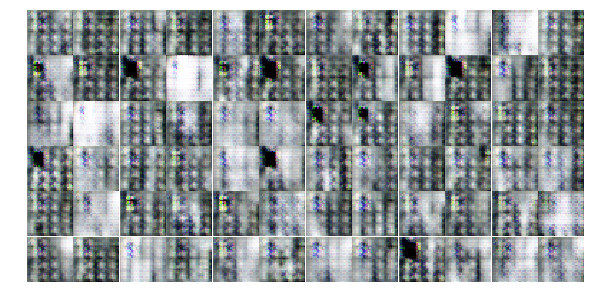

Epoch 2/25... Discriminator Loss: 1.3124... Generator Loss: 0.5991
Epoch 2/25... Discriminator Loss: 1.0724... Generator Loss: 0.8919
Epoch 2/25... Discriminator Loss: 1.1872... Generator Loss: 0.8902
Epoch 2/25... Discriminator Loss: 1.1939... Generator Loss: 0.7553
Epoch 2/25... Discriminator Loss: 1.1894... Generator Loss: 0.9868
Epoch 2/25... Discriminator Loss: 1.2166... Generator Loss: 0.9269
Epoch 2/25... Discriminator Loss: 1.3330... Generator Loss: 0.9075
Epoch 2/25... Discriminator Loss: 1.4606... Generator Loss: 0.5463
Epoch 2/25... Discriminator Loss: 1.1398... Generator Loss: 0.9256
Epoch 2/25... Discriminator Loss: 1.2413... Generator Loss: 0.8448
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


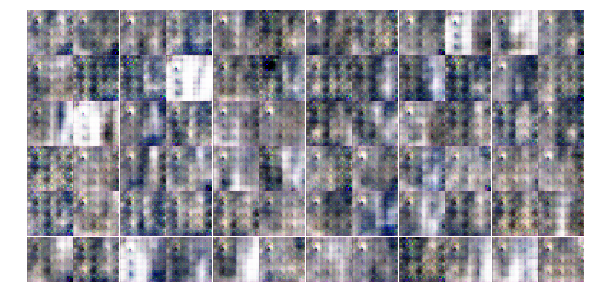

Epoch 2/25... Discriminator Loss: 1.4097... Generator Loss: 0.6133
Epoch 2/25... Discriminator Loss: 1.4222... Generator Loss: 0.7187
Epoch 2/25... Discriminator Loss: 1.3881... Generator Loss: 0.7195
Epoch 2/25... Discriminator Loss: 1.3815... Generator Loss: 0.7112
Epoch 2/25... Discriminator Loss: 1.3547... Generator Loss: 0.7149
Epoch 2/25... Discriminator Loss: 1.3816... Generator Loss: 0.7323
Epoch 2/25... Discriminator Loss: 1.3702... Generator Loss: 0.7240
Epoch 2/25... Discriminator Loss: 1.3650... Generator Loss: 0.7102
Epoch 2/25... Discriminator Loss: 1.3596... Generator Loss: 0.7496
Epoch 2/25... Discriminator Loss: 1.4055... Generator Loss: 0.6964
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


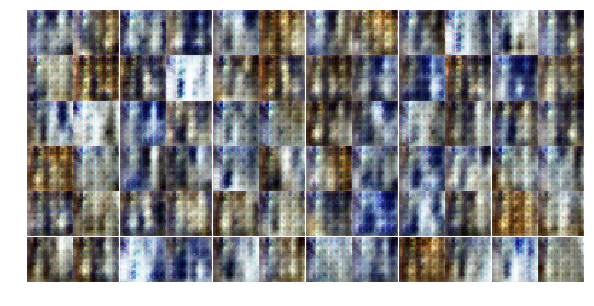

Epoch 2/25... Discriminator Loss: 1.3812... Generator Loss: 0.7091
Epoch 2/25... Discriminator Loss: 1.3722... Generator Loss: 0.7037
Epoch 2/25... Discriminator Loss: 1.3887... Generator Loss: 0.7235
Epoch 2/25... Discriminator Loss: 1.3790... Generator Loss: 0.7113
Epoch 2/25... Discriminator Loss: 1.3728... Generator Loss: 0.7070
Epoch 2/25... Discriminator Loss: 1.3464... Generator Loss: 0.7278
Epoch 2/25... Discriminator Loss: 1.3966... Generator Loss: 0.7201
Epoch 2/25... Discriminator Loss: 1.3697... Generator Loss: 0.6922
Epoch 2/25... Discriminator Loss: 1.3636... Generator Loss: 0.7425
Epoch 2/25... Discriminator Loss: 1.3911... Generator Loss: 0.7183
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


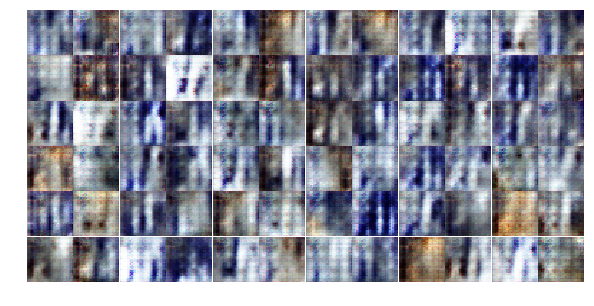

Epoch 2/25... Discriminator Loss: 1.3506... Generator Loss: 0.7409
Epoch 2/25... Discriminator Loss: 1.3723... Generator Loss: 0.7337
Epoch 2/25... Discriminator Loss: 1.4041... Generator Loss: 0.6592
Epoch 2/25... Discriminator Loss: 1.3847... Generator Loss: 0.7186
Epoch 2/25... Discriminator Loss: 1.3483... Generator Loss: 0.6877
Epoch 2/25... Discriminator Loss: 1.3904... Generator Loss: 0.7561
Epoch 2/25... Discriminator Loss: 1.3727... Generator Loss: 0.7090
Epoch 2/25... Discriminator Loss: 1.3998... Generator Loss: 0.7552
Epoch 2/25... Discriminator Loss: 1.3435... Generator Loss: 0.7401
Epoch 2/25... Discriminator Loss: 1.3808... Generator Loss: 0.7591
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


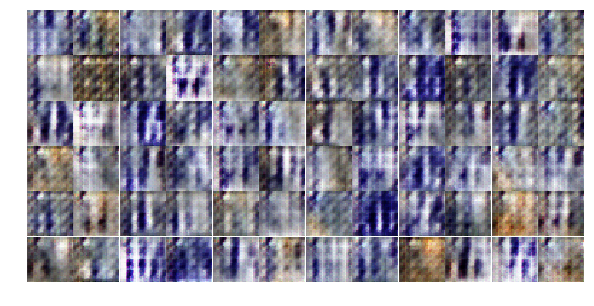

Epoch 2/25... Discriminator Loss: 1.3646... Generator Loss: 0.6960
Epoch 2/25... Discriminator Loss: 1.3359... Generator Loss: 0.7214
Epoch 2/25... Discriminator Loss: 1.3795... Generator Loss: 0.7006
Epoch 2/25... Discriminator Loss: 1.3564... Generator Loss: 0.7338
Epoch 2/25... Discriminator Loss: 1.3876... Generator Loss: 0.6820
Epoch 2/25... Discriminator Loss: 1.4103... Generator Loss: 0.6943
Epoch 2/25... Discriminator Loss: 1.3766... Generator Loss: 0.7557
Epoch 2/25... Discriminator Loss: 1.3912... Generator Loss: 0.7147
Epoch 2/25... Discriminator Loss: 1.3377... Generator Loss: 0.7057
Epoch 2/25... Discriminator Loss: 1.3763... Generator Loss: 0.6993
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


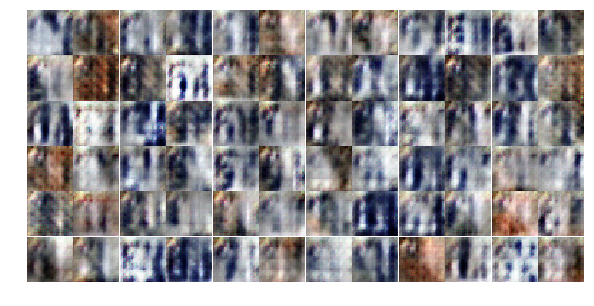

Epoch 2/25... Discriminator Loss: 1.3947... Generator Loss: 0.7440
Epoch 2/25... Discriminator Loss: 1.3864... Generator Loss: 0.6783
Epoch 2/25... Discriminator Loss: 1.3826... Generator Loss: 0.7210
Epoch 2/25... Discriminator Loss: 1.3615... Generator Loss: 0.7273
Epoch 3/25... Discriminator Loss: 1.3759... Generator Loss: 0.6657
Epoch 3/25... Discriminator Loss: 1.3626... Generator Loss: 0.7198
Epoch 3/25... Discriminator Loss: 1.3685... Generator Loss: 0.7270
Epoch 3/25... Discriminator Loss: 1.3805... Generator Loss: 0.7146
Epoch 3/25... Discriminator Loss: 1.3999... Generator Loss: 0.7241
Epoch 3/25... Discriminator Loss: 1.3802... Generator Loss: 0.7141
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


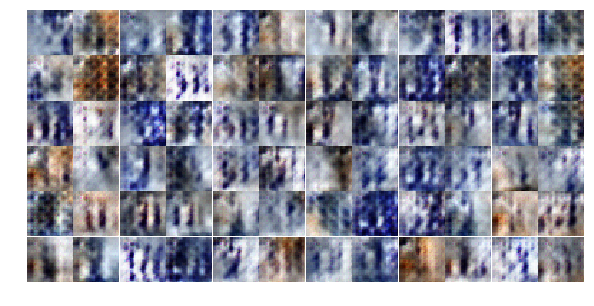

Epoch 3/25... Discriminator Loss: 1.3697... Generator Loss: 0.7065
Epoch 3/25... Discriminator Loss: 1.3757... Generator Loss: 0.7178
Epoch 3/25... Discriminator Loss: 1.3663... Generator Loss: 0.7337
Epoch 3/25... Discriminator Loss: 1.3967... Generator Loss: 0.6732
Epoch 3/25... Discriminator Loss: 1.3720... Generator Loss: 0.6968
Epoch 3/25... Discriminator Loss: 1.3717... Generator Loss: 0.7085
Epoch 3/25... Discriminator Loss: 1.3917... Generator Loss: 0.7154
Epoch 3/25... Discriminator Loss: 1.3801... Generator Loss: 0.7181
Epoch 3/25... Discriminator Loss: 1.3945... Generator Loss: 0.7118
Epoch 3/25... Discriminator Loss: 1.3517... Generator Loss: 0.7112
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


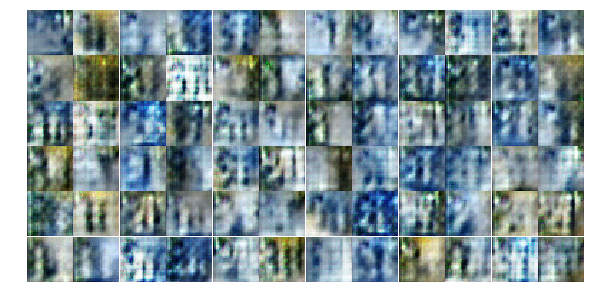

Epoch 3/25... Discriminator Loss: 1.3748... Generator Loss: 0.7031
Epoch 3/25... Discriminator Loss: 1.4051... Generator Loss: 0.7610
Epoch 3/25... Discriminator Loss: 1.3614... Generator Loss: 0.7200
Epoch 3/25... Discriminator Loss: 1.3718... Generator Loss: 0.7120
Epoch 3/25... Discriminator Loss: 1.3926... Generator Loss: 0.6940
Epoch 3/25... Discriminator Loss: 1.3711... Generator Loss: 0.7674
Epoch 3/25... Discriminator Loss: 1.3230... Generator Loss: 0.6910
Epoch 3/25... Discriminator Loss: 1.3797... Generator Loss: 0.7315
Epoch 3/25... Discriminator Loss: 1.3670... Generator Loss: 0.7029
Epoch 3/25... Discriminator Loss: 1.3807... Generator Loss: 0.6993
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


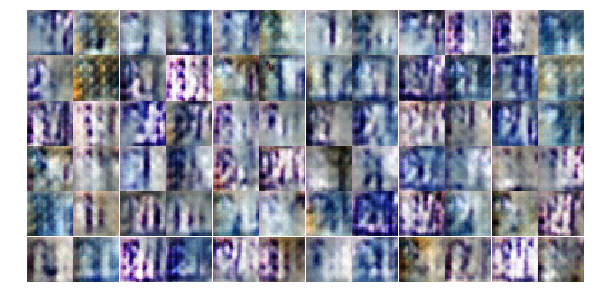

Epoch 3/25... Discriminator Loss: 1.3612... Generator Loss: 0.6927
Epoch 3/25... Discriminator Loss: 1.3779... Generator Loss: 0.6931
Epoch 3/25... Discriminator Loss: 1.3516... Generator Loss: 0.7257
Epoch 3/25... Discriminator Loss: 1.4263... Generator Loss: 0.7151
Epoch 3/25... Discriminator Loss: 1.3884... Generator Loss: 0.7052
Epoch 3/25... Discriminator Loss: 1.3827... Generator Loss: 0.6817
Epoch 3/25... Discriminator Loss: 1.4120... Generator Loss: 0.6979
Epoch 3/25... Discriminator Loss: 1.3693... Generator Loss: 0.7275
Epoch 3/25... Discriminator Loss: 1.3930... Generator Loss: 0.7246
Epoch 3/25... Discriminator Loss: 1.3770... Generator Loss: 0.6942
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


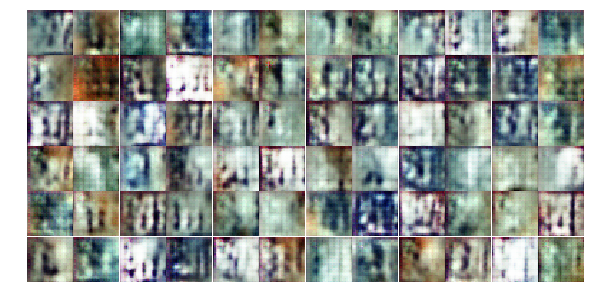

Epoch 3/25... Discriminator Loss: 1.3892... Generator Loss: 0.7151
Epoch 3/25... Discriminator Loss: 1.4077... Generator Loss: 0.6839
Epoch 3/25... Discriminator Loss: 1.3640... Generator Loss: 0.7124
Epoch 3/25... Discriminator Loss: 1.3756... Generator Loss: 0.7403
Epoch 3/25... Discriminator Loss: 1.3501... Generator Loss: 0.6890
Epoch 3/25... Discriminator Loss: 1.3874... Generator Loss: 0.7458
Epoch 3/25... Discriminator Loss: 1.3653... Generator Loss: 0.7077
Epoch 3/25... Discriminator Loss: 1.3909... Generator Loss: 0.7280
Epoch 3/25... Discriminator Loss: 1.3867... Generator Loss: 0.6878
Epoch 3/25... Discriminator Loss: 1.3883... Generator Loss: 0.7061
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


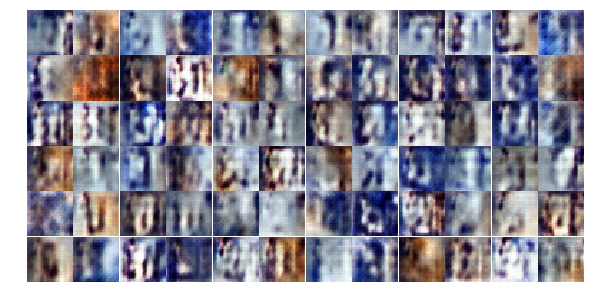

Epoch 3/25... Discriminator Loss: 1.3738... Generator Loss: 0.7195
Epoch 3/25... Discriminator Loss: 1.3614... Generator Loss: 0.6964
Epoch 3/25... Discriminator Loss: 1.3704... Generator Loss: 0.6856
Epoch 3/25... Discriminator Loss: 1.3860... Generator Loss: 0.7024
Epoch 3/25... Discriminator Loss: 1.3805... Generator Loss: 0.7049
Epoch 3/25... Discriminator Loss: 1.3501... Generator Loss: 0.7092
Epoch 3/25... Discriminator Loss: 1.3138... Generator Loss: 0.7187
Epoch 3/25... Discriminator Loss: 1.3334... Generator Loss: 0.7105
Epoch 3/25... Discriminator Loss: 1.3749... Generator Loss: 0.7889
Epoch 3/25... Discriminator Loss: 1.3855... Generator Loss: 0.7100
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


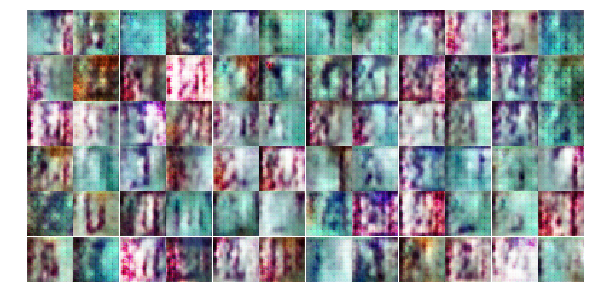

Epoch 3/25... Discriminator Loss: 1.3835... Generator Loss: 0.7097
Epoch 4/25... Discriminator Loss: 1.3757... Generator Loss: 0.6977
Epoch 4/25... Discriminator Loss: 1.3670... Generator Loss: 0.7054
Epoch 4/25... Discriminator Loss: 1.3906... Generator Loss: 0.6821
Epoch 4/25... Discriminator Loss: 1.3703... Generator Loss: 0.7143
Epoch 4/25... Discriminator Loss: 1.3646... Generator Loss: 0.7201
Epoch 4/25... Discriminator Loss: 1.3761... Generator Loss: 0.7134
Epoch 4/25... Discriminator Loss: 1.3613... Generator Loss: 0.7109
Epoch 4/25... Discriminator Loss: 1.3647... Generator Loss: 0.6628
Epoch 4/25... Discriminator Loss: 1.3928... Generator Loss: 0.7074
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


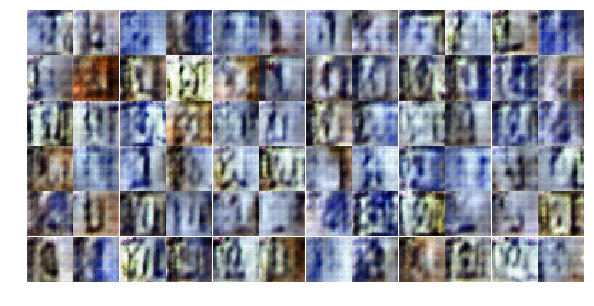

Epoch 4/25... Discriminator Loss: 1.3718... Generator Loss: 0.7249
Epoch 4/25... Discriminator Loss: 1.3612... Generator Loss: 0.7129
Epoch 4/25... Discriminator Loss: 1.3501... Generator Loss: 0.7081
Epoch 4/25... Discriminator Loss: 1.3507... Generator Loss: 0.7525
Epoch 4/25... Discriminator Loss: 1.3842... Generator Loss: 0.7312
Epoch 4/25... Discriminator Loss: 1.3920... Generator Loss: 0.7025
Epoch 4/25... Discriminator Loss: 1.3728... Generator Loss: 0.7356
Epoch 4/25... Discriminator Loss: 1.3939... Generator Loss: 0.6865
Epoch 4/25... Discriminator Loss: 1.3823... Generator Loss: 0.6873
Epoch 4/25... Discriminator Loss: 1.3712... Generator Loss: 0.7226
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


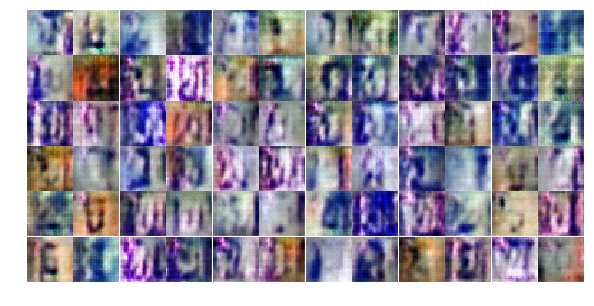

Epoch 4/25... Discriminator Loss: 1.3861... Generator Loss: 0.6917
Epoch 4/25... Discriminator Loss: 1.3660... Generator Loss: 0.6915
Epoch 4/25... Discriminator Loss: 1.3885... Generator Loss: 0.7484
Epoch 4/25... Discriminator Loss: 1.3652... Generator Loss: 0.6830
Epoch 4/25... Discriminator Loss: 1.3723... Generator Loss: 0.7329
Epoch 4/25... Discriminator Loss: 1.3872... Generator Loss: 0.6895
Epoch 4/25... Discriminator Loss: 1.3434... Generator Loss: 0.7281
Epoch 4/25... Discriminator Loss: 1.3619... Generator Loss: 0.6658
Epoch 4/25... Discriminator Loss: 1.3513... Generator Loss: 0.7051
Epoch 4/25... Discriminator Loss: 1.3713... Generator Loss: 0.7570
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


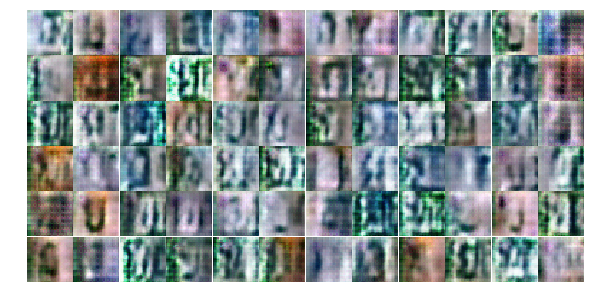

Epoch 4/25... Discriminator Loss: 1.3585... Generator Loss: 0.7223
Epoch 4/25... Discriminator Loss: 1.3845... Generator Loss: 0.6826
Epoch 4/25... Discriminator Loss: 1.3585... Generator Loss: 0.7178
Epoch 4/25... Discriminator Loss: 1.3321... Generator Loss: 0.6743
Epoch 4/25... Discriminator Loss: 1.3729... Generator Loss: 0.7208
Epoch 4/25... Discriminator Loss: 1.3706... Generator Loss: 0.7478
Epoch 4/25... Discriminator Loss: 1.3975... Generator Loss: 0.6940
Epoch 4/25... Discriminator Loss: 1.3704... Generator Loss: 0.6949
Epoch 4/25... Discriminator Loss: 1.3412... Generator Loss: 0.7121
Epoch 4/25... Discriminator Loss: 1.3815... Generator Loss: 0.6986
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


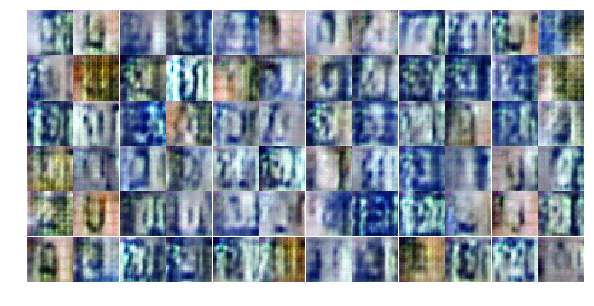

Epoch 4/25... Discriminator Loss: 1.3685... Generator Loss: 0.7233
Epoch 4/25... Discriminator Loss: 1.3880... Generator Loss: 0.7020
Epoch 4/25... Discriminator Loss: 1.3983... Generator Loss: 0.6816
Epoch 4/25... Discriminator Loss: 1.3496... Generator Loss: 0.7224
Epoch 4/25... Discriminator Loss: 1.3718... Generator Loss: 0.6937
Epoch 4/25... Discriminator Loss: 1.3825... Generator Loss: 0.6652
Epoch 4/25... Discriminator Loss: 1.3911... Generator Loss: 0.6915
Epoch 4/25... Discriminator Loss: 1.3879... Generator Loss: 0.7624
Epoch 4/25... Discriminator Loss: 1.3917... Generator Loss: 0.6750
Epoch 4/25... Discriminator Loss: 1.4038... Generator Loss: 0.7204
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


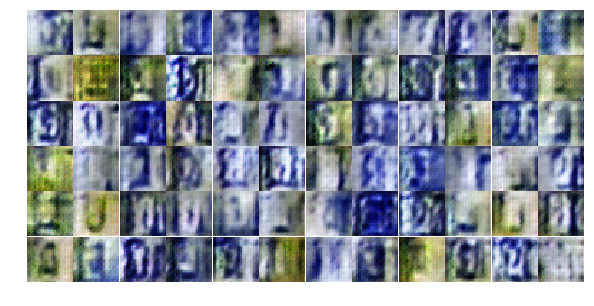

Epoch 4/25... Discriminator Loss: 1.3684... Generator Loss: 0.7041
Epoch 4/25... Discriminator Loss: 1.3644... Generator Loss: 0.6763
Epoch 4/25... Discriminator Loss: 1.3805... Generator Loss: 0.7129
Epoch 4/25... Discriminator Loss: 1.4126... Generator Loss: 0.7221
Epoch 4/25... Discriminator Loss: 1.3715... Generator Loss: 0.6978
Epoch 4/25... Discriminator Loss: 1.3712... Generator Loss: 0.7142
Epoch 4/25... Discriminator Loss: 1.3694... Generator Loss: 0.6901
Epoch 4/25... Discriminator Loss: 1.3643... Generator Loss: 0.6552
Epoch 4/25... Discriminator Loss: 1.3848... Generator Loss: 0.7030
Epoch 5/25... Discriminator Loss: 1.3799... Generator Loss: 0.7114
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


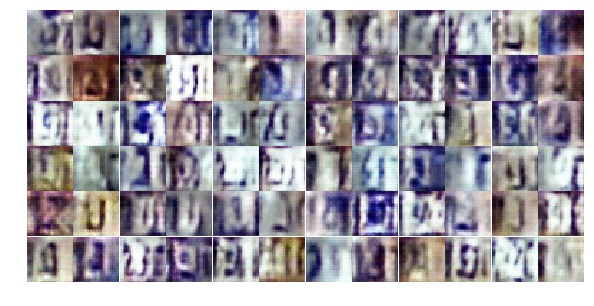

Epoch 5/25... Discriminator Loss: 1.3953... Generator Loss: 0.6874
Epoch 5/25... Discriminator Loss: 1.3879... Generator Loss: 0.7274
Epoch 5/25... Discriminator Loss: 1.3687... Generator Loss: 0.7036
Epoch 5/25... Discriminator Loss: 1.3573... Generator Loss: 0.7211
Epoch 5/25... Discriminator Loss: 1.3676... Generator Loss: 0.6878
Epoch 5/25... Discriminator Loss: 1.3694... Generator Loss: 0.6903
Epoch 5/25... Discriminator Loss: 1.3775... Generator Loss: 0.7130
Epoch 5/25... Discriminator Loss: 1.3751... Generator Loss: 0.7115
Epoch 5/25... Discriminator Loss: 1.3724... Generator Loss: 0.7258
Epoch 5/25... Discriminator Loss: 1.3722... Generator Loss: 0.7067
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


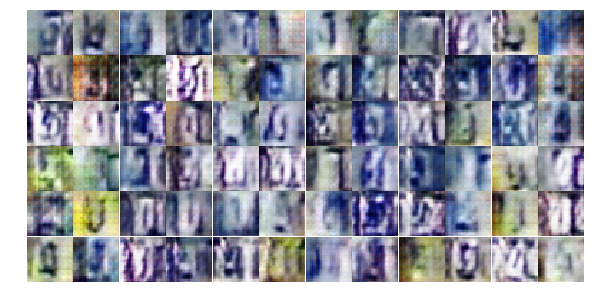

Epoch 5/25... Discriminator Loss: 1.3821... Generator Loss: 0.6928
Epoch 5/25... Discriminator Loss: 1.3674... Generator Loss: 0.7041
Epoch 5/25... Discriminator Loss: 1.3845... Generator Loss: 0.6858
Epoch 5/25... Discriminator Loss: 1.3632... Generator Loss: 0.7028
Epoch 5/25... Discriminator Loss: 1.3718... Generator Loss: 0.7310
Epoch 5/25... Discriminator Loss: 1.3862... Generator Loss: 0.6773
Epoch 5/25... Discriminator Loss: 1.3912... Generator Loss: 0.6677
Epoch 5/25... Discriminator Loss: 1.3704... Generator Loss: 0.6812
Epoch 5/25... Discriminator Loss: 1.3867... Generator Loss: 0.6783
Epoch 5/25... Discriminator Loss: 1.3744... Generator Loss: 0.6950
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


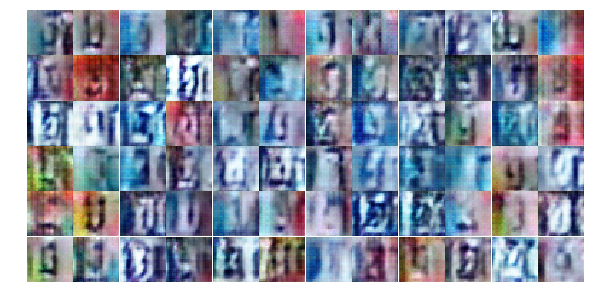

Epoch 5/25... Discriminator Loss: 1.3822... Generator Loss: 0.7217
Epoch 5/25... Discriminator Loss: 1.3754... Generator Loss: 0.7040
Epoch 5/25... Discriminator Loss: 1.3854... Generator Loss: 0.7123
Epoch 5/25... Discriminator Loss: 1.3655... Generator Loss: 0.7059
Epoch 5/25... Discriminator Loss: 1.3755... Generator Loss: 0.7028
Epoch 5/25... Discriminator Loss: 1.3775... Generator Loss: 0.7196
Epoch 5/25... Discriminator Loss: 1.3808... Generator Loss: 0.7124
Epoch 5/25... Discriminator Loss: 1.3649... Generator Loss: 0.7049
Epoch 5/25... Discriminator Loss: 1.3733... Generator Loss: 0.7078
Epoch 5/25... Discriminator Loss: 1.3724... Generator Loss: 0.7331
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


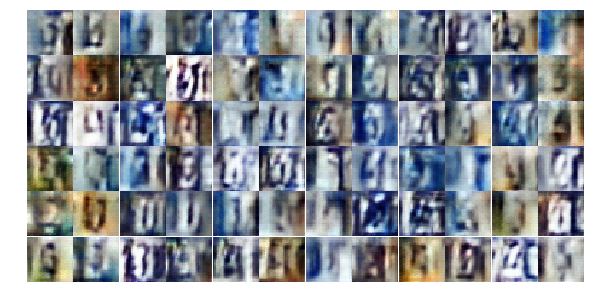

Epoch 5/25... Discriminator Loss: 1.3626... Generator Loss: 0.6925
Epoch 5/25... Discriminator Loss: 1.3620... Generator Loss: 0.7489
Epoch 5/25... Discriminator Loss: 1.3786... Generator Loss: 0.7020
Epoch 5/25... Discriminator Loss: 1.3647... Generator Loss: 0.7062
Epoch 5/25... Discriminator Loss: 1.3872... Generator Loss: 0.6664
Epoch 5/25... Discriminator Loss: 1.3716... Generator Loss: 0.7194
Epoch 5/25... Discriminator Loss: 1.3617... Generator Loss: 0.6823
Epoch 5/25... Discriminator Loss: 1.3736... Generator Loss: 0.7163
Epoch 5/25... Discriminator Loss: 1.3893... Generator Loss: 0.6952
Epoch 5/25... Discriminator Loss: 1.3423... Generator Loss: 0.7043
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


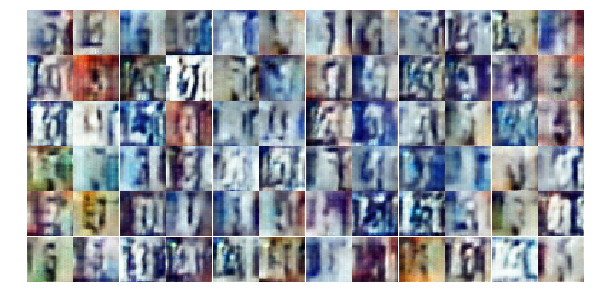

Epoch 5/25... Discriminator Loss: 1.3614... Generator Loss: 0.7395
Epoch 5/25... Discriminator Loss: 1.3702... Generator Loss: 0.6771
Epoch 5/25... Discriminator Loss: 1.3675... Generator Loss: 0.6899
Epoch 5/25... Discriminator Loss: 1.3640... Generator Loss: 0.7394
Epoch 5/25... Discriminator Loss: 1.3694... Generator Loss: 0.6817
Epoch 5/25... Discriminator Loss: 1.3759... Generator Loss: 0.7214
Epoch 5/25... Discriminator Loss: 1.3718... Generator Loss: 0.6928
Epoch 5/25... Discriminator Loss: 1.3656... Generator Loss: 0.7032
Epoch 5/25... Discriminator Loss: 1.3793... Generator Loss: 0.7190
Epoch 5/25... Discriminator Loss: 1.3758... Generator Loss: 0.6915
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


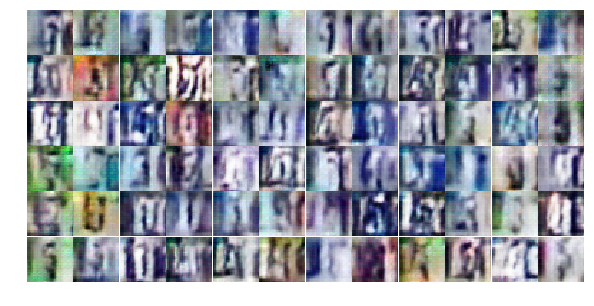

Epoch 5/25... Discriminator Loss: 1.3856... Generator Loss: 0.6809
Epoch 5/25... Discriminator Loss: 1.3744... Generator Loss: 0.7348
Epoch 5/25... Discriminator Loss: 1.3742... Generator Loss: 0.7109
Epoch 5/25... Discriminator Loss: 1.3692... Generator Loss: 0.6980
Epoch 5/25... Discriminator Loss: 1.3850... Generator Loss: 0.7032
Epoch 5/25... Discriminator Loss: 1.3717... Generator Loss: 0.7172
Epoch 6/25... Discriminator Loss: 1.3784... Generator Loss: 0.6826
Epoch 6/25... Discriminator Loss: 1.3764... Generator Loss: 0.6908
Epoch 6/25... Discriminator Loss: 1.3868... Generator Loss: 0.7112
Epoch 6/25... Discriminator Loss: 1.3763... Generator Loss: 0.6958
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


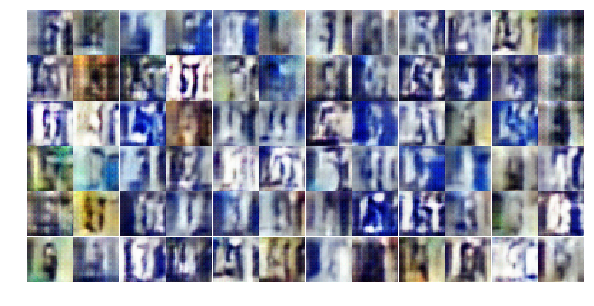

Epoch 6/25... Discriminator Loss: 1.3783... Generator Loss: 0.7347
Epoch 6/25... Discriminator Loss: 1.3897... Generator Loss: 0.6729
Epoch 6/25... Discriminator Loss: 1.3698... Generator Loss: 0.7110
Epoch 6/25... Discriminator Loss: 1.3704... Generator Loss: 0.7105
Epoch 6/25... Discriminator Loss: 1.3742... Generator Loss: 0.7091
Epoch 6/25... Discriminator Loss: 1.3855... Generator Loss: 0.7330
Epoch 6/25... Discriminator Loss: 1.3898... Generator Loss: 0.7047
Epoch 6/25... Discriminator Loss: 1.3873... Generator Loss: 0.7130
Epoch 6/25... Discriminator Loss: 1.3597... Generator Loss: 0.6883
Epoch 6/25... Discriminator Loss: 1.3765... Generator Loss: 0.7225
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


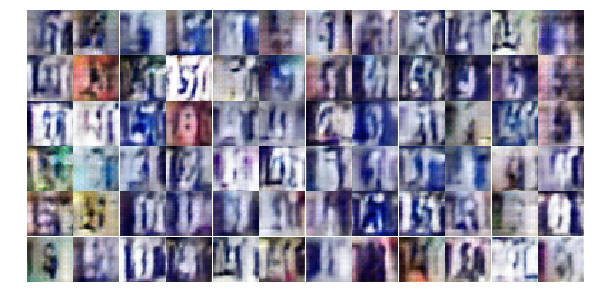

Epoch 6/25... Discriminator Loss: 1.3717... Generator Loss: 0.6876
Epoch 6/25... Discriminator Loss: 1.3764... Generator Loss: 0.7112
Epoch 6/25... Discriminator Loss: 1.3693... Generator Loss: 0.7232
Epoch 6/25... Discriminator Loss: 1.3577... Generator Loss: 0.6897
Epoch 6/25... Discriminator Loss: 1.3331... Generator Loss: 0.6763
Epoch 6/25... Discriminator Loss: 1.3912... Generator Loss: 0.6933
Epoch 6/25... Discriminator Loss: 1.4083... Generator Loss: 0.6919
Epoch 6/25... Discriminator Loss: 1.3895... Generator Loss: 0.7163
Epoch 6/25... Discriminator Loss: 1.3865... Generator Loss: 0.6805
Epoch 6/25... Discriminator Loss: 1.3849... Generator Loss: 0.7190
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


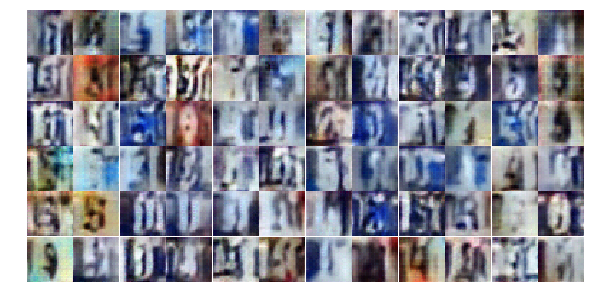

Epoch 6/25... Discriminator Loss: 1.3730... Generator Loss: 0.7119
Epoch 6/25... Discriminator Loss: 1.3871... Generator Loss: 0.6842
Epoch 6/25... Discriminator Loss: 1.3818... Generator Loss: 0.7066
Epoch 6/25... Discriminator Loss: 1.3754... Generator Loss: 0.7129
Epoch 6/25... Discriminator Loss: 1.3741... Generator Loss: 0.6978
Epoch 6/25... Discriminator Loss: 1.3825... Generator Loss: 0.6771
Epoch 6/25... Discriminator Loss: 1.3753... Generator Loss: 0.6980
Epoch 6/25... Discriminator Loss: 1.3718... Generator Loss: 0.7135
Epoch 6/25... Discriminator Loss: 1.3898... Generator Loss: 0.7145
Epoch 6/25... Discriminator Loss: 1.3714... Generator Loss: 0.7001
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


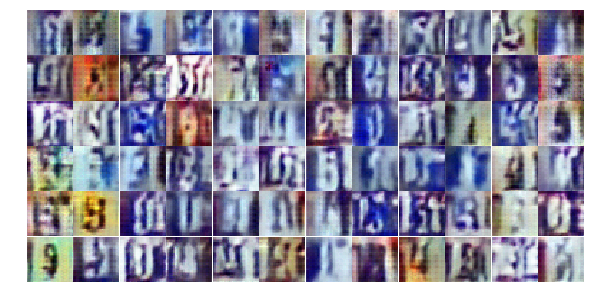

Epoch 6/25... Discriminator Loss: 1.3732... Generator Loss: 0.6986
Epoch 6/25... Discriminator Loss: 1.3755... Generator Loss: 0.6966
Epoch 6/25... Discriminator Loss: 1.3795... Generator Loss: 0.7105
Epoch 6/25... Discriminator Loss: 1.3662... Generator Loss: 0.7111
Epoch 6/25... Discriminator Loss: 1.3720... Generator Loss: 0.6907
Epoch 6/25... Discriminator Loss: 1.3888... Generator Loss: 0.6990
Epoch 6/25... Discriminator Loss: 1.3769... Generator Loss: 0.7263
Epoch 6/25... Discriminator Loss: 1.3793... Generator Loss: 0.6904
Epoch 6/25... Discriminator Loss: 1.3820... Generator Loss: 0.7153
Epoch 6/25... Discriminator Loss: 1.3575... Generator Loss: 0.7102
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


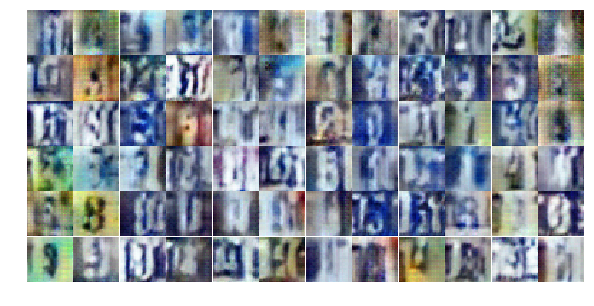

Epoch 6/25... Discriminator Loss: 1.3949... Generator Loss: 0.7089
Epoch 6/25... Discriminator Loss: 1.3741... Generator Loss: 0.7170
Epoch 6/25... Discriminator Loss: 1.3746... Generator Loss: 0.7098
Epoch 6/25... Discriminator Loss: 1.3840... Generator Loss: 0.6815
Epoch 6/25... Discriminator Loss: 1.3831... Generator Loss: 0.6960
Epoch 6/25... Discriminator Loss: 1.3727... Generator Loss: 0.7252
Epoch 6/25... Discriminator Loss: 1.3607... Generator Loss: 0.6887
Epoch 6/25... Discriminator Loss: 1.3941... Generator Loss: 0.6691
Epoch 6/25... Discriminator Loss: 1.3839... Generator Loss: 0.7020
Epoch 6/25... Discriminator Loss: 1.3911... Generator Loss: 0.6922
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


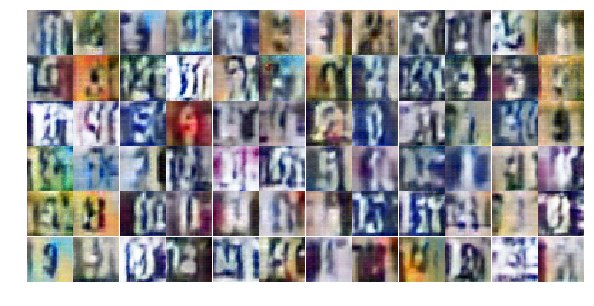

Epoch 6/25... Discriminator Loss: 1.3909... Generator Loss: 0.6955
Epoch 6/25... Discriminator Loss: 1.3430... Generator Loss: 0.7110
Epoch 6/25... Discriminator Loss: 1.3843... Generator Loss: 0.7105
Epoch 7/25... Discriminator Loss: 1.4021... Generator Loss: 0.6752
Epoch 7/25... Discriminator Loss: 1.3648... Generator Loss: 0.6970
Epoch 7/25... Discriminator Loss: 1.3942... Generator Loss: 0.7194
Epoch 7/25... Discriminator Loss: 1.3690... Generator Loss: 0.6736
Epoch 7/25... Discriminator Loss: 1.3787... Generator Loss: 0.7160
Epoch 7/25... Discriminator Loss: 1.3813... Generator Loss: 0.7351
Epoch 7/25... Discriminator Loss: 1.3680... Generator Loss: 0.6973
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


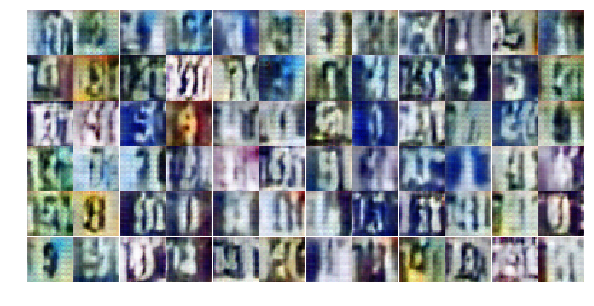

Epoch 7/25... Discriminator Loss: 1.3872... Generator Loss: 0.6926
Epoch 7/25... Discriminator Loss: 1.3874... Generator Loss: 0.7416
Epoch 7/25... Discriminator Loss: 1.3762... Generator Loss: 0.6899
Epoch 7/25... Discriminator Loss: 1.3773... Generator Loss: 0.7026
Epoch 7/25... Discriminator Loss: 1.3717... Generator Loss: 0.6915
Epoch 7/25... Discriminator Loss: 1.3924... Generator Loss: 0.7095
Epoch 7/25... Discriminator Loss: 1.3835... Generator Loss: 0.7394
Epoch 7/25... Discriminator Loss: 1.3835... Generator Loss: 0.6838
Epoch 7/25... Discriminator Loss: 1.3925... Generator Loss: 0.7071
Epoch 7/25... Discriminator Loss: 1.3654... Generator Loss: 0.7392
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


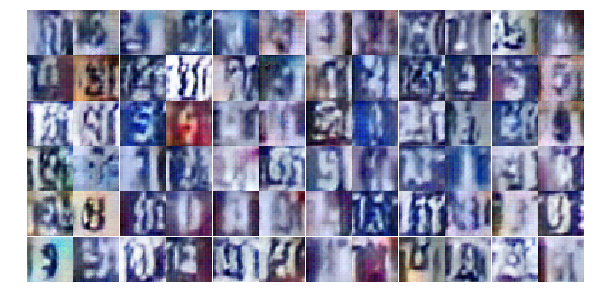

Epoch 7/25... Discriminator Loss: 1.3778... Generator Loss: 0.6790
Epoch 7/25... Discriminator Loss: 1.3778... Generator Loss: 0.6986
Epoch 7/25... Discriminator Loss: 1.4012... Generator Loss: 0.7017
Epoch 7/25... Discriminator Loss: 1.3881... Generator Loss: 0.6787
Epoch 7/25... Discriminator Loss: 1.3723... Generator Loss: 0.6911
Epoch 7/25... Discriminator Loss: 1.3812... Generator Loss: 0.7006
Epoch 7/25... Discriminator Loss: 1.3861... Generator Loss: 0.7095
Epoch 7/25... Discriminator Loss: 1.3870... Generator Loss: 0.6937
Epoch 7/25... Discriminator Loss: 1.3782... Generator Loss: 0.6753
Epoch 7/25... Discriminator Loss: 1.3892... Generator Loss: 0.6826
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


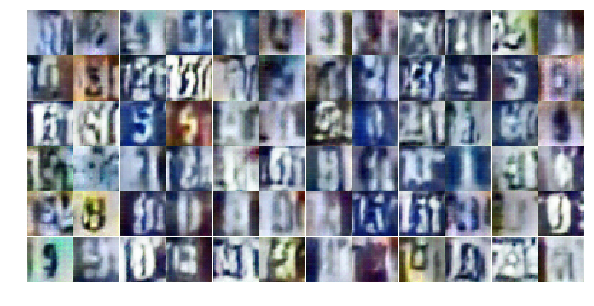

Epoch 7/25... Discriminator Loss: 1.3896... Generator Loss: 0.7070
Epoch 7/25... Discriminator Loss: 1.3737... Generator Loss: 0.7046
Epoch 7/25... Discriminator Loss: 1.3740... Generator Loss: 0.7027
Epoch 7/25... Discriminator Loss: 1.3890... Generator Loss: 0.6867
Epoch 7/25... Discriminator Loss: 1.3790... Generator Loss: 0.7125
Epoch 7/25... Discriminator Loss: 1.3842... Generator Loss: 0.6942
Epoch 7/25... Discriminator Loss: 1.4027... Generator Loss: 0.6845
Epoch 7/25... Discriminator Loss: 1.3757... Generator Loss: 0.7055
Epoch 7/25... Discriminator Loss: 1.3898... Generator Loss: 0.7027
Epoch 7/25... Discriminator Loss: 1.3864... Generator Loss: 0.6931
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


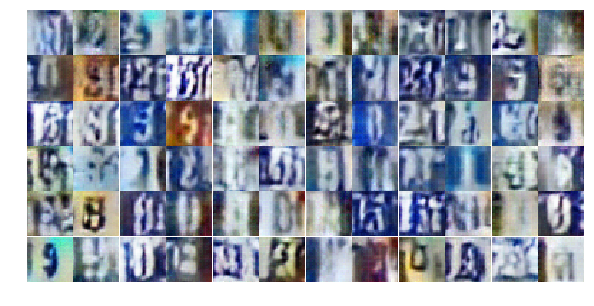

Epoch 7/25... Discriminator Loss: 1.3769... Generator Loss: 0.6984
Epoch 7/25... Discriminator Loss: 1.3747... Generator Loss: 0.6948
Epoch 7/25... Discriminator Loss: 1.3779... Generator Loss: 0.7083
Epoch 7/25... Discriminator Loss: 1.3856... Generator Loss: 0.7052
Epoch 7/25... Discriminator Loss: 1.3973... Generator Loss: 0.6948
Epoch 7/25... Discriminator Loss: 1.3778... Generator Loss: 0.6745
Epoch 7/25... Discriminator Loss: 1.3848... Generator Loss: 0.6989
Epoch 7/25... Discriminator Loss: 1.4182... Generator Loss: 0.6992
Epoch 7/25... Discriminator Loss: 1.3821... Generator Loss: 0.7045
Epoch 7/25... Discriminator Loss: 1.3778... Generator Loss: 0.7080
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


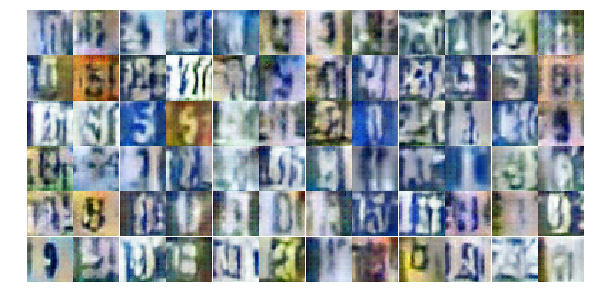

Epoch 7/25... Discriminator Loss: 1.3808... Generator Loss: 0.6802
Epoch 7/25... Discriminator Loss: 1.3804... Generator Loss: 0.7037
Epoch 7/25... Discriminator Loss: 1.3822... Generator Loss: 0.7000
Epoch 7/25... Discriminator Loss: 1.3641... Generator Loss: 0.6731
Epoch 7/25... Discriminator Loss: 1.3667... Generator Loss: 0.6923
Epoch 7/25... Discriminator Loss: 1.4034... Generator Loss: 0.7182
Epoch 7/25... Discriminator Loss: 1.3813... Generator Loss: 0.6954
Epoch 7/25... Discriminator Loss: 1.3796... Generator Loss: 0.6817
Epoch 7/25... Discriminator Loss: 1.3838... Generator Loss: 0.7142
Epoch 7/25... Discriminator Loss: 1.3704... Generator Loss: 0.6996
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


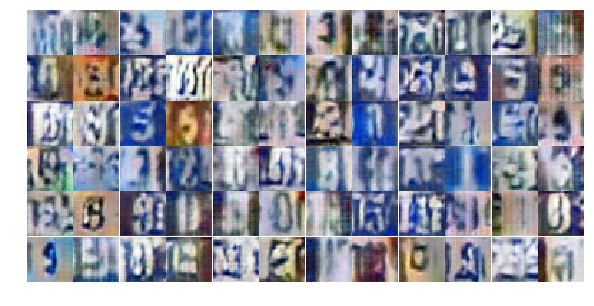

Epoch 7/25... Discriminator Loss: 1.3842... Generator Loss: 0.6782
Epoch 8/25... Discriminator Loss: 1.3738... Generator Loss: 0.7088
Epoch 8/25... Discriminator Loss: 1.3649... Generator Loss: 0.6707
Epoch 8/25... Discriminator Loss: 1.3857... Generator Loss: 0.6892
Epoch 8/25... Discriminator Loss: 1.3762... Generator Loss: 0.7169
Epoch 8/25... Discriminator Loss: 1.4001... Generator Loss: 0.6921
Epoch 8/25... Discriminator Loss: 1.3946... Generator Loss: 0.6826
Epoch 8/25... Discriminator Loss: 1.3706... Generator Loss: 0.6918
Epoch 8/25... Discriminator Loss: 1.3997... Generator Loss: 0.6969
Epoch 8/25... Discriminator Loss: 1.3796... Generator Loss: 0.7158
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


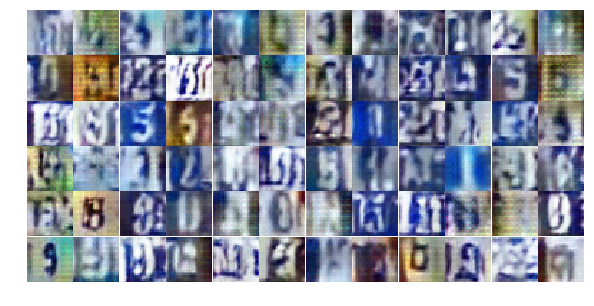

Epoch 8/25... Discriminator Loss: 1.3680... Generator Loss: 0.6916
Epoch 8/25... Discriminator Loss: 1.3754... Generator Loss: 0.7077
Epoch 8/25... Discriminator Loss: 1.3829... Generator Loss: 0.6860
Epoch 8/25... Discriminator Loss: 1.3840... Generator Loss: 0.6853
Epoch 8/25... Discriminator Loss: 1.3849... Generator Loss: 0.6991
Epoch 8/25... Discriminator Loss: 1.3545... Generator Loss: 0.6813
Epoch 8/25... Discriminator Loss: 1.3796... Generator Loss: 0.7017
Epoch 8/25... Discriminator Loss: 1.3776... Generator Loss: 0.6753
Epoch 8/25... Discriminator Loss: 1.3841... Generator Loss: 0.6876
Epoch 8/25... Discriminator Loss: 1.4035... Generator Loss: 0.6917
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


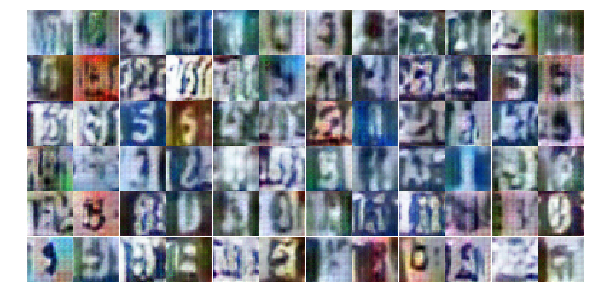

Epoch 8/25... Discriminator Loss: 1.3875... Generator Loss: 0.6827
Epoch 8/25... Discriminator Loss: 1.3669... Generator Loss: 0.6773
Epoch 8/25... Discriminator Loss: 1.3913... Generator Loss: 0.7169
Epoch 8/25... Discriminator Loss: 1.3770... Generator Loss: 0.6800
Epoch 8/25... Discriminator Loss: 1.4036... Generator Loss: 0.6861
Epoch 8/25... Discriminator Loss: 1.3823... Generator Loss: 0.7080
Epoch 8/25... Discriminator Loss: 1.3782... Generator Loss: 0.6995
Epoch 8/25... Discriminator Loss: 1.3995... Generator Loss: 0.7020
Epoch 8/25... Discriminator Loss: 1.3795... Generator Loss: 0.7106
Epoch 8/25... Discriminator Loss: 1.3802... Generator Loss: 0.6934
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


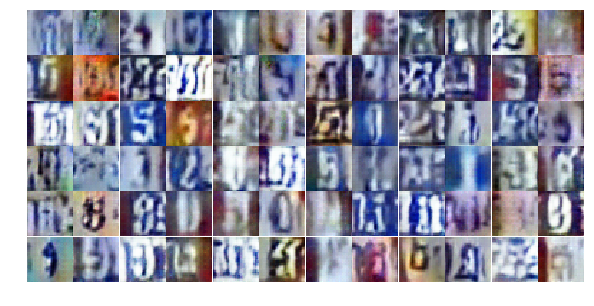

Epoch 8/25... Discriminator Loss: 1.3837... Generator Loss: 0.6816
Epoch 8/25... Discriminator Loss: 1.3808... Generator Loss: 0.7081
Epoch 8/25... Discriminator Loss: 1.3928... Generator Loss: 0.6807
Epoch 8/25... Discriminator Loss: 1.3742... Generator Loss: 0.6912
Epoch 8/25... Discriminator Loss: 1.3896... Generator Loss: 0.6784
Epoch 8/25... Discriminator Loss: 1.3773... Generator Loss: 0.7114
Epoch 8/25... Discriminator Loss: 1.3985... Generator Loss: 0.6699
Epoch 8/25... Discriminator Loss: 1.3781... Generator Loss: 0.7006
Epoch 8/25... Discriminator Loss: 1.3770... Generator Loss: 0.6978
Epoch 8/25... Discriminator Loss: 1.3823... Generator Loss: 0.7032
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


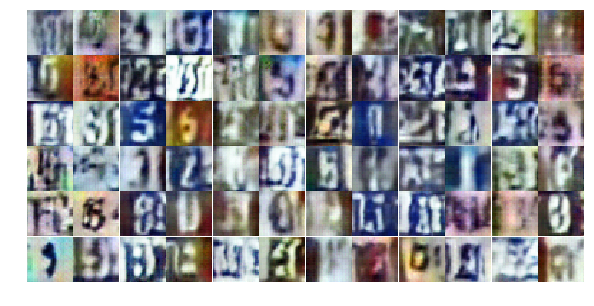

Epoch 8/25... Discriminator Loss: 1.3792... Generator Loss: 0.7092
Epoch 8/25... Discriminator Loss: 1.3851... Generator Loss: 0.6867
Epoch 8/25... Discriminator Loss: 1.3813... Generator Loss: 0.6910
Epoch 8/25... Discriminator Loss: 1.3738... Generator Loss: 0.7045
Epoch 8/25... Discriminator Loss: 1.3838... Generator Loss: 0.6772
Epoch 8/25... Discriminator Loss: 1.3685... Generator Loss: 0.6977
Epoch 8/25... Discriminator Loss: 1.3667... Generator Loss: 0.6845
Epoch 8/25... Discriminator Loss: 1.3888... Generator Loss: 0.7147
Epoch 8/25... Discriminator Loss: 1.3970... Generator Loss: 0.6862
Epoch 8/25... Discriminator Loss: 1.3906... Generator Loss: 0.7013
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


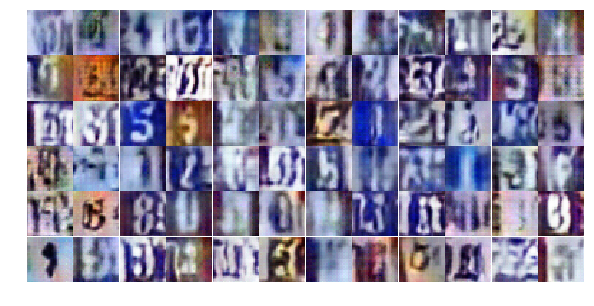

Epoch 8/25... Discriminator Loss: 1.3921... Generator Loss: 0.6959
Epoch 8/25... Discriminator Loss: 1.3813... Generator Loss: 0.6985
Epoch 8/25... Discriminator Loss: 1.3964... Generator Loss: 0.7011
Epoch 8/25... Discriminator Loss: 1.3900... Generator Loss: 0.7222
Epoch 8/25... Discriminator Loss: 1.3854... Generator Loss: 0.6784
Epoch 8/25... Discriminator Loss: 1.3844... Generator Loss: 0.6820
Epoch 8/25... Discriminator Loss: 1.3793... Generator Loss: 0.7127
Epoch 8/25... Discriminator Loss: 1.3886... Generator Loss: 0.6843
Epoch 9/25... Discriminator Loss: 1.4084... Generator Loss: 0.6688
Epoch 9/25... Discriminator Loss: 1.3766... Generator Loss: 0.7040
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


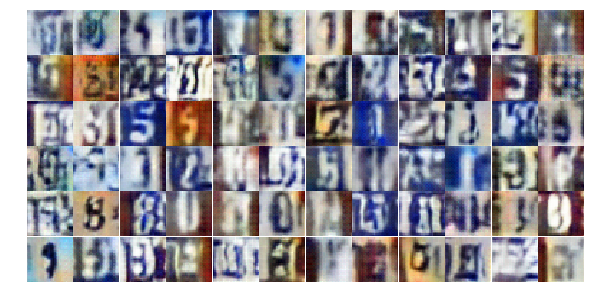

Epoch 9/25... Discriminator Loss: 1.3881... Generator Loss: 0.6691
Epoch 9/25... Discriminator Loss: 1.3902... Generator Loss: 0.6923
Epoch 9/25... Discriminator Loss: 1.3949... Generator Loss: 0.6859
Epoch 9/25... Discriminator Loss: 1.3783... Generator Loss: 0.7173
Epoch 9/25... Discriminator Loss: 1.3814... Generator Loss: 0.6969
Epoch 9/25... Discriminator Loss: 1.3865... Generator Loss: 0.6975
Epoch 9/25... Discriminator Loss: 1.3889... Generator Loss: 0.7175
Epoch 9/25... Discriminator Loss: 1.3858... Generator Loss: 0.6980
Epoch 9/25... Discriminator Loss: 1.3813... Generator Loss: 0.6946
Epoch 9/25... Discriminator Loss: 1.3824... Generator Loss: 0.7070
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


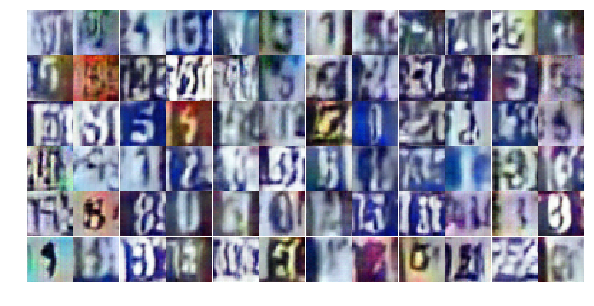

Epoch 9/25... Discriminator Loss: 1.3831... Generator Loss: 0.6873
Epoch 9/25... Discriminator Loss: 1.3851... Generator Loss: 0.6986
Epoch 9/25... Discriminator Loss: 1.3913... Generator Loss: 0.6869
Epoch 9/25... Discriminator Loss: 1.3876... Generator Loss: 0.6989
Epoch 9/25... Discriminator Loss: 1.3919... Generator Loss: 0.6866
Epoch 9/25... Discriminator Loss: 1.3803... Generator Loss: 0.6942
Epoch 9/25... Discriminator Loss: 1.4019... Generator Loss: 0.6796
Epoch 9/25... Discriminator Loss: 1.3902... Generator Loss: 0.6959
Epoch 9/25... Discriminator Loss: 1.3787... Generator Loss: 0.7067
Epoch 9/25... Discriminator Loss: 1.3891... Generator Loss: 0.7015
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


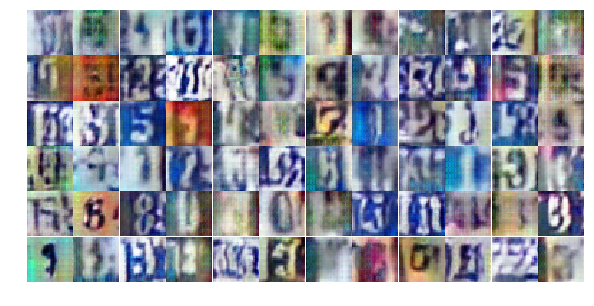

Epoch 9/25... Discriminator Loss: 1.3823... Generator Loss: 0.6977
Epoch 9/25... Discriminator Loss: 1.3816... Generator Loss: 0.6969
Epoch 9/25... Discriminator Loss: 1.3789... Generator Loss: 0.6992
Epoch 9/25... Discriminator Loss: 1.3860... Generator Loss: 0.6955
Epoch 9/25... Discriminator Loss: 1.3808... Generator Loss: 0.7120
Epoch 9/25... Discriminator Loss: 1.3852... Generator Loss: 0.6990
Epoch 9/25... Discriminator Loss: 1.3881... Generator Loss: 0.6948
Epoch 9/25... Discriminator Loss: 1.3780... Generator Loss: 0.6845
Epoch 9/25... Discriminator Loss: 1.3877... Generator Loss: 0.6974
Epoch 9/25... Discriminator Loss: 1.3850... Generator Loss: 0.6947
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


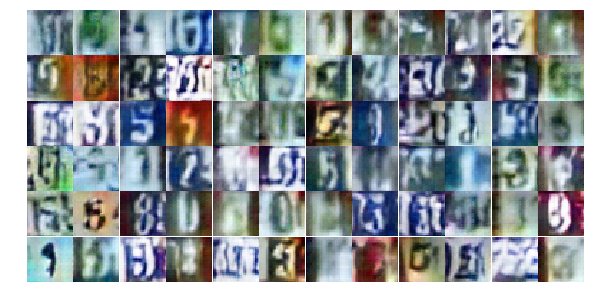

Epoch 9/25... Discriminator Loss: 1.3834... Generator Loss: 0.7066
Epoch 9/25... Discriminator Loss: 1.3909... Generator Loss: 0.6728
Epoch 9/25... Discriminator Loss: 1.3851... Generator Loss: 0.6942
Epoch 9/25... Discriminator Loss: 1.3745... Generator Loss: 0.6805
Epoch 9/25... Discriminator Loss: 1.3856... Generator Loss: 0.6930
Epoch 9/25... Discriminator Loss: 1.3830... Generator Loss: 0.7031
Epoch 9/25... Discriminator Loss: 1.3939... Generator Loss: 0.6673
Epoch 9/25... Discriminator Loss: 1.3778... Generator Loss: 0.7001
Epoch 9/25... Discriminator Loss: 1.4019... Generator Loss: 0.6886
Epoch 9/25... Discriminator Loss: 1.3889... Generator Loss: 0.6788
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


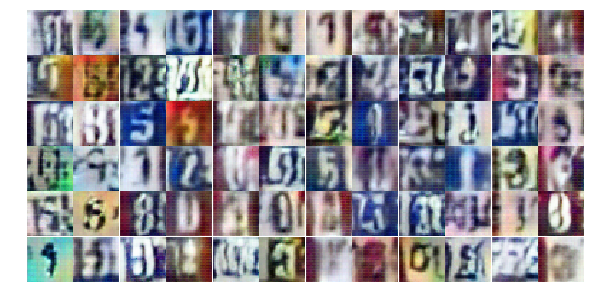

Epoch 9/25... Discriminator Loss: 1.3773... Generator Loss: 0.7122
Epoch 9/25... Discriminator Loss: 1.3900... Generator Loss: 0.6787
Epoch 9/25... Discriminator Loss: 1.3855... Generator Loss: 0.7205
Epoch 9/25... Discriminator Loss: 1.3863... Generator Loss: 0.7019
Epoch 9/25... Discriminator Loss: 1.3932... Generator Loss: 0.7137
Epoch 9/25... Discriminator Loss: 1.3810... Generator Loss: 0.7060
Epoch 9/25... Discriminator Loss: 1.3822... Generator Loss: 0.7100
Epoch 9/25... Discriminator Loss: 1.3816... Generator Loss: 0.6785
Epoch 9/25... Discriminator Loss: 1.3987... Generator Loss: 0.6757
Epoch 9/25... Discriminator Loss: 1.3791... Generator Loss: 0.6950
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


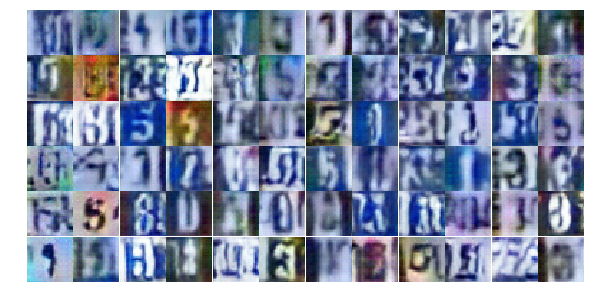

Epoch 9/25... Discriminator Loss: 1.3779... Generator Loss: 0.6695
Epoch 9/25... Discriminator Loss: 1.3778... Generator Loss: 0.7158
Epoch 9/25... Discriminator Loss: 1.3762... Generator Loss: 0.6779
Epoch 9/25... Discriminator Loss: 1.3810... Generator Loss: 0.7047
Epoch 9/25... Discriminator Loss: 1.3838... Generator Loss: 0.6919
Epoch 10/25... Discriminator Loss: 1.4135... Generator Loss: 0.6734
Epoch 10/25... Discriminator Loss: 1.3813... Generator Loss: 0.6963
Epoch 10/25... Discriminator Loss: 1.3939... Generator Loss: 0.6782
Epoch 10/25... Discriminator Loss: 1.3821... Generator Loss: 0.7258
Epoch 10/25... Discriminator Loss: 1.4337... Generator Loss: 0.6785
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


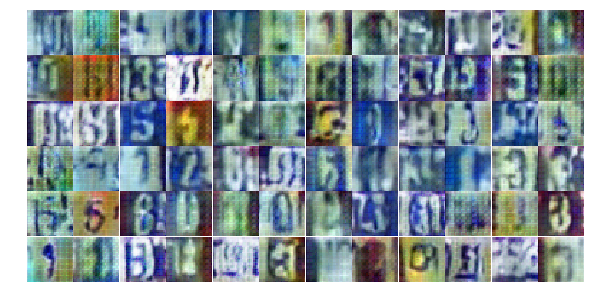

Epoch 10/25... Discriminator Loss: 1.3938... Generator Loss: 0.6763
Epoch 10/25... Discriminator Loss: 1.3812... Generator Loss: 0.6806
Epoch 10/25... Discriminator Loss: 1.3821... Generator Loss: 0.7485
Epoch 10/25... Discriminator Loss: 1.3862... Generator Loss: 0.7028
Epoch 10/25... Discriminator Loss: 1.3904... Generator Loss: 0.6824
Epoch 10/25... Discriminator Loss: 1.3936... Generator Loss: 0.6911
Epoch 10/25... Discriminator Loss: 1.3831... Generator Loss: 0.6779
Epoch 10/25... Discriminator Loss: 1.3900... Generator Loss: 0.7208
Epoch 10/25... Discriminator Loss: 1.3943... Generator Loss: 0.7173
Epoch 10/25... Discriminator Loss: 1.3831... Generator Loss: 0.6836
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


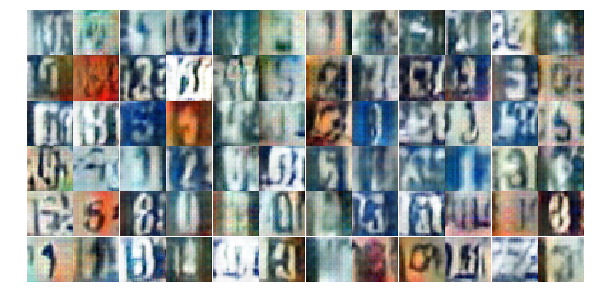

Epoch 10/25... Discriminator Loss: 1.3767... Generator Loss: 0.7062
Epoch 10/25... Discriminator Loss: 1.3847... Generator Loss: 0.6884
Epoch 10/25... Discriminator Loss: 1.3853... Generator Loss: 0.6948
Epoch 10/25... Discriminator Loss: 1.3830... Generator Loss: 0.6860
Epoch 10/25... Discriminator Loss: 1.3857... Generator Loss: 0.7040
Epoch 10/25... Discriminator Loss: 1.3874... Generator Loss: 0.6966
Epoch 10/25... Discriminator Loss: 1.3898... Generator Loss: 0.6888
Epoch 10/25... Discriminator Loss: 1.3884... Generator Loss: 0.7107
Epoch 10/25... Discriminator Loss: 1.3819... Generator Loss: 0.6921
Epoch 10/25... Discriminator Loss: 1.3873... Generator Loss: 0.6911
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


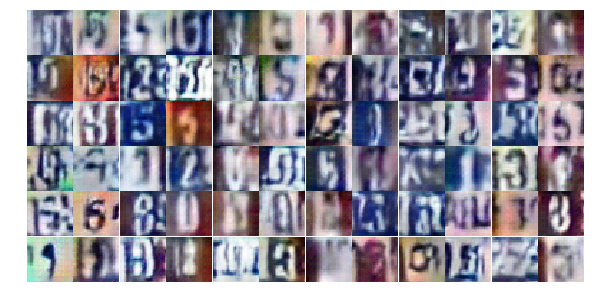

Epoch 10/25... Discriminator Loss: 1.3893... Generator Loss: 0.6737
Epoch 10/25... Discriminator Loss: 1.3872... Generator Loss: 0.6902
Epoch 10/25... Discriminator Loss: 1.3826... Generator Loss: 0.7013
Epoch 10/25... Discriminator Loss: 1.3740... Generator Loss: 0.6945
Epoch 10/25... Discriminator Loss: 1.3742... Generator Loss: 0.7037
Epoch 10/25... Discriminator Loss: 1.3792... Generator Loss: 0.6859
Epoch 10/25... Discriminator Loss: 1.3616... Generator Loss: 0.6776
Epoch 10/25... Discriminator Loss: 1.3640... Generator Loss: 0.7147
Epoch 10/25... Discriminator Loss: 1.3955... Generator Loss: 0.6847
Epoch 10/25... Discriminator Loss: 1.3917... Generator Loss: 0.6983
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


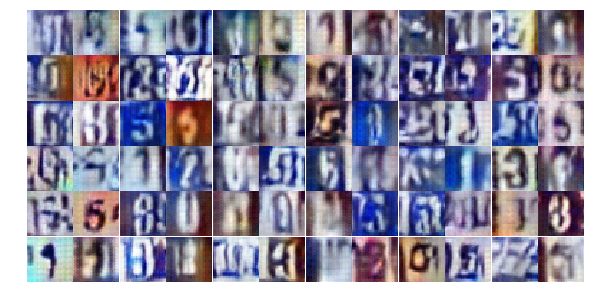

Epoch 10/25... Discriminator Loss: 1.3816... Generator Loss: 0.6975
Epoch 10/25... Discriminator Loss: 1.3839... Generator Loss: 0.7152
Epoch 10/25... Discriminator Loss: 1.4043... Generator Loss: 0.6773
Epoch 10/25... Discriminator Loss: 1.3841... Generator Loss: 0.7090
Epoch 10/25... Discriminator Loss: 1.3851... Generator Loss: 0.7017
Epoch 10/25... Discriminator Loss: 1.3816... Generator Loss: 0.6990
Epoch 10/25... Discriminator Loss: 1.4027... Generator Loss: 0.6833
Epoch 10/25... Discriminator Loss: 1.3967... Generator Loss: 0.6668
Epoch 10/25... Discriminator Loss: 1.3704... Generator Loss: 0.7027
Epoch 10/25... Discriminator Loss: 1.3850... Generator Loss: 0.6832
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


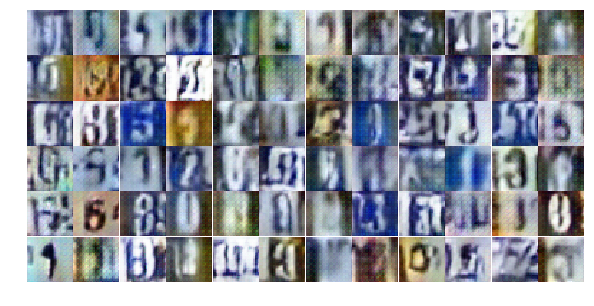

Epoch 10/25... Discriminator Loss: 1.3926... Generator Loss: 0.6970
Epoch 10/25... Discriminator Loss: 1.3843... Generator Loss: 0.7013
Epoch 10/25... Discriminator Loss: 1.3836... Generator Loss: 0.6910
Epoch 10/25... Discriminator Loss: 1.3893... Generator Loss: 0.6867
Epoch 10/25... Discriminator Loss: 1.3808... Generator Loss: 0.7038
Epoch 10/25... Discriminator Loss: 1.3921... Generator Loss: 0.6668
Epoch 10/25... Discriminator Loss: 1.3800... Generator Loss: 0.6956
Epoch 10/25... Discriminator Loss: 1.3821... Generator Loss: 0.7044
Epoch 10/25... Discriminator Loss: 1.3819... Generator Loss: 0.7138
Epoch 10/25... Discriminator Loss: 1.3788... Generator Loss: 0.6885
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


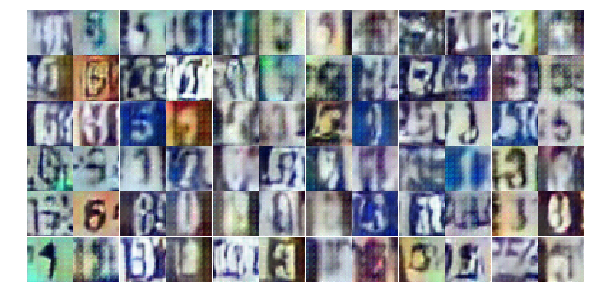

Epoch 10/25... Discriminator Loss: 1.3820... Generator Loss: 0.7133
Epoch 10/25... Discriminator Loss: 1.3934... Generator Loss: 0.6959
Epoch 10/25... Discriminator Loss: 1.3460... Generator Loss: 0.6656
Epoch 11/25... Discriminator Loss: 1.3793... Generator Loss: 0.7456
Epoch 11/25... Discriminator Loss: 1.3950... Generator Loss: 0.6770
Epoch 11/25... Discriminator Loss: 1.3972... Generator Loss: 0.6962
Epoch 11/25... Discriminator Loss: 1.3851... Generator Loss: 0.7231
Epoch 11/25... Discriminator Loss: 1.3964... Generator Loss: 0.7011
Epoch 11/25... Discriminator Loss: 1.3863... Generator Loss: 0.6828
Epoch 11/25... Discriminator Loss: 1.3754... Generator Loss: 0.6793
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


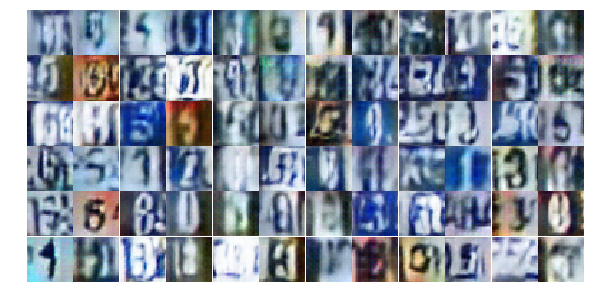

Epoch 11/25... Discriminator Loss: 1.3810... Generator Loss: 0.6951
Epoch 11/25... Discriminator Loss: 1.3890... Generator Loss: 0.7040
Epoch 11/25... Discriminator Loss: 1.3844... Generator Loss: 0.6906
Epoch 11/25... Discriminator Loss: 1.3817... Generator Loss: 0.7039
Epoch 11/25... Discriminator Loss: 1.3785... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 1.3875... Generator Loss: 0.6968
Epoch 11/25... Discriminator Loss: 1.3841... Generator Loss: 0.6994
Epoch 11/25... Discriminator Loss: 1.3822... Generator Loss: 0.6899
Epoch 11/25... Discriminator Loss: 1.3860... Generator Loss: 0.6981
Epoch 11/25... Discriminator Loss: 1.3853... Generator Loss: 0.6924
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


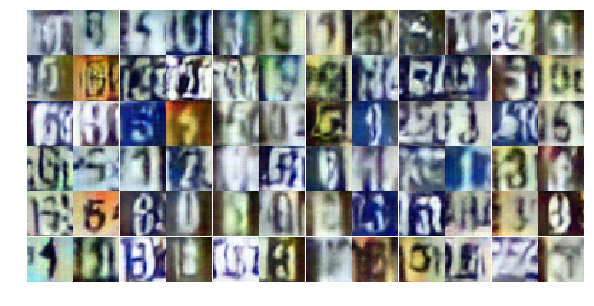

Epoch 11/25... Discriminator Loss: 1.3993... Generator Loss: 0.6631
Epoch 11/25... Discriminator Loss: 1.3788... Generator Loss: 0.7030
Epoch 11/25... Discriminator Loss: 1.3846... Generator Loss: 0.6900
Epoch 11/25... Discriminator Loss: 1.3855... Generator Loss: 0.7024
Epoch 11/25... Discriminator Loss: 1.3779... Generator Loss: 0.6909
Epoch 11/25... Discriminator Loss: 1.3799... Generator Loss: 0.6985
Epoch 11/25... Discriminator Loss: 1.3837... Generator Loss: 0.7057
Epoch 11/25... Discriminator Loss: 1.3841... Generator Loss: 0.6947
Epoch 11/25... Discriminator Loss: 1.3824... Generator Loss: 0.6869
Epoch 11/25... Discriminator Loss: 1.3882... Generator Loss: 0.7011
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


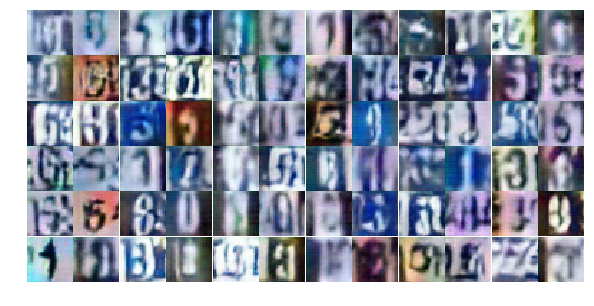

Epoch 11/25... Discriminator Loss: 1.3838... Generator Loss: 0.6968
Epoch 11/25... Discriminator Loss: 1.3812... Generator Loss: 0.6982
Epoch 11/25... Discriminator Loss: 1.3945... Generator Loss: 0.6714
Epoch 11/25... Discriminator Loss: 1.3862... Generator Loss: 0.7118
Epoch 11/25... Discriminator Loss: 1.3870... Generator Loss: 0.6811
Epoch 11/25... Discriminator Loss: 1.3894... Generator Loss: 0.6909
Epoch 11/25... Discriminator Loss: 1.3804... Generator Loss: 0.6748
Epoch 11/25... Discriminator Loss: 1.3880... Generator Loss: 0.7111
Epoch 11/25... Discriminator Loss: 1.3850... Generator Loss: 0.6918
Epoch 11/25... Discriminator Loss: 1.3871... Generator Loss: 0.6902
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


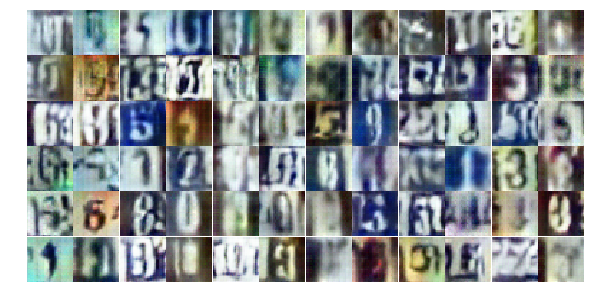

Epoch 11/25... Discriminator Loss: 1.3800... Generator Loss: 0.6970
Epoch 11/25... Discriminator Loss: 1.3871... Generator Loss: 0.6933
Epoch 11/25... Discriminator Loss: 1.3907... Generator Loss: 0.7168
Epoch 11/25... Discriminator Loss: 1.3861... Generator Loss: 0.6956
Epoch 11/25... Discriminator Loss: 1.3842... Generator Loss: 0.7060
Epoch 11/25... Discriminator Loss: 1.3833... Generator Loss: 0.7048
Epoch 11/25... Discriminator Loss: 1.3795... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 1.3892... Generator Loss: 0.6941
Epoch 11/25... Discriminator Loss: 1.3826... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 1.3822... Generator Loss: 0.7001
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


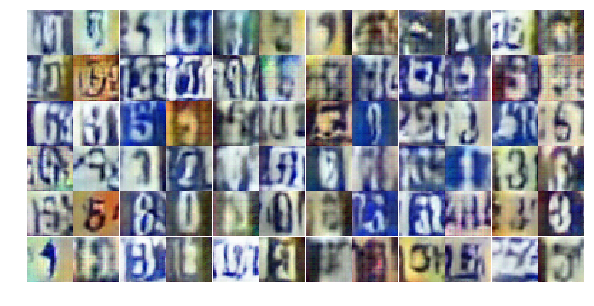

Epoch 11/25... Discriminator Loss: 1.3845... Generator Loss: 0.6967
Epoch 11/25... Discriminator Loss: 1.3812... Generator Loss: 0.6947
Epoch 11/25... Discriminator Loss: 1.3836... Generator Loss: 0.6910
Epoch 11/25... Discriminator Loss: 1.3798... Generator Loss: 0.6983
Epoch 11/25... Discriminator Loss: 1.3860... Generator Loss: 0.6946
Epoch 11/25... Discriminator Loss: 1.3871... Generator Loss: 0.7101
Epoch 11/25... Discriminator Loss: 1.3820... Generator Loss: 0.6976
Epoch 11/25... Discriminator Loss: 1.3872... Generator Loss: 0.6879
Epoch 11/25... Discriminator Loss: 1.3858... Generator Loss: 0.7001
Epoch 11/25... Discriminator Loss: 1.3802... Generator Loss: 0.6978
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


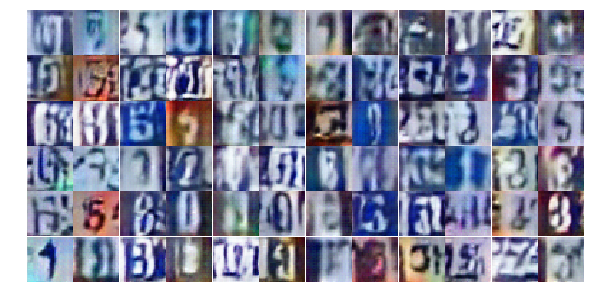

Epoch 12/25... Discriminator Loss: 1.3909... Generator Loss: 0.7119
Epoch 12/25... Discriminator Loss: 1.3900... Generator Loss: 0.6824
Epoch 12/25... Discriminator Loss: 1.3808... Generator Loss: 0.6907
Epoch 12/25... Discriminator Loss: 1.3979... Generator Loss: 0.6854
Epoch 12/25... Discriminator Loss: 1.3847... Generator Loss: 0.6941
Epoch 12/25... Discriminator Loss: 1.3780... Generator Loss: 0.6994
Epoch 12/25... Discriminator Loss: 1.3753... Generator Loss: 0.6853
Epoch 12/25... Discriminator Loss: 1.3909... Generator Loss: 0.6912
Epoch 12/25... Discriminator Loss: 1.3850... Generator Loss: 0.7101
Epoch 12/25... Discriminator Loss: 1.3918... Generator Loss: 0.7020
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


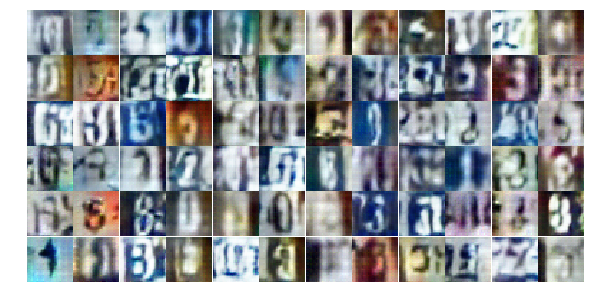

Epoch 12/25... Discriminator Loss: 1.3960... Generator Loss: 0.6951
Epoch 12/25... Discriminator Loss: 1.3810... Generator Loss: 0.6818
Epoch 12/25... Discriminator Loss: 1.3864... Generator Loss: 0.6873
Epoch 12/25... Discriminator Loss: 1.3915... Generator Loss: 0.7084
Epoch 12/25... Discriminator Loss: 1.3912... Generator Loss: 0.6884
Epoch 12/25... Discriminator Loss: 1.3831... Generator Loss: 0.6738
Epoch 12/25... Discriminator Loss: 1.3802... Generator Loss: 0.7061
Epoch 12/25... Discriminator Loss: 1.3878... Generator Loss: 0.6905
Epoch 12/25... Discriminator Loss: 1.3973... Generator Loss: 0.6693
Epoch 12/25... Discriminator Loss: 1.3915... Generator Loss: 0.7036
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


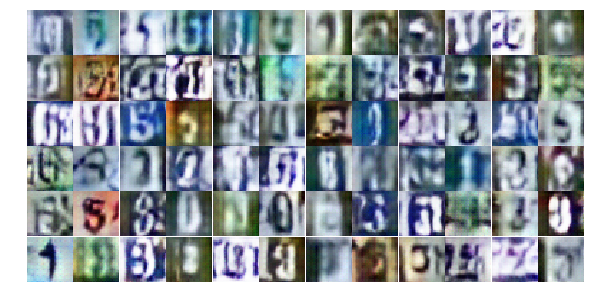

Epoch 12/25... Discriminator Loss: 1.3791... Generator Loss: 0.6740
Epoch 12/25... Discriminator Loss: 1.3843... Generator Loss: 0.7023
Epoch 12/25... Discriminator Loss: 1.3852... Generator Loss: 0.6952
Epoch 12/25... Discriminator Loss: 1.3793... Generator Loss: 0.6959
Epoch 12/25... Discriminator Loss: 1.3849... Generator Loss: 0.6955
Epoch 12/25... Discriminator Loss: 1.3808... Generator Loss: 0.6949
Epoch 12/25... Discriminator Loss: 1.3814... Generator Loss: 0.6895
Epoch 12/25... Discriminator Loss: 1.3802... Generator Loss: 0.6976
Epoch 12/25... Discriminator Loss: 1.3898... Generator Loss: 0.6958
Epoch 12/25... Discriminator Loss: 1.3724... Generator Loss: 0.6885
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


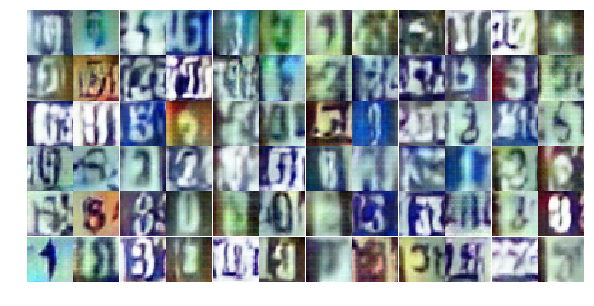

Epoch 12/25... Discriminator Loss: 1.3855... Generator Loss: 0.7024
Epoch 12/25... Discriminator Loss: 1.3783... Generator Loss: 0.7121
Epoch 12/25... Discriminator Loss: 1.3758... Generator Loss: 0.7029
Epoch 12/25... Discriminator Loss: 1.3963... Generator Loss: 0.6850
Epoch 12/25... Discriminator Loss: 1.4024... Generator Loss: 0.7108
Epoch 12/25... Discriminator Loss: 1.3794... Generator Loss: 0.6746
Epoch 12/25... Discriminator Loss: 1.3844... Generator Loss: 0.7038
Epoch 12/25... Discriminator Loss: 1.3851... Generator Loss: 0.6939
Epoch 12/25... Discriminator Loss: 1.3806... Generator Loss: 0.7016
Epoch 12/25... Discriminator Loss: 1.3719... Generator Loss: 0.6868
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


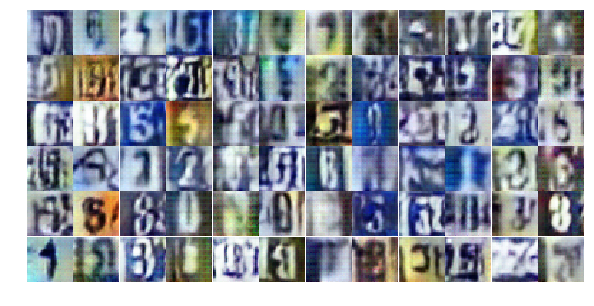

Epoch 12/25... Discriminator Loss: 1.3835... Generator Loss: 0.6989
Epoch 12/25... Discriminator Loss: 1.3847... Generator Loss: 0.7045
Epoch 12/25... Discriminator Loss: 1.3803... Generator Loss: 0.6978
Epoch 12/25... Discriminator Loss: 1.3838... Generator Loss: 0.6884
Epoch 12/25... Discriminator Loss: 1.3810... Generator Loss: 0.7161
Epoch 12/25... Discriminator Loss: 1.3844... Generator Loss: 0.7083
Epoch 12/25... Discriminator Loss: 1.3841... Generator Loss: 0.6918
Epoch 12/25... Discriminator Loss: 1.3943... Generator Loss: 0.6860
Epoch 12/25... Discriminator Loss: 1.3837... Generator Loss: 0.7122
Epoch 12/25... Discriminator Loss: 1.3813... Generator Loss: 0.7060
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


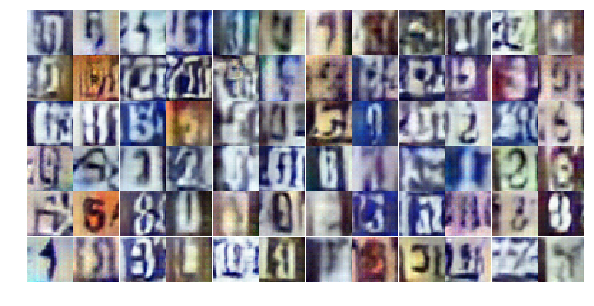

Epoch 12/25... Discriminator Loss: 1.3904... Generator Loss: 0.6742
Epoch 12/25... Discriminator Loss: 1.3729... Generator Loss: 0.6917
Epoch 12/25... Discriminator Loss: 1.3820... Generator Loss: 0.7447
Epoch 12/25... Discriminator Loss: 1.3903... Generator Loss: 0.6793
Epoch 12/25... Discriminator Loss: 1.3930... Generator Loss: 0.6743
Epoch 12/25... Discriminator Loss: 1.3882... Generator Loss: 0.7038
Epoch 12/25... Discriminator Loss: 1.3856... Generator Loss: 0.6919
Epoch 13/25... Discriminator Loss: 1.3602... Generator Loss: 0.6547
Epoch 13/25... Discriminator Loss: 1.3605... Generator Loss: 0.7524
Epoch 13/25... Discriminator Loss: 1.3785... Generator Loss: 0.6616
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


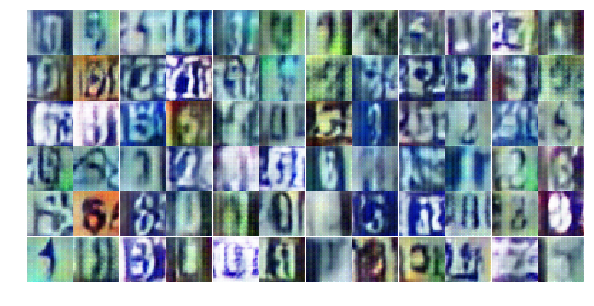

Epoch 13/25... Discriminator Loss: 1.3853... Generator Loss: 0.7092
Epoch 13/25... Discriminator Loss: 1.3910... Generator Loss: 0.6960
Epoch 13/25... Discriminator Loss: 1.3897... Generator Loss: 0.6922
Epoch 13/25... Discriminator Loss: 1.3903... Generator Loss: 0.6843
Epoch 13/25... Discriminator Loss: 1.3943... Generator Loss: 0.7121
Epoch 13/25... Discriminator Loss: 1.3842... Generator Loss: 0.6960
Epoch 13/25... Discriminator Loss: 1.3824... Generator Loss: 0.6771
Epoch 13/25... Discriminator Loss: 1.3929... Generator Loss: 0.6832
Epoch 13/25... Discriminator Loss: 1.3887... Generator Loss: 0.6948
Epoch 13/25... Discriminator Loss: 1.3822... Generator Loss: 0.7016
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


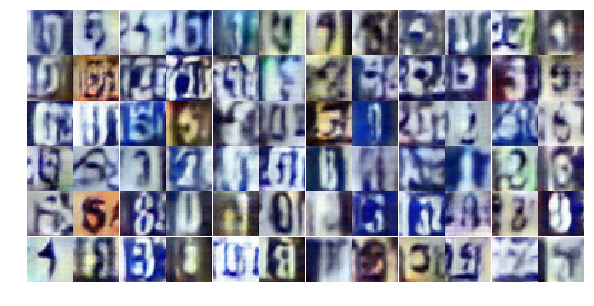

Epoch 13/25... Discriminator Loss: 1.3902... Generator Loss: 0.6997
Epoch 13/25... Discriminator Loss: 1.3910... Generator Loss: 0.6837
Epoch 13/25... Discriminator Loss: 1.3820... Generator Loss: 0.7022
Epoch 13/25... Discriminator Loss: 1.3843... Generator Loss: 0.7007
Epoch 13/25... Discriminator Loss: 1.3869... Generator Loss: 0.6868
Epoch 13/25... Discriminator Loss: 1.3840... Generator Loss: 0.7012
Epoch 13/25... Discriminator Loss: 1.3860... Generator Loss: 0.7004
Epoch 13/25... Discriminator Loss: 1.3835... Generator Loss: 0.6968
Epoch 13/25... Discriminator Loss: 1.3827... Generator Loss: 0.7024
Epoch 13/25... Discriminator Loss: 1.3776... Generator Loss: 0.6890
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


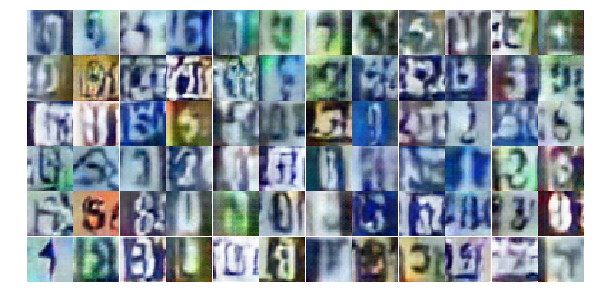

Epoch 13/25... Discriminator Loss: 1.3832... Generator Loss: 0.6903
Epoch 13/25... Discriminator Loss: 1.3707... Generator Loss: 0.7033
Epoch 13/25... Discriminator Loss: 1.3855... Generator Loss: 0.6941
Epoch 13/25... Discriminator Loss: 1.3991... Generator Loss: 0.6648
Epoch 13/25... Discriminator Loss: 1.3774... Generator Loss: 0.7102
Epoch 13/25... Discriminator Loss: 1.3930... Generator Loss: 0.6825
Epoch 13/25... Discriminator Loss: 1.3764... Generator Loss: 0.6893
Epoch 13/25... Discriminator Loss: 1.4016... Generator Loss: 0.6764
Epoch 13/25... Discriminator Loss: 1.3933... Generator Loss: 0.7014
Epoch 13/25... Discriminator Loss: 1.3894... Generator Loss: 0.6903
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


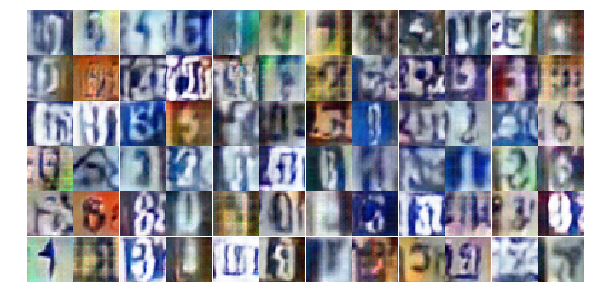

Epoch 13/25... Discriminator Loss: 1.3934... Generator Loss: 0.6889
Epoch 13/25... Discriminator Loss: 1.3800... Generator Loss: 0.7042
Epoch 13/25... Discriminator Loss: 1.3874... Generator Loss: 0.6881
Epoch 13/25... Discriminator Loss: 1.3851... Generator Loss: 0.6903
Epoch 13/25... Discriminator Loss: 1.3917... Generator Loss: 0.6890
Epoch 13/25... Discriminator Loss: 1.3820... Generator Loss: 0.6911
Epoch 13/25... Discriminator Loss: 1.3915... Generator Loss: 0.6944
Epoch 13/25... Discriminator Loss: 1.3823... Generator Loss: 0.6910
Epoch 13/25... Discriminator Loss: 1.3770... Generator Loss: 0.6788
Epoch 13/25... Discriminator Loss: 1.3967... Generator Loss: 0.6857
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


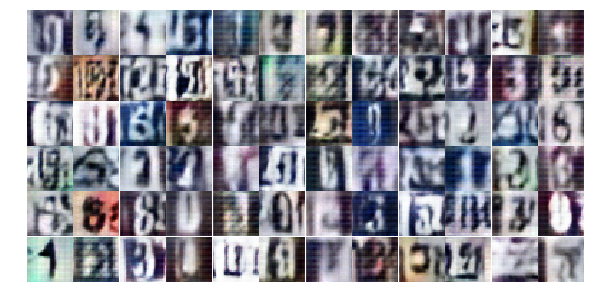

Epoch 13/25... Discriminator Loss: 1.3851... Generator Loss: 0.6994
Epoch 13/25... Discriminator Loss: 1.3811... Generator Loss: 0.7001
Epoch 13/25... Discriminator Loss: 1.3819... Generator Loss: 0.7051
Epoch 13/25... Discriminator Loss: 1.3861... Generator Loss: 0.6738
Epoch 13/25... Discriminator Loss: 1.3886... Generator Loss: 0.7039
Epoch 13/25... Discriminator Loss: 1.3852... Generator Loss: 0.6840
Epoch 13/25... Discriminator Loss: 1.3827... Generator Loss: 0.6939
Epoch 13/25... Discriminator Loss: 1.3765... Generator Loss: 0.6909
Epoch 13/25... Discriminator Loss: 1.3855... Generator Loss: 0.6984
Epoch 13/25... Discriminator Loss: 1.3809... Generator Loss: 0.6909
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


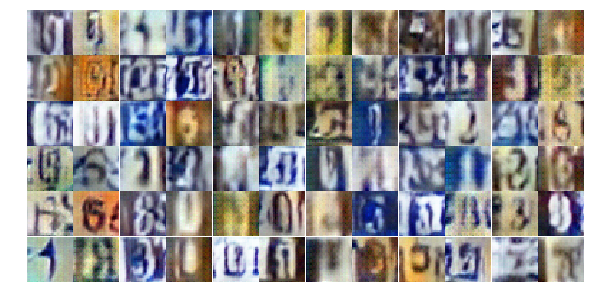

Epoch 13/25... Discriminator Loss: 1.3773... Generator Loss: 0.6996
Epoch 13/25... Discriminator Loss: 1.3780... Generator Loss: 0.6924
Epoch 13/25... Discriminator Loss: 1.3844... Generator Loss: 0.7025
Epoch 13/25... Discriminator Loss: 1.3863... Generator Loss: 0.7016
Epoch 14/25... Discriminator Loss: 1.3690... Generator Loss: 0.6738
Epoch 14/25... Discriminator Loss: 1.3892... Generator Loss: 0.6985
Epoch 14/25... Discriminator Loss: 1.3803... Generator Loss: 0.6770
Epoch 14/25... Discriminator Loss: 1.3952... Generator Loss: 0.7105
Epoch 14/25... Discriminator Loss: 1.3728... Generator Loss: 0.7214
Epoch 14/25... Discriminator Loss: 1.3883... Generator Loss: 0.6805
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


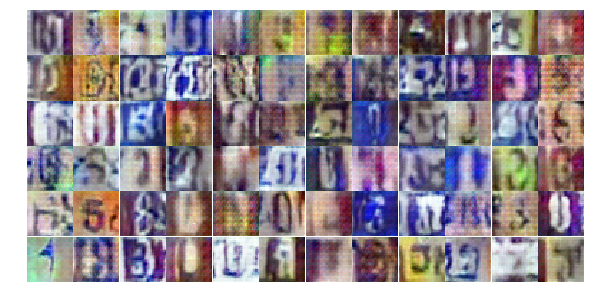

Epoch 14/25... Discriminator Loss: 1.3864... Generator Loss: 0.6733
Epoch 14/25... Discriminator Loss: 1.3897... Generator Loss: 0.6897
Epoch 14/25... Discriminator Loss: 1.3872... Generator Loss: 0.7071
Epoch 14/25... Discriminator Loss: 1.3875... Generator Loss: 0.6949
Epoch 14/25... Discriminator Loss: 1.3830... Generator Loss: 0.6914
Epoch 14/25... Discriminator Loss: 1.3872... Generator Loss: 0.6866
Epoch 14/25... Discriminator Loss: 1.3809... Generator Loss: 0.6867
Epoch 14/25... Discriminator Loss: 1.3828... Generator Loss: 0.7070
Epoch 14/25... Discriminator Loss: 1.3876... Generator Loss: 0.6914
Epoch 14/25... Discriminator Loss: 1.3919... Generator Loss: 0.6762
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


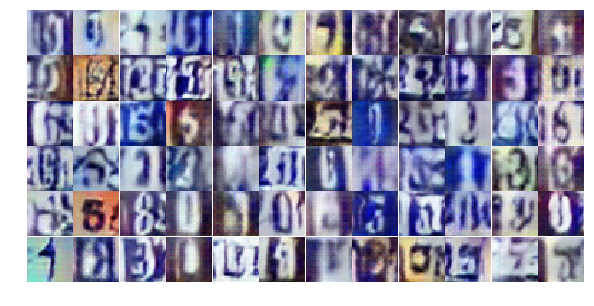

Epoch 14/25... Discriminator Loss: 1.3792... Generator Loss: 0.7137
Epoch 14/25... Discriminator Loss: 1.3873... Generator Loss: 0.6788
Epoch 14/25... Discriminator Loss: 1.3823... Generator Loss: 0.6830
Epoch 14/25... Discriminator Loss: 1.3936... Generator Loss: 0.6930
Epoch 14/25... Discriminator Loss: 1.3771... Generator Loss: 0.6829
Epoch 14/25... Discriminator Loss: 1.3836... Generator Loss: 0.6962
Epoch 14/25... Discriminator Loss: 1.3843... Generator Loss: 0.6971
Epoch 14/25... Discriminator Loss: 1.3832... Generator Loss: 0.6947
Epoch 14/25... Discriminator Loss: 1.3854... Generator Loss: 0.7012
Epoch 14/25... Discriminator Loss: 1.3824... Generator Loss: 0.6922
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


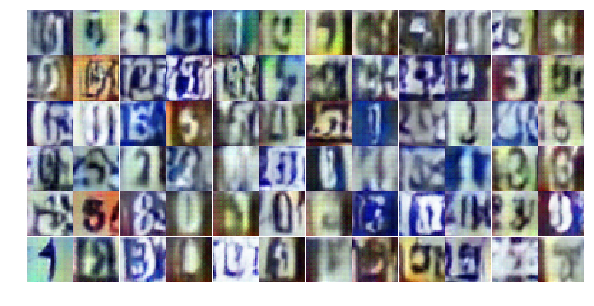

Epoch 14/25... Discriminator Loss: 1.3818... Generator Loss: 0.6869
Epoch 14/25... Discriminator Loss: 1.3809... Generator Loss: 0.6985
Epoch 14/25... Discriminator Loss: 1.3826... Generator Loss: 0.7212
Epoch 14/25... Discriminator Loss: 1.3840... Generator Loss: 0.6967
Epoch 14/25... Discriminator Loss: 1.3856... Generator Loss: 0.6714
Epoch 14/25... Discriminator Loss: 1.3824... Generator Loss: 0.6982
Epoch 14/25... Discriminator Loss: 1.3859... Generator Loss: 0.6986
Epoch 14/25... Discriminator Loss: 1.3957... Generator Loss: 0.6871
Epoch 14/25... Discriminator Loss: 1.3861... Generator Loss: 0.6942
Epoch 14/25... Discriminator Loss: 1.3865... Generator Loss: 0.6969
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


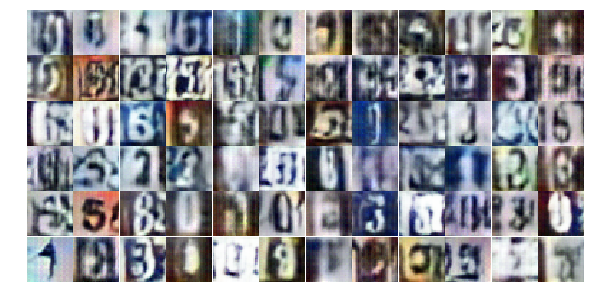

Epoch 14/25... Discriminator Loss: 1.3804... Generator Loss: 0.6911
Epoch 14/25... Discriminator Loss: 1.3908... Generator Loss: 0.6936
Epoch 14/25... Discriminator Loss: 1.3835... Generator Loss: 0.6998
Epoch 14/25... Discriminator Loss: 1.3787... Generator Loss: 0.6952
Epoch 14/25... Discriminator Loss: 1.3886... Generator Loss: 0.7013
Epoch 14/25... Discriminator Loss: 1.3963... Generator Loss: 0.6870
Epoch 14/25... Discriminator Loss: 1.3809... Generator Loss: 0.6963
Epoch 14/25... Discriminator Loss: 1.3816... Generator Loss: 0.6957
Epoch 14/25... Discriminator Loss: 1.3921... Generator Loss: 0.6651
Epoch 14/25... Discriminator Loss: 1.3885... Generator Loss: 0.7057
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


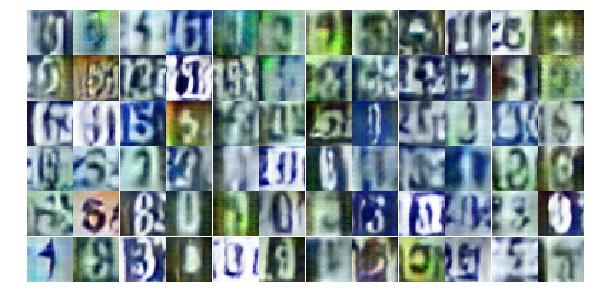

Epoch 14/25... Discriminator Loss: 1.3854... Generator Loss: 0.6921
Epoch 14/25... Discriminator Loss: 1.3794... Generator Loss: 0.6837
Epoch 14/25... Discriminator Loss: 1.3925... Generator Loss: 0.7031
Epoch 14/25... Discriminator Loss: 1.3790... Generator Loss: 0.6982
Epoch 14/25... Discriminator Loss: 1.3854... Generator Loss: 0.6956
Epoch 14/25... Discriminator Loss: 1.3829... Generator Loss: 0.6849
Epoch 14/25... Discriminator Loss: 1.3893... Generator Loss: 0.7028
Epoch 14/25... Discriminator Loss: 1.3855... Generator Loss: 0.7217
Epoch 14/25... Discriminator Loss: 1.3839... Generator Loss: 0.6901
Epoch 14/25... Discriminator Loss: 1.3852... Generator Loss: 0.6815
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


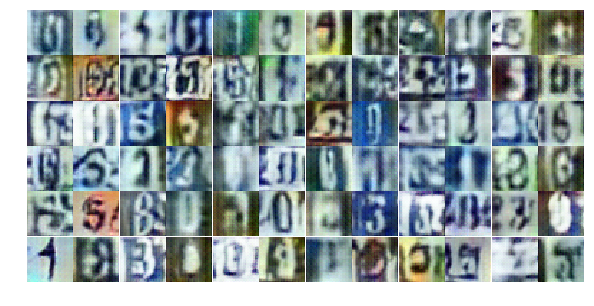

Epoch 14/25... Discriminator Loss: 1.3856... Generator Loss: 0.6924
Epoch 14/25... Discriminator Loss: 1.3832... Generator Loss: 0.6833
Epoch 15/25... Discriminator Loss: 1.3846... Generator Loss: 0.7158
Epoch 15/25... Discriminator Loss: 1.3916... Generator Loss: 0.6810
Epoch 15/25... Discriminator Loss: 1.4122... Generator Loss: 0.6904
Epoch 15/25... Discriminator Loss: 1.3721... Generator Loss: 0.7133
Epoch 15/25... Discriminator Loss: 1.3782... Generator Loss: 0.6897
Epoch 15/25... Discriminator Loss: 1.3778... Generator Loss: 0.6828
Epoch 15/25... Discriminator Loss: 1.3844... Generator Loss: 0.6880
Epoch 15/25... Discriminator Loss: 1.3784... Generator Loss: 0.7024
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


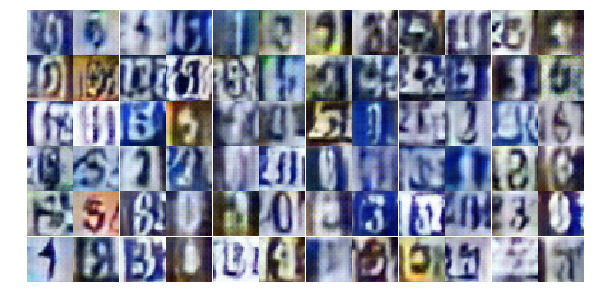

Epoch 15/25... Discriminator Loss: 1.3834... Generator Loss: 0.7152
Epoch 15/25... Discriminator Loss: 1.3842... Generator Loss: 0.6901
Epoch 15/25... Discriminator Loss: 1.3829... Generator Loss: 0.6986
Epoch 15/25... Discriminator Loss: 1.3849... Generator Loss: 0.7023
Epoch 15/25... Discriminator Loss: 1.3834... Generator Loss: 0.6853
Epoch 15/25... Discriminator Loss: 1.3834... Generator Loss: 0.6873
Epoch 15/25... Discriminator Loss: 1.3945... Generator Loss: 0.6931
Epoch 15/25... Discriminator Loss: 1.3816... Generator Loss: 0.7035
Epoch 15/25... Discriminator Loss: 1.3864... Generator Loss: 0.6864
Epoch 15/25... Discriminator Loss: 1.3882... Generator Loss: 0.6765
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


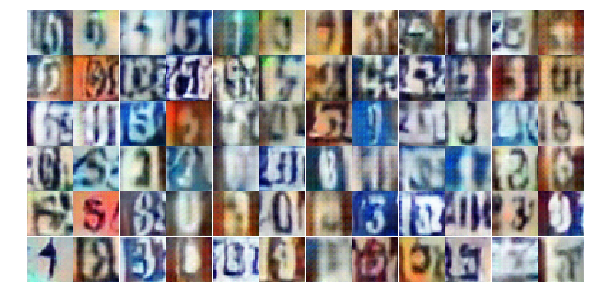

Epoch 15/25... Discriminator Loss: 1.3779... Generator Loss: 0.6863
Epoch 15/25... Discriminator Loss: 1.3922... Generator Loss: 0.7035
Epoch 15/25... Discriminator Loss: 1.3807... Generator Loss: 0.6946
Epoch 15/25... Discriminator Loss: 1.3859... Generator Loss: 0.6905
Epoch 15/25... Discriminator Loss: 1.3899... Generator Loss: 0.6908
Epoch 15/25... Discriminator Loss: 1.3805... Generator Loss: 0.7045
Epoch 15/25... Discriminator Loss: 1.3845... Generator Loss: 0.6955
Epoch 15/25... Discriminator Loss: 1.3854... Generator Loss: 0.6857
Epoch 15/25... Discriminator Loss: 1.3856... Generator Loss: 0.7010
Epoch 15/25... Discriminator Loss: 1.3817... Generator Loss: 0.6946
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


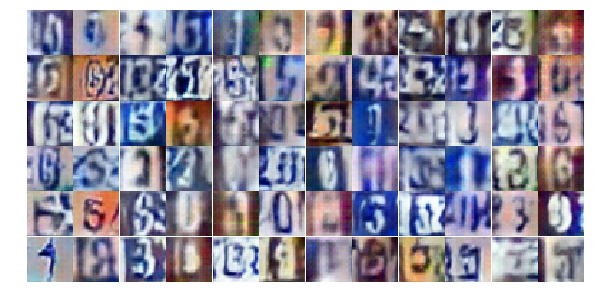

Epoch 15/25... Discriminator Loss: 1.3822... Generator Loss: 0.7094
Epoch 15/25... Discriminator Loss: 1.3920... Generator Loss: 0.6742
Epoch 15/25... Discriminator Loss: 1.3855... Generator Loss: 0.7114
Epoch 15/25... Discriminator Loss: 1.3924... Generator Loss: 0.6954
Epoch 15/25... Discriminator Loss: 1.3808... Generator Loss: 0.7089
Epoch 15/25... Discriminator Loss: 1.3859... Generator Loss: 0.6807
Epoch 15/25... Discriminator Loss: 1.3840... Generator Loss: 0.7138
Epoch 15/25... Discriminator Loss: 1.3876... Generator Loss: 0.6771
Epoch 15/25... Discriminator Loss: 1.3807... Generator Loss: 0.6878
Epoch 15/25... Discriminator Loss: 1.3800... Generator Loss: 0.7023
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


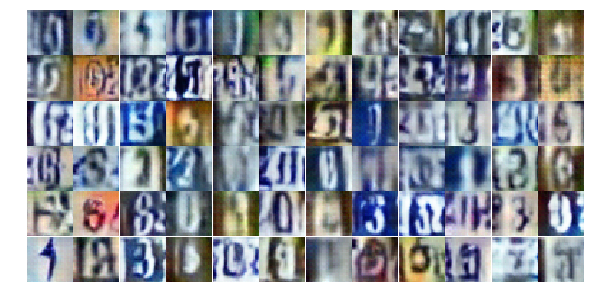

Epoch 15/25... Discriminator Loss: 1.3795... Generator Loss: 0.6836
Epoch 15/25... Discriminator Loss: 1.3852... Generator Loss: 0.7155
Epoch 15/25... Discriminator Loss: 1.3817... Generator Loss: 0.6837
Epoch 15/25... Discriminator Loss: 1.3708... Generator Loss: 0.6812
Epoch 15/25... Discriminator Loss: 1.3814... Generator Loss: 0.7096
Epoch 15/25... Discriminator Loss: 1.3750... Generator Loss: 0.6847
Epoch 15/25... Discriminator Loss: 1.3988... Generator Loss: 0.6742
Epoch 15/25... Discriminator Loss: 1.3820... Generator Loss: 0.7036
Epoch 15/25... Discriminator Loss: 1.3859... Generator Loss: 0.7003
Epoch 15/25... Discriminator Loss: 1.3888... Generator Loss: 0.6990
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


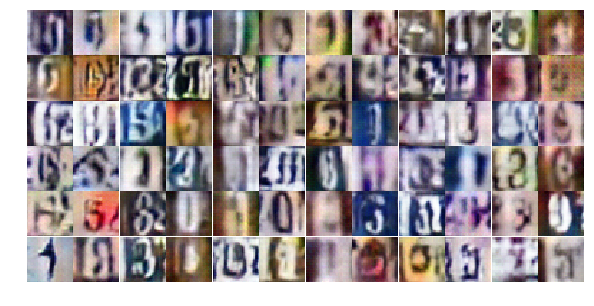

Epoch 15/25... Discriminator Loss: 1.3834... Generator Loss: 0.6999
Epoch 15/25... Discriminator Loss: 1.3869... Generator Loss: 0.6876
Epoch 15/25... Discriminator Loss: 1.3938... Generator Loss: 0.6934
Epoch 15/25... Discriminator Loss: 1.3916... Generator Loss: 0.6861
Epoch 15/25... Discriminator Loss: 1.3994... Generator Loss: 0.6828
Epoch 15/25... Discriminator Loss: 1.3852... Generator Loss: 0.6995
Epoch 15/25... Discriminator Loss: 1.3852... Generator Loss: 0.6769
Epoch 15/25... Discriminator Loss: 1.3789... Generator Loss: 0.7086
Epoch 15/25... Discriminator Loss: 1.3858... Generator Loss: 0.7020
Epoch 16/25... Discriminator Loss: 1.3996... Generator Loss: 0.6670
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


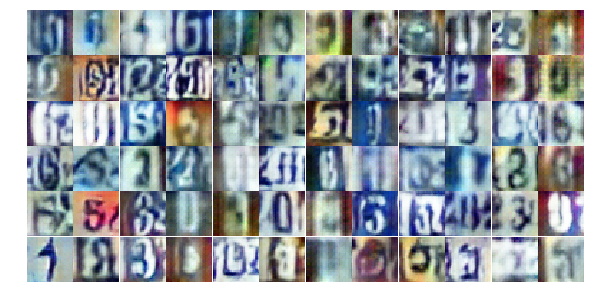

Epoch 16/25... Discriminator Loss: 1.3807... Generator Loss: 0.6988
Epoch 16/25... Discriminator Loss: 1.4053... Generator Loss: 0.6607
Epoch 16/25... Discriminator Loss: 1.3860... Generator Loss: 0.7122
Epoch 16/25... Discriminator Loss: 1.3929... Generator Loss: 0.6852
Epoch 16/25... Discriminator Loss: 1.3773... Generator Loss: 0.6894
Epoch 16/25... Discriminator Loss: 1.3834... Generator Loss: 0.6857
Epoch 16/25... Discriminator Loss: 1.3818... Generator Loss: 0.7143
Epoch 16/25... Discriminator Loss: 1.3886... Generator Loss: 0.6911
Epoch 16/25... Discriminator Loss: 1.3834... Generator Loss: 0.6964
Epoch 16/25... Discriminator Loss: 1.3871... Generator Loss: 0.7011
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


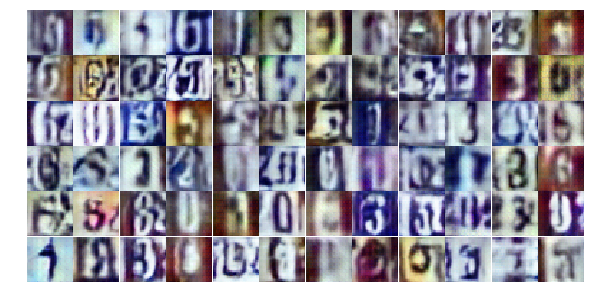

Epoch 16/25... Discriminator Loss: 1.3834... Generator Loss: 0.6939
Epoch 16/25... Discriminator Loss: 1.3710... Generator Loss: 0.6860
Epoch 16/25... Discriminator Loss: 1.3831... Generator Loss: 0.7150
Epoch 16/25... Discriminator Loss: 1.3842... Generator Loss: 0.6912
Epoch 16/25... Discriminator Loss: 1.3904... Generator Loss: 0.6977
Epoch 16/25... Discriminator Loss: 1.3909... Generator Loss: 0.7047
Epoch 16/25... Discriminator Loss: 1.3643... Generator Loss: 0.6960
Epoch 16/25... Discriminator Loss: 1.3693... Generator Loss: 0.7145
Epoch 16/25... Discriminator Loss: 1.3756... Generator Loss: 0.7212
Epoch 16/25... Discriminator Loss: 1.3810... Generator Loss: 0.6952
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


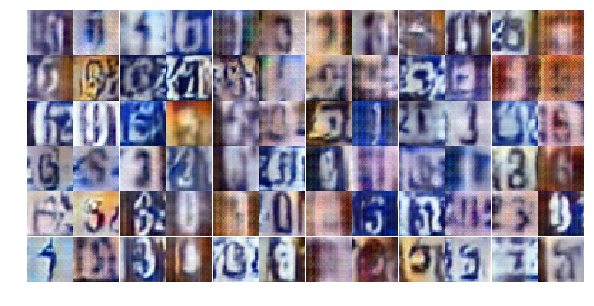

Epoch 16/25... Discriminator Loss: 1.3911... Generator Loss: 0.6932
Epoch 16/25... Discriminator Loss: 1.3828... Generator Loss: 0.6896
Epoch 16/25... Discriminator Loss: 1.3903... Generator Loss: 0.6911
Epoch 16/25... Discriminator Loss: 1.3867... Generator Loss: 0.6952
Epoch 16/25... Discriminator Loss: 1.3814... Generator Loss: 0.6924
Epoch 16/25... Discriminator Loss: 1.3901... Generator Loss: 0.7065
Epoch 16/25... Discriminator Loss: 1.3839... Generator Loss: 0.6868
Epoch 16/25... Discriminator Loss: 1.3806... Generator Loss: 0.6903
Epoch 16/25... Discriminator Loss: 1.3855... Generator Loss: 0.6945
Epoch 16/25... Discriminator Loss: 1.3839... Generator Loss: 0.7058
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


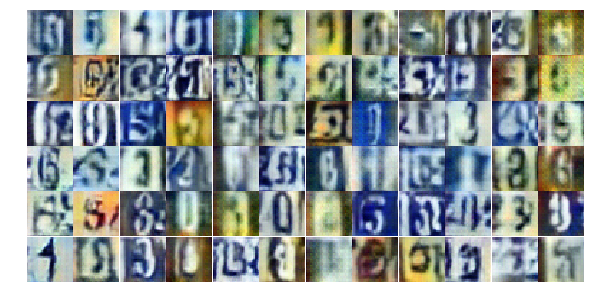

Epoch 16/25... Discriminator Loss: 1.3865... Generator Loss: 0.6731
Epoch 16/25... Discriminator Loss: 1.3790... Generator Loss: 0.7214
Epoch 16/25... Discriminator Loss: 1.3825... Generator Loss: 0.6794
Epoch 16/25... Discriminator Loss: 1.3906... Generator Loss: 0.6933
Epoch 16/25... Discriminator Loss: 1.3854... Generator Loss: 0.6663
Epoch 16/25... Discriminator Loss: 1.3794... Generator Loss: 0.6945
Epoch 16/25... Discriminator Loss: 1.3752... Generator Loss: 0.6924
Epoch 16/25... Discriminator Loss: 1.3877... Generator Loss: 0.7054
Epoch 16/25... Discriminator Loss: 1.3838... Generator Loss: 0.7031
Epoch 16/25... Discriminator Loss: 1.3835... Generator Loss: 0.6949
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


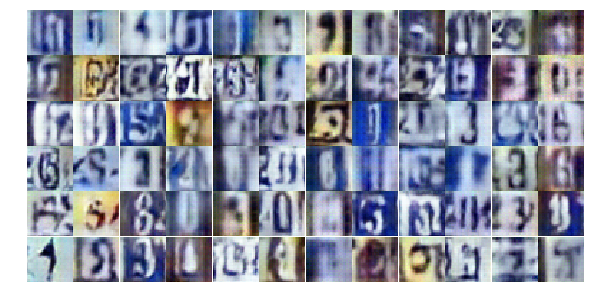

Epoch 16/25... Discriminator Loss: 1.4149... Generator Loss: 0.6613
Epoch 16/25... Discriminator Loss: 1.3828... Generator Loss: 0.6959
Epoch 16/25... Discriminator Loss: 1.3789... Generator Loss: 0.7238
Epoch 16/25... Discriminator Loss: 1.3834... Generator Loss: 0.6776
Epoch 16/25... Discriminator Loss: 1.3876... Generator Loss: 0.6989
Epoch 16/25... Discriminator Loss: 1.3852... Generator Loss: 0.6984
Epoch 16/25... Discriminator Loss: 1.3873... Generator Loss: 0.6864
Epoch 16/25... Discriminator Loss: 1.3851... Generator Loss: 0.6909
Epoch 16/25... Discriminator Loss: 1.3706... Generator Loss: 0.7203
Epoch 16/25... Discriminator Loss: 1.3771... Generator Loss: 0.6762
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


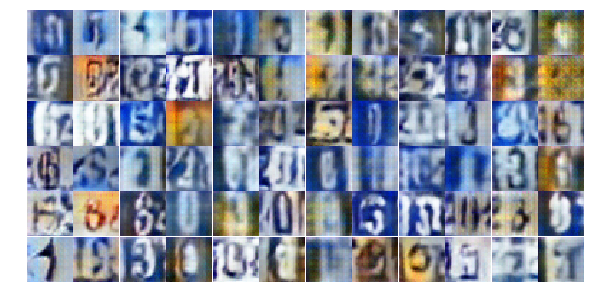

Epoch 16/25... Discriminator Loss: 1.4016... Generator Loss: 0.6989
Epoch 16/25... Discriminator Loss: 1.3845... Generator Loss: 0.7151
Epoch 16/25... Discriminator Loss: 1.4063... Generator Loss: 0.6685
Epoch 16/25... Discriminator Loss: 1.3854... Generator Loss: 0.6838
Epoch 16/25... Discriminator Loss: 1.3896... Generator Loss: 0.7053
Epoch 16/25... Discriminator Loss: 1.3997... Generator Loss: 0.6848
Epoch 17/25... Discriminator Loss: 1.3862... Generator Loss: 0.6908
Epoch 17/25... Discriminator Loss: 1.3808... Generator Loss: 0.7019
Epoch 17/25... Discriminator Loss: 1.3837... Generator Loss: 0.6974
Epoch 17/25... Discriminator Loss: 1.3853... Generator Loss: 0.7090
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


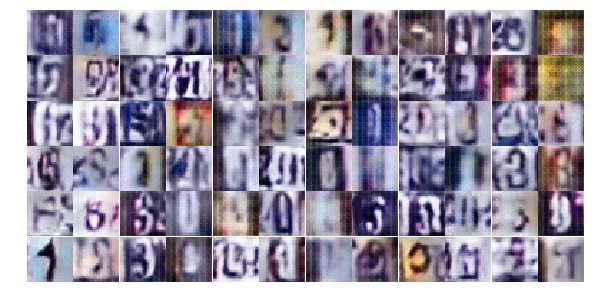

Epoch 17/25... Discriminator Loss: 1.3836... Generator Loss: 0.7093
Epoch 17/25... Discriminator Loss: 1.3861... Generator Loss: 0.6855
Epoch 17/25... Discriminator Loss: 1.3868... Generator Loss: 0.6896
Epoch 17/25... Discriminator Loss: 1.3814... Generator Loss: 0.7012
Epoch 17/25... Discriminator Loss: 1.3865... Generator Loss: 0.6941
Epoch 17/25... Discriminator Loss: 1.3798... Generator Loss: 0.6874
Epoch 17/25... Discriminator Loss: 1.3842... Generator Loss: 0.7089
Epoch 17/25... Discriminator Loss: 1.3869... Generator Loss: 0.7007
Epoch 17/25... Discriminator Loss: 1.3844... Generator Loss: 0.6887
Epoch 17/25... Discriminator Loss: 1.3832... Generator Loss: 0.7087
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


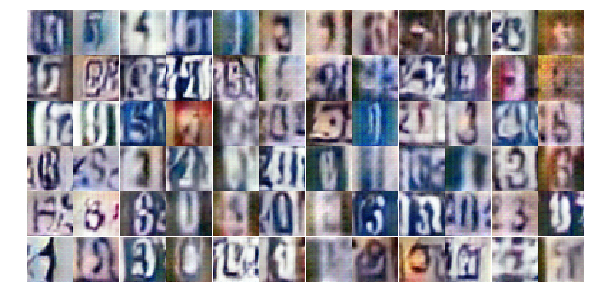

Epoch 17/25... Discriminator Loss: 1.3784... Generator Loss: 0.6768
Epoch 17/25... Discriminator Loss: 1.3903... Generator Loss: 0.7014
Epoch 17/25... Discriminator Loss: 1.3869... Generator Loss: 0.7017
Epoch 17/25... Discriminator Loss: 1.3864... Generator Loss: 0.6774
Epoch 17/25... Discriminator Loss: 1.3838... Generator Loss: 0.6960
Epoch 17/25... Discriminator Loss: 1.3865... Generator Loss: 0.6956
Epoch 17/25... Discriminator Loss: 1.3860... Generator Loss: 0.6970
Epoch 17/25... Discriminator Loss: 1.3835... Generator Loss: 0.6996
Epoch 17/25... Discriminator Loss: 1.3841... Generator Loss: 0.6965
Epoch 17/25... Discriminator Loss: 1.3861... Generator Loss: 0.7017
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


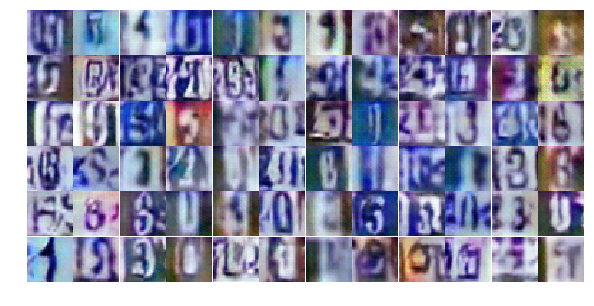

Epoch 17/25... Discriminator Loss: 1.3888... Generator Loss: 0.6909
Epoch 17/25... Discriminator Loss: 1.3864... Generator Loss: 0.6926
Epoch 17/25... Discriminator Loss: 1.3939... Generator Loss: 0.6747
Epoch 17/25... Discriminator Loss: 1.3865... Generator Loss: 0.7119
Epoch 17/25... Discriminator Loss: 1.3844... Generator Loss: 0.7047
Epoch 17/25... Discriminator Loss: 1.3890... Generator Loss: 0.6901
Epoch 17/25... Discriminator Loss: 1.3856... Generator Loss: 0.6841
Epoch 17/25... Discriminator Loss: 1.3868... Generator Loss: 0.6957
Epoch 17/25... Discriminator Loss: 1.3851... Generator Loss: 0.6903
Epoch 17/25... Discriminator Loss: 1.3865... Generator Loss: 0.6915
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


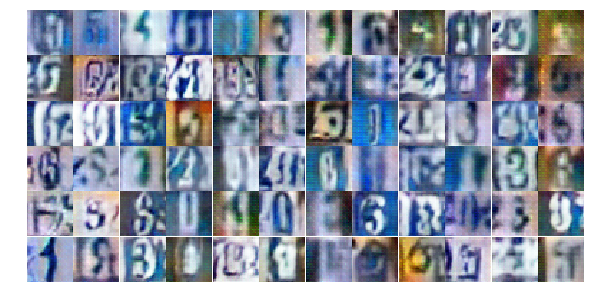

Epoch 17/25... Discriminator Loss: 1.3834... Generator Loss: 0.7035
Epoch 17/25... Discriminator Loss: 1.3938... Generator Loss: 0.7022
Epoch 17/25... Discriminator Loss: 1.3898... Generator Loss: 0.6890
Epoch 17/25... Discriminator Loss: 1.3760... Generator Loss: 0.6837
Epoch 17/25... Discriminator Loss: 1.3883... Generator Loss: 0.6904
Epoch 17/25... Discriminator Loss: 1.3816... Generator Loss: 0.6990
Epoch 17/25... Discriminator Loss: 1.3876... Generator Loss: 0.7035
Epoch 17/25... Discriminator Loss: 1.3874... Generator Loss: 0.6891
Epoch 17/25... Discriminator Loss: 1.3829... Generator Loss: 0.7001
Epoch 17/25... Discriminator Loss: 1.3829... Generator Loss: 0.6925
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


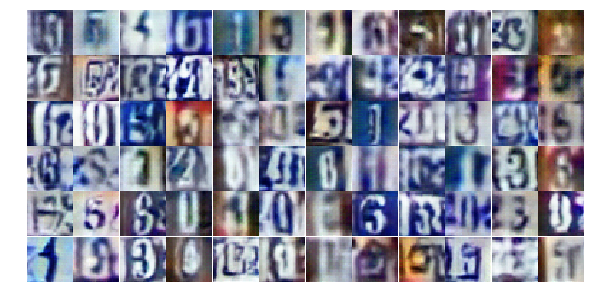

Epoch 17/25... Discriminator Loss: 1.3987... Generator Loss: 0.6854
Epoch 17/25... Discriminator Loss: 1.3814... Generator Loss: 0.6951
Epoch 17/25... Discriminator Loss: 1.3844... Generator Loss: 0.6865
Epoch 17/25... Discriminator Loss: 1.3861... Generator Loss: 0.6934
Epoch 17/25... Discriminator Loss: 1.3838... Generator Loss: 0.6866
Epoch 17/25... Discriminator Loss: 1.3849... Generator Loss: 0.6949
Epoch 17/25... Discriminator Loss: 1.3701... Generator Loss: 0.6726
Epoch 17/25... Discriminator Loss: 1.3835... Generator Loss: 0.6947
Epoch 17/25... Discriminator Loss: 1.3873... Generator Loss: 0.7026
Epoch 17/25... Discriminator Loss: 1.3899... Generator Loss: 0.7087
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


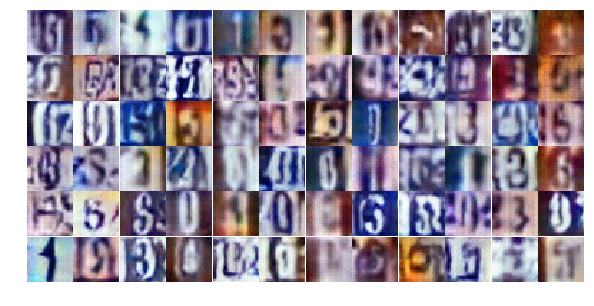

Epoch 17/25... Discriminator Loss: 1.3862... Generator Loss: 0.6960
Epoch 17/25... Discriminator Loss: 1.3838... Generator Loss: 0.6941
Epoch 17/25... Discriminator Loss: 1.3734... Generator Loss: 0.7044
Epoch 17/25... Discriminator Loss: 1.3800... Generator Loss: 0.6914
Epoch 18/25... Discriminator Loss: 1.3851... Generator Loss: 0.7128
Epoch 18/25... Discriminator Loss: 1.3815... Generator Loss: 0.6783
Epoch 18/25... Discriminator Loss: 1.3994... Generator Loss: 0.6549
Epoch 18/25... Discriminator Loss: 1.3792... Generator Loss: 0.7338
Epoch 18/25... Discriminator Loss: 1.4028... Generator Loss: 0.6908
Epoch 18/25... Discriminator Loss: 1.3792... Generator Loss: 0.6755
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


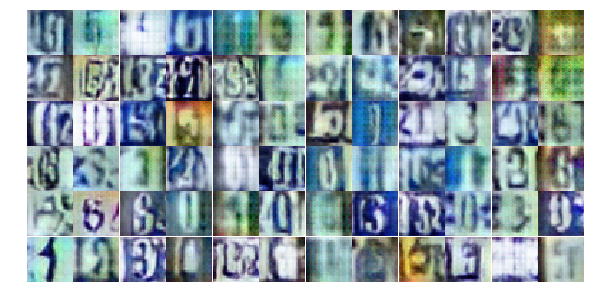

Epoch 18/25... Discriminator Loss: 1.3769... Generator Loss: 0.6926
Epoch 18/25... Discriminator Loss: 1.3845... Generator Loss: 0.7061
Epoch 18/25... Discriminator Loss: 1.3841... Generator Loss: 0.6988
Epoch 18/25... Discriminator Loss: 1.3698... Generator Loss: 0.6786
Epoch 18/25... Discriminator Loss: 1.3857... Generator Loss: 0.7079
Epoch 18/25... Discriminator Loss: 1.3818... Generator Loss: 0.6918
Epoch 18/25... Discriminator Loss: 1.3858... Generator Loss: 0.6981
Epoch 18/25... Discriminator Loss: 1.3837... Generator Loss: 0.6917
Epoch 18/25... Discriminator Loss: 1.3832... Generator Loss: 0.6633
Epoch 18/25... Discriminator Loss: 1.3795... Generator Loss: 0.6986
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


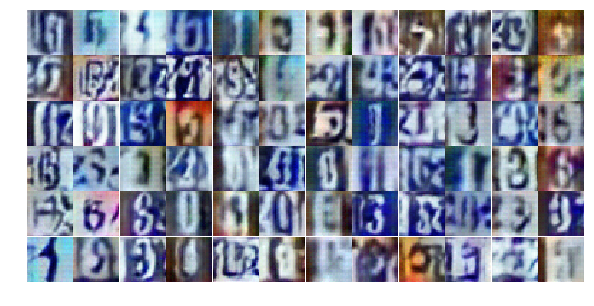

Epoch 18/25... Discriminator Loss: 1.3826... Generator Loss: 0.6924
Epoch 18/25... Discriminator Loss: 1.3894... Generator Loss: 0.6867
Epoch 18/25... Discriminator Loss: 1.3874... Generator Loss: 0.6939
Epoch 18/25... Discriminator Loss: 1.3878... Generator Loss: 0.6975
Epoch 18/25... Discriminator Loss: 1.3722... Generator Loss: 0.7077
Epoch 18/25... Discriminator Loss: 1.3845... Generator Loss: 0.6828
Epoch 18/25... Discriminator Loss: 1.3807... Generator Loss: 0.6919
Epoch 18/25... Discriminator Loss: 1.3816... Generator Loss: 0.7124
Epoch 18/25... Discriminator Loss: 1.3852... Generator Loss: 0.6828
Epoch 18/25... Discriminator Loss: 1.3767... Generator Loss: 0.6938
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


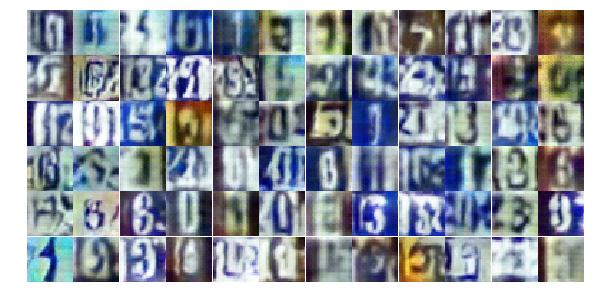

Epoch 18/25... Discriminator Loss: 1.3793... Generator Loss: 0.7092
Epoch 18/25... Discriminator Loss: 1.3845... Generator Loss: 0.6955
Epoch 18/25... Discriminator Loss: 1.3828... Generator Loss: 0.7096
Epoch 18/25... Discriminator Loss: 1.3796... Generator Loss: 0.6934
Epoch 18/25... Discriminator Loss: 1.3850... Generator Loss: 0.7048
Epoch 18/25... Discriminator Loss: 1.3875... Generator Loss: 0.6891
Epoch 18/25... Discriminator Loss: 1.3817... Generator Loss: 0.6955
Epoch 18/25... Discriminator Loss: 1.3839... Generator Loss: 0.6871
Epoch 18/25... Discriminator Loss: 1.3878... Generator Loss: 0.7145
Epoch 18/25... Discriminator Loss: 1.3828... Generator Loss: 0.6774
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


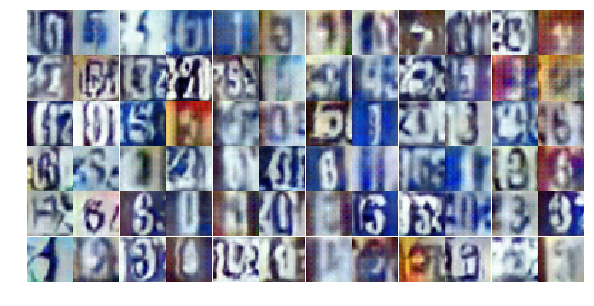

Epoch 18/25... Discriminator Loss: 1.3668... Generator Loss: 0.6824
Epoch 18/25... Discriminator Loss: 1.3826... Generator Loss: 0.7050
Epoch 18/25... Discriminator Loss: 1.3906... Generator Loss: 0.6958
Epoch 18/25... Discriminator Loss: 1.3799... Generator Loss: 0.6968
Epoch 18/25... Discriminator Loss: 1.3816... Generator Loss: 0.6869
Epoch 18/25... Discriminator Loss: 1.3856... Generator Loss: 0.6921
Epoch 18/25... Discriminator Loss: 1.3803... Generator Loss: 0.7018
Epoch 18/25... Discriminator Loss: 1.3827... Generator Loss: 0.6742
Epoch 18/25... Discriminator Loss: 1.3700... Generator Loss: 0.6898
Epoch 18/25... Discriminator Loss: 1.3798... Generator Loss: 0.6955
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


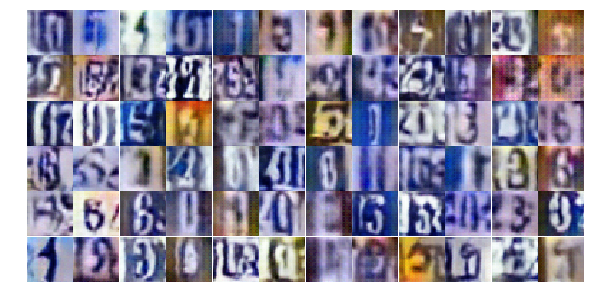

Epoch 18/25... Discriminator Loss: 1.3860... Generator Loss: 0.6962
Epoch 18/25... Discriminator Loss: 1.3844... Generator Loss: 0.6953
Epoch 18/25... Discriminator Loss: 1.3825... Generator Loss: 0.6914
Epoch 18/25... Discriminator Loss: 1.3866... Generator Loss: 0.6994
Epoch 18/25... Discriminator Loss: 1.3838... Generator Loss: 0.6943
Epoch 18/25... Discriminator Loss: 1.3882... Generator Loss: 0.6962
Epoch 18/25... Discriminator Loss: 1.3914... Generator Loss: 0.6966
Epoch 18/25... Discriminator Loss: 1.3852... Generator Loss: 0.6969
Epoch 18/25... Discriminator Loss: 1.3893... Generator Loss: 0.6874
Epoch 18/25... Discriminator Loss: 1.3869... Generator Loss: 0.6991
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


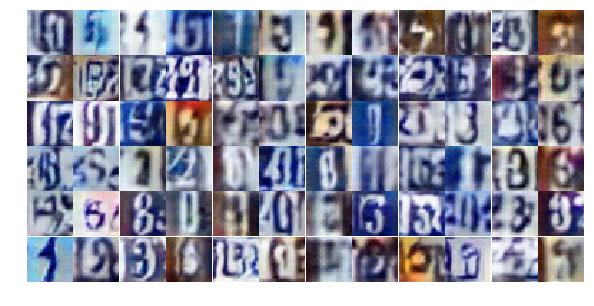

Epoch 18/25... Discriminator Loss: 1.3865... Generator Loss: 0.6898
Epoch 19/25... Discriminator Loss: 1.4015... Generator Loss: 0.6842
Epoch 19/25... Discriminator Loss: 1.3763... Generator Loss: 0.7027
Epoch 19/25... Discriminator Loss: 1.3657... Generator Loss: 0.6959
Epoch 19/25... Discriminator Loss: 1.3969... Generator Loss: 0.7079
Epoch 19/25... Discriminator Loss: 1.3838... Generator Loss: 0.7051
Epoch 19/25... Discriminator Loss: 1.3848... Generator Loss: 0.6863
Epoch 19/25... Discriminator Loss: 1.3867... Generator Loss: 0.7003
Epoch 19/25... Discriminator Loss: 1.3855... Generator Loss: 0.6963
Epoch 19/25... Discriminator Loss: 1.3911... Generator Loss: 0.6831
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


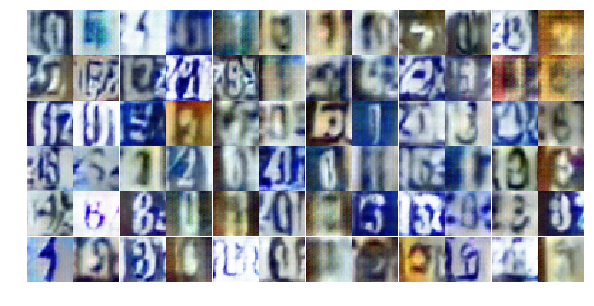

Epoch 19/25... Discriminator Loss: 1.3843... Generator Loss: 0.7062
Epoch 19/25... Discriminator Loss: 1.3806... Generator Loss: 0.7000
Epoch 19/25... Discriminator Loss: 1.3891... Generator Loss: 0.6970
Epoch 19/25... Discriminator Loss: 1.3858... Generator Loss: 0.6863
Epoch 19/25... Discriminator Loss: 1.3760... Generator Loss: 0.6994
Epoch 19/25... Discriminator Loss: 1.3854... Generator Loss: 0.6960
Epoch 19/25... Discriminator Loss: 1.3833... Generator Loss: 0.6915
Epoch 19/25... Discriminator Loss: 1.3827... Generator Loss: 0.6966
Epoch 19/25... Discriminator Loss: 1.3805... Generator Loss: 0.6908
Epoch 19/25... Discriminator Loss: 1.3789... Generator Loss: 0.7057
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


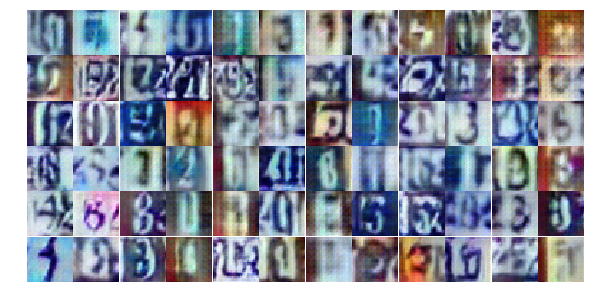

Epoch 19/25... Discriminator Loss: 1.3907... Generator Loss: 0.7036
Epoch 19/25... Discriminator Loss: 1.3844... Generator Loss: 0.6864
Epoch 19/25... Discriminator Loss: 1.3832... Generator Loss: 0.6948
Epoch 19/25... Discriminator Loss: 1.3852... Generator Loss: 0.6977
Epoch 19/25... Discriminator Loss: 1.3858... Generator Loss: 0.6872
Epoch 19/25... Discriminator Loss: 1.3782... Generator Loss: 0.6996
Epoch 19/25... Discriminator Loss: 1.3856... Generator Loss: 0.6992
Epoch 19/25... Discriminator Loss: 1.3779... Generator Loss: 0.6954
Epoch 19/25... Discriminator Loss: 1.3831... Generator Loss: 0.6944
Epoch 19/25... Discriminator Loss: 1.3893... Generator Loss: 0.6909
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


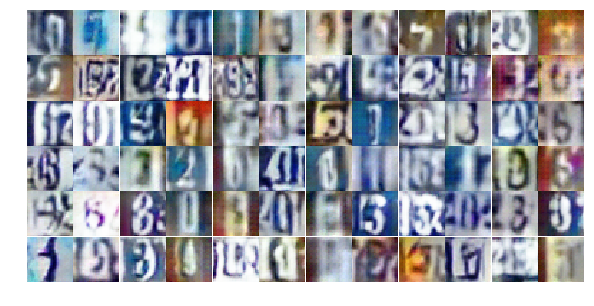

Epoch 19/25... Discriminator Loss: 1.3655... Generator Loss: 0.6830
Epoch 19/25... Discriminator Loss: 1.3854... Generator Loss: 0.7031
Epoch 19/25... Discriminator Loss: 1.3912... Generator Loss: 0.6847
Epoch 19/25... Discriminator Loss: 1.3800... Generator Loss: 0.7005
Epoch 19/25... Discriminator Loss: 1.3849... Generator Loss: 0.6896
Epoch 19/25... Discriminator Loss: 1.3852... Generator Loss: 0.6950
Epoch 19/25... Discriminator Loss: 1.3737... Generator Loss: 0.6825
Epoch 19/25... Discriminator Loss: 1.3860... Generator Loss: 0.6996
Epoch 19/25... Discriminator Loss: 1.3831... Generator Loss: 0.6879
Epoch 19/25... Discriminator Loss: 1.3715... Generator Loss: 0.6765
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


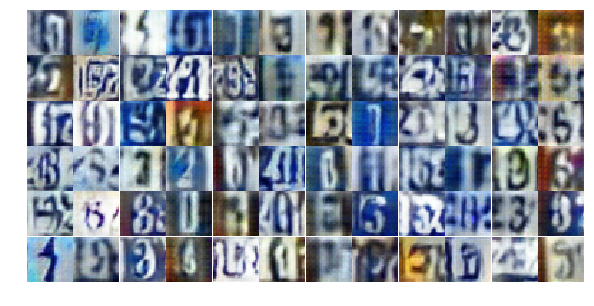

Epoch 19/25... Discriminator Loss: 1.3828... Generator Loss: 0.7216
Epoch 19/25... Discriminator Loss: 1.3841... Generator Loss: 0.6906
Epoch 19/25... Discriminator Loss: 1.3808... Generator Loss: 0.7313
Epoch 19/25... Discriminator Loss: 1.3847... Generator Loss: 0.6952
Epoch 19/25... Discriminator Loss: 1.3846... Generator Loss: 0.6868
Epoch 19/25... Discriminator Loss: 1.3835... Generator Loss: 0.7035
Epoch 19/25... Discriminator Loss: 1.3833... Generator Loss: 0.7212
Epoch 19/25... Discriminator Loss: 1.3830... Generator Loss: 0.6906
Epoch 19/25... Discriminator Loss: 1.3859... Generator Loss: 0.6812
Epoch 19/25... Discriminator Loss: 1.3832... Generator Loss: 0.7034
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


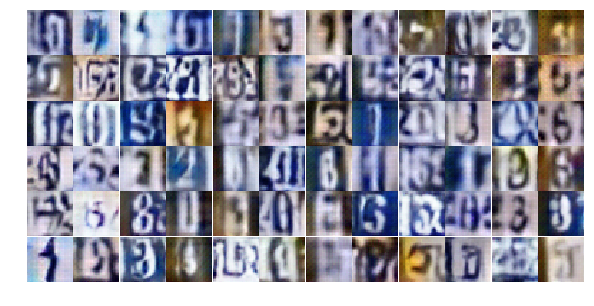

Epoch 19/25... Discriminator Loss: 1.3780... Generator Loss: 0.7000
Epoch 19/25... Discriminator Loss: 1.3781... Generator Loss: 0.6900
Epoch 19/25... Discriminator Loss: 1.3818... Generator Loss: 0.6739
Epoch 19/25... Discriminator Loss: 1.3760... Generator Loss: 0.6910
Epoch 19/25... Discriminator Loss: 1.3828... Generator Loss: 0.6940
Epoch 19/25... Discriminator Loss: 1.3745... Generator Loss: 0.6913
Epoch 19/25... Discriminator Loss: 1.3853... Generator Loss: 0.7074
Epoch 19/25... Discriminator Loss: 1.3901... Generator Loss: 0.6987
Epoch 20/25... Discriminator Loss: 1.3858... Generator Loss: 0.6562
Epoch 20/25... Discriminator Loss: 1.3855... Generator Loss: 0.7035
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


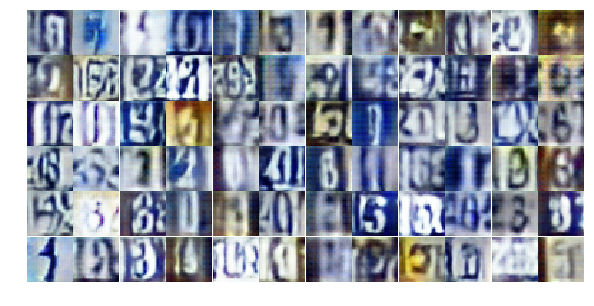

Epoch 20/25... Discriminator Loss: 1.3985... Generator Loss: 0.6588
Epoch 20/25... Discriminator Loss: 1.3849... Generator Loss: 0.7091
Epoch 20/25... Discriminator Loss: 1.3842... Generator Loss: 0.7070
Epoch 20/25... Discriminator Loss: 1.3835... Generator Loss: 0.6881
Epoch 20/25... Discriminator Loss: 1.3802... Generator Loss: 0.6848
Epoch 20/25... Discriminator Loss: 1.3891... Generator Loss: 0.6984
Epoch 20/25... Discriminator Loss: 1.3820... Generator Loss: 0.7010
Epoch 20/25... Discriminator Loss: 1.3833... Generator Loss: 0.6897
Epoch 20/25... Discriminator Loss: 1.3880... Generator Loss: 0.6915
Epoch 20/25... Discriminator Loss: 1.3853... Generator Loss: 0.6975
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


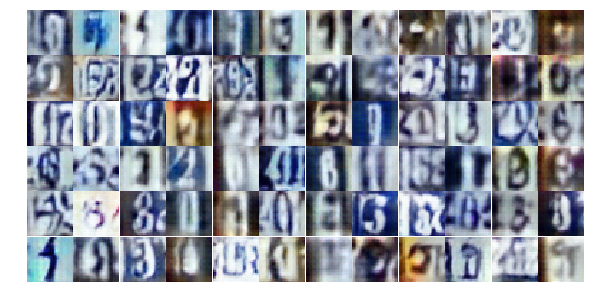

Epoch 20/25... Discriminator Loss: 1.3873... Generator Loss: 0.6849
Epoch 20/25... Discriminator Loss: 1.3860... Generator Loss: 0.6992
Epoch 20/25... Discriminator Loss: 1.3860... Generator Loss: 0.6910
Epoch 20/25... Discriminator Loss: 1.3771... Generator Loss: 0.7161
Epoch 20/25... Discriminator Loss: 1.3822... Generator Loss: 0.7089
Epoch 20/25... Discriminator Loss: 1.3829... Generator Loss: 0.6912
Epoch 20/25... Discriminator Loss: 1.3967... Generator Loss: 0.6803
Epoch 20/25... Discriminator Loss: 1.3831... Generator Loss: 0.6931
Epoch 20/25... Discriminator Loss: 1.3815... Generator Loss: 0.7007
Epoch 20/25... Discriminator Loss: 1.3813... Generator Loss: 0.6951
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


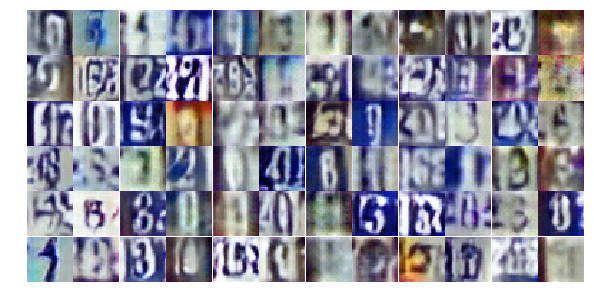

Epoch 20/25... Discriminator Loss: 1.3863... Generator Loss: 0.7016
Epoch 20/25... Discriminator Loss: 1.3851... Generator Loss: 0.6907
Epoch 20/25... Discriminator Loss: 1.3842... Generator Loss: 0.6911
Epoch 20/25... Discriminator Loss: 1.3847... Generator Loss: 0.6895
Epoch 20/25... Discriminator Loss: 1.3838... Generator Loss: 0.6914
Epoch 20/25... Discriminator Loss: 1.3873... Generator Loss: 0.6965
Epoch 20/25... Discriminator Loss: 1.3784... Generator Loss: 0.6977
Epoch 20/25... Discriminator Loss: 1.3822... Generator Loss: 0.6992
Epoch 20/25... Discriminator Loss: 1.3808... Generator Loss: 0.6910
Epoch 20/25... Discriminator Loss: 1.3728... Generator Loss: 0.6830
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


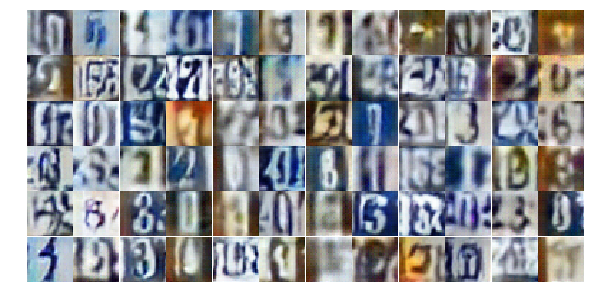

Epoch 20/25... Discriminator Loss: 1.3954... Generator Loss: 0.6917
Epoch 20/25... Discriminator Loss: 1.3869... Generator Loss: 0.6960
Epoch 20/25... Discriminator Loss: 1.3893... Generator Loss: 0.7145
Epoch 20/25... Discriminator Loss: 1.3840... Generator Loss: 0.6944
Epoch 20/25... Discriminator Loss: 1.3827... Generator Loss: 0.6957
Epoch 20/25... Discriminator Loss: 1.3855... Generator Loss: 0.7055
Epoch 20/25... Discriminator Loss: 1.3918... Generator Loss: 0.6719
Epoch 20/25... Discriminator Loss: 1.3863... Generator Loss: 0.6997
Epoch 20/25... Discriminator Loss: 1.3839... Generator Loss: 0.7056
Epoch 20/25... Discriminator Loss: 1.3915... Generator Loss: 0.6826
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


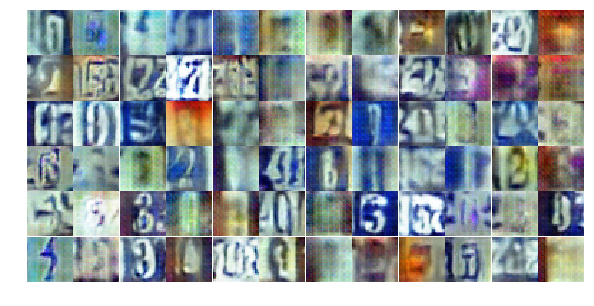

Epoch 20/25... Discriminator Loss: 1.3813... Generator Loss: 0.6839
Epoch 20/25... Discriminator Loss: 1.3857... Generator Loss: 0.6968
Epoch 20/25... Discriminator Loss: 1.3880... Generator Loss: 0.6962
Epoch 20/25... Discriminator Loss: 1.3879... Generator Loss: 0.6972
Epoch 20/25... Discriminator Loss: 1.3834... Generator Loss: 0.7046
Epoch 20/25... Discriminator Loss: 1.3882... Generator Loss: 0.6851
Epoch 20/25... Discriminator Loss: 1.3941... Generator Loss: 0.6936
Epoch 20/25... Discriminator Loss: 1.3839... Generator Loss: 0.6911
Epoch 20/25... Discriminator Loss: 1.3842... Generator Loss: 0.6850
Epoch 20/25... Discriminator Loss: 1.3771... Generator Loss: 0.7014
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


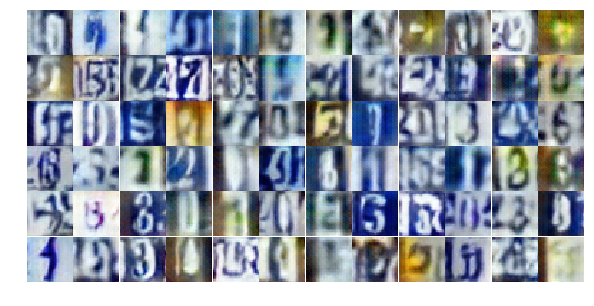

Epoch 20/25... Discriminator Loss: 1.3797... Generator Loss: 0.6889
Epoch 20/25... Discriminator Loss: 1.3878... Generator Loss: 0.7051
Epoch 20/25... Discriminator Loss: 1.3796... Generator Loss: 0.6878
Epoch 20/25... Discriminator Loss: 1.3797... Generator Loss: 0.7059
Epoch 20/25... Discriminator Loss: 1.3939... Generator Loss: 0.6921
Epoch 20/25... Discriminator Loss: 1.3533... Generator Loss: 0.6833
Epoch 21/25... Discriminator Loss: 1.4044... Generator Loss: 0.7023
Epoch 21/25... Discriminator Loss: 1.3800... Generator Loss: 0.6891
Epoch 21/25... Discriminator Loss: 1.3833... Generator Loss: 0.7078
Epoch 21/25... Discriminator Loss: 1.3871... Generator Loss: 0.7013
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


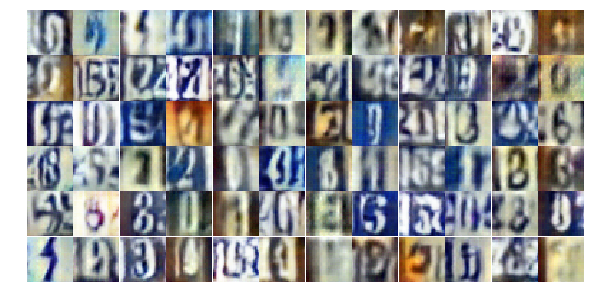

Epoch 21/25... Discriminator Loss: 1.3866... Generator Loss: 0.6918
Epoch 21/25... Discriminator Loss: 1.3876... Generator Loss: 0.6806
Epoch 21/25... Discriminator Loss: 1.3722... Generator Loss: 0.6890
Epoch 21/25... Discriminator Loss: 1.3931... Generator Loss: 0.6982
Epoch 21/25... Discriminator Loss: 1.3831... Generator Loss: 0.6894
Epoch 21/25... Discriminator Loss: 1.3863... Generator Loss: 0.6932
Epoch 21/25... Discriminator Loss: 1.3844... Generator Loss: 0.7121
Epoch 21/25... Discriminator Loss: 1.3838... Generator Loss: 0.6885
Epoch 21/25... Discriminator Loss: 1.3858... Generator Loss: 0.6923
Epoch 21/25... Discriminator Loss: 1.3755... Generator Loss: 0.6918
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


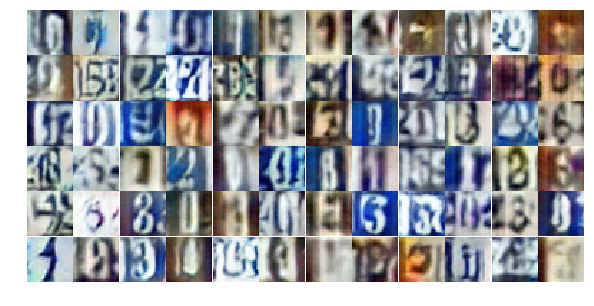

Epoch 21/25... Discriminator Loss: 1.3820... Generator Loss: 0.6882
Epoch 21/25... Discriminator Loss: 1.3867... Generator Loss: 0.6942
Epoch 21/25... Discriminator Loss: 1.3806... Generator Loss: 0.6836
Epoch 21/25... Discriminator Loss: 1.3738... Generator Loss: 0.6753
Epoch 21/25... Discriminator Loss: 1.3776... Generator Loss: 0.6995
Epoch 21/25... Discriminator Loss: 1.3894... Generator Loss: 0.6957
Epoch 21/25... Discriminator Loss: 1.3883... Generator Loss: 0.6844
Epoch 21/25... Discriminator Loss: 1.3833... Generator Loss: 0.6911
Epoch 21/25... Discriminator Loss: 1.3809... Generator Loss: 0.6930
Epoch 21/25... Discriminator Loss: 1.3846... Generator Loss: 0.7067
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


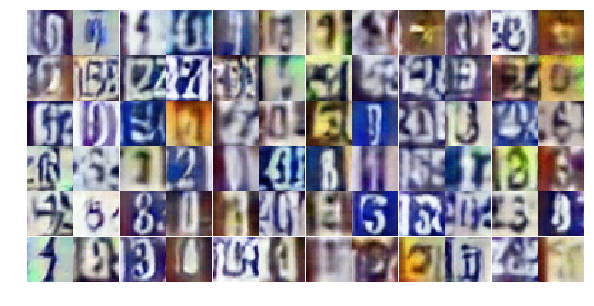

Epoch 21/25... Discriminator Loss: 1.3851... Generator Loss: 0.6942
Epoch 21/25... Discriminator Loss: 1.3831... Generator Loss: 0.6813
Epoch 21/25... Discriminator Loss: 1.3846... Generator Loss: 0.7007
Epoch 21/25... Discriminator Loss: 1.3832... Generator Loss: 0.7104
Epoch 21/25... Discriminator Loss: 1.3822... Generator Loss: 0.6888
Epoch 21/25... Discriminator Loss: 1.3835... Generator Loss: 0.6893
Epoch 21/25... Discriminator Loss: 1.3841... Generator Loss: 0.6995
Epoch 21/25... Discriminator Loss: 1.3909... Generator Loss: 0.6840
Epoch 21/25... Discriminator Loss: 1.3749... Generator Loss: 0.7042
Epoch 21/25... Discriminator Loss: 1.3894... Generator Loss: 0.6962
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


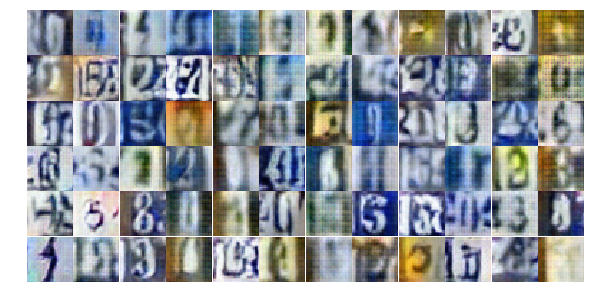

Epoch 21/25... Discriminator Loss: 1.3867... Generator Loss: 0.7065
Epoch 21/25... Discriminator Loss: 1.3852... Generator Loss: 0.6856
Epoch 21/25... Discriminator Loss: 1.3804... Generator Loss: 0.6793
Epoch 21/25... Discriminator Loss: 1.3791... Generator Loss: 0.7017
Epoch 21/25... Discriminator Loss: 1.3859... Generator Loss: 0.7049
Epoch 21/25... Discriminator Loss: 1.3871... Generator Loss: 0.6963
Epoch 21/25... Discriminator Loss: 1.3887... Generator Loss: 0.6861
Epoch 21/25... Discriminator Loss: 1.4028... Generator Loss: 0.6953
Epoch 21/25... Discriminator Loss: 1.4000... Generator Loss: 0.7101
Epoch 21/25... Discriminator Loss: 1.3697... Generator Loss: 0.7092
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


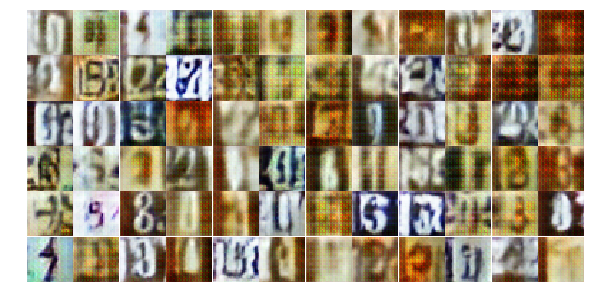

Epoch 21/25... Discriminator Loss: 1.3753... Generator Loss: 0.7086
Epoch 21/25... Discriminator Loss: 1.4019... Generator Loss: 0.6902
Epoch 21/25... Discriminator Loss: 1.3932... Generator Loss: 0.7043
Epoch 21/25... Discriminator Loss: 1.3855... Generator Loss: 0.7214
Epoch 21/25... Discriminator Loss: 1.3843... Generator Loss: 0.6945
Epoch 21/25... Discriminator Loss: 1.3642... Generator Loss: 0.6780
Epoch 21/25... Discriminator Loss: 1.3812... Generator Loss: 0.7094
Epoch 21/25... Discriminator Loss: 1.4002... Generator Loss: 0.6874
Epoch 21/25... Discriminator Loss: 1.3824... Generator Loss: 0.7373
Epoch 21/25... Discriminator Loss: 1.4041... Generator Loss: 0.6700
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


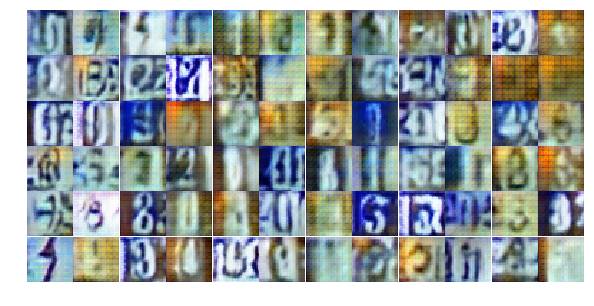

Epoch 21/25... Discriminator Loss: 1.3933... Generator Loss: 0.6921
Epoch 21/25... Discriminator Loss: 1.3791... Generator Loss: 0.6782
Epoch 21/25... Discriminator Loss: 1.3787... Generator Loss: 0.6850
Epoch 22/25... Discriminator Loss: 1.3841... Generator Loss: 0.7282
Epoch 22/25... Discriminator Loss: 1.3944... Generator Loss: 0.6832
Epoch 22/25... Discriminator Loss: 1.3858... Generator Loss: 0.7110
Epoch 22/25... Discriminator Loss: 1.3913... Generator Loss: 0.6962
Epoch 22/25... Discriminator Loss: 1.3844... Generator Loss: 0.6994
Epoch 22/25... Discriminator Loss: 1.3895... Generator Loss: 0.6894
Epoch 22/25... Discriminator Loss: 1.3866... Generator Loss: 0.6946
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


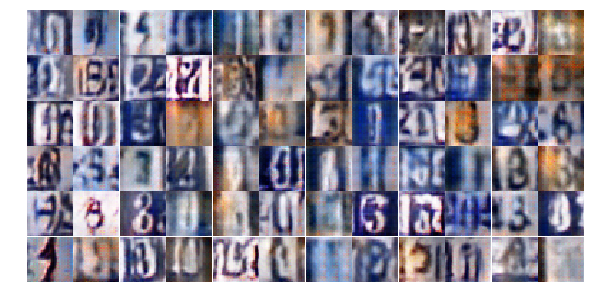

Epoch 22/25... Discriminator Loss: 1.3791... Generator Loss: 0.6866
Epoch 22/25... Discriminator Loss: 1.3850... Generator Loss: 0.7113
Epoch 22/25... Discriminator Loss: 1.3841... Generator Loss: 0.6967
Epoch 22/25... Discriminator Loss: 1.3832... Generator Loss: 0.6771
Epoch 22/25... Discriminator Loss: 1.3891... Generator Loss: 0.7093
Epoch 22/25... Discriminator Loss: 1.3892... Generator Loss: 0.6900
Epoch 22/25... Discriminator Loss: 1.3881... Generator Loss: 0.6903
Epoch 22/25... Discriminator Loss: 1.3851... Generator Loss: 0.6914
Epoch 22/25... Discriminator Loss: 1.3834... Generator Loss: 0.6955
Epoch 22/25... Discriminator Loss: 1.3856... Generator Loss: 0.7092
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


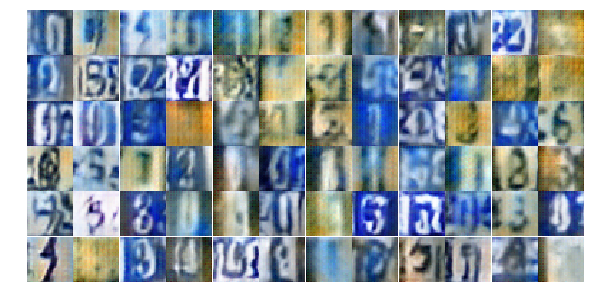

Epoch 22/25... Discriminator Loss: 1.3867... Generator Loss: 0.6896
Epoch 22/25... Discriminator Loss: 1.3896... Generator Loss: 0.6900
Epoch 22/25... Discriminator Loss: 1.3886... Generator Loss: 0.6910
Epoch 22/25... Discriminator Loss: 1.3785... Generator Loss: 0.7008
Epoch 22/25... Discriminator Loss: 1.3811... Generator Loss: 0.7009
Epoch 22/25... Discriminator Loss: 1.3829... Generator Loss: 0.7031
Epoch 22/25... Discriminator Loss: 1.3833... Generator Loss: 0.6840
Epoch 22/25... Discriminator Loss: 1.3870... Generator Loss: 0.6838
Epoch 22/25... Discriminator Loss: 1.3845... Generator Loss: 0.6941
Epoch 22/25... Discriminator Loss: 1.3820... Generator Loss: 0.6905
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


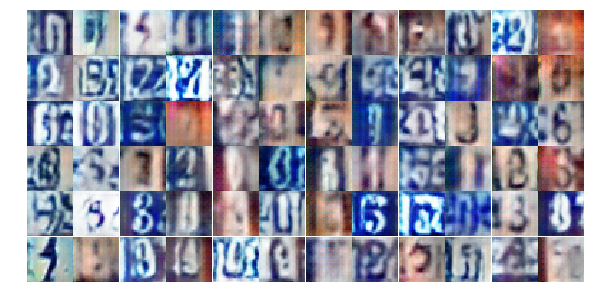

Epoch 22/25... Discriminator Loss: 1.3861... Generator Loss: 0.6982
Epoch 22/25... Discriminator Loss: 1.3842... Generator Loss: 0.6894
Epoch 22/25... Discriminator Loss: 1.3911... Generator Loss: 0.7001
Epoch 22/25... Discriminator Loss: 1.3830... Generator Loss: 0.6952
Epoch 22/25... Discriminator Loss: 1.3905... Generator Loss: 0.6934
Epoch 22/25... Discriminator Loss: 1.4031... Generator Loss: 0.6648
Epoch 22/25... Discriminator Loss: 1.3849... Generator Loss: 0.7311
Epoch 22/25... Discriminator Loss: 1.3854... Generator Loss: 0.6836
Epoch 22/25... Discriminator Loss: 1.3797... Generator Loss: 0.6720
Epoch 22/25... Discriminator Loss: 1.3855... Generator Loss: 0.7146
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


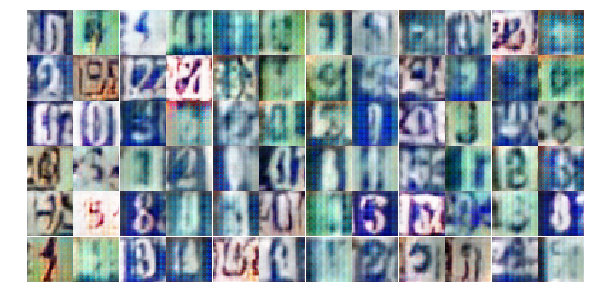

Epoch 22/25... Discriminator Loss: 1.3965... Generator Loss: 0.6788
Epoch 22/25... Discriminator Loss: 1.3841... Generator Loss: 0.6946
Epoch 22/25... Discriminator Loss: 1.3776... Generator Loss: 0.6885
Epoch 22/25... Discriminator Loss: 1.3891... Generator Loss: 0.7054
Epoch 22/25... Discriminator Loss: 1.3793... Generator Loss: 0.6929
Epoch 22/25... Discriminator Loss: 1.3845... Generator Loss: 0.7025
Epoch 22/25... Discriminator Loss: 1.3846... Generator Loss: 0.6834
Epoch 22/25... Discriminator Loss: 1.3705... Generator Loss: 0.7352
Epoch 22/25... Discriminator Loss: 1.3736... Generator Loss: 0.6800
Epoch 22/25... Discriminator Loss: 1.3715... Generator Loss: 0.7407
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


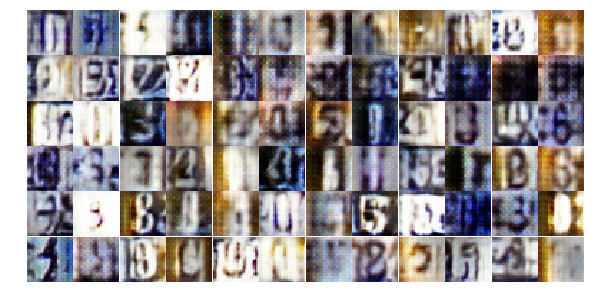

Epoch 22/25... Discriminator Loss: 1.3850... Generator Loss: 0.7030
Epoch 22/25... Discriminator Loss: 1.3902... Generator Loss: 0.7084
Epoch 22/25... Discriminator Loss: 1.3873... Generator Loss: 0.7089
Epoch 22/25... Discriminator Loss: 1.3879... Generator Loss: 0.6985
Epoch 22/25... Discriminator Loss: 1.3756... Generator Loss: 0.6839
Epoch 22/25... Discriminator Loss: 1.3932... Generator Loss: 0.6968
Epoch 22/25... Discriminator Loss: 1.3805... Generator Loss: 0.6863
Epoch 22/25... Discriminator Loss: 1.3789... Generator Loss: 0.6869
Epoch 22/25... Discriminator Loss: 1.3855... Generator Loss: 0.7170
Epoch 22/25... Discriminator Loss: 1.3842... Generator Loss: 0.6891
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


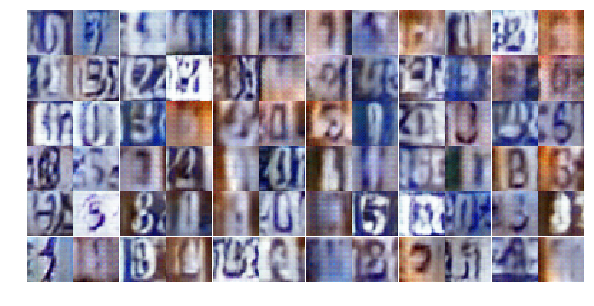

Epoch 23/25... Discriminator Loss: 1.3846... Generator Loss: 0.6794
Epoch 23/25... Discriminator Loss: 1.3868... Generator Loss: 0.6906
Epoch 23/25... Discriminator Loss: 1.3838... Generator Loss: 0.7038
Epoch 23/25... Discriminator Loss: 1.3904... Generator Loss: 0.6996
Epoch 23/25... Discriminator Loss: 1.3852... Generator Loss: 0.6901
Epoch 23/25... Discriminator Loss: 1.3840... Generator Loss: 0.6821
Epoch 23/25... Discriminator Loss: 1.3859... Generator Loss: 0.6951
Epoch 23/25... Discriminator Loss: 1.3822... Generator Loss: 0.7182
Epoch 23/25... Discriminator Loss: 1.3785... Generator Loss: 0.6853
Epoch 23/25... Discriminator Loss: 1.3827... Generator Loss: 0.6881
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


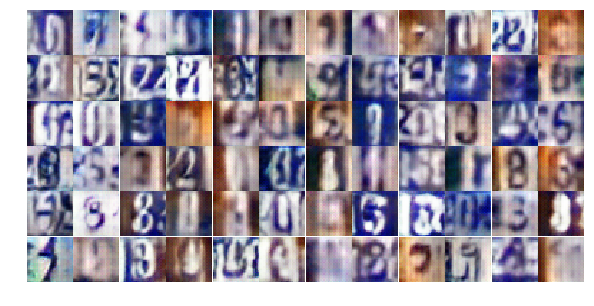

Epoch 23/25... Discriminator Loss: 1.3879... Generator Loss: 0.7043
Epoch 23/25... Discriminator Loss: 1.3851... Generator Loss: 0.6989
Epoch 23/25... Discriminator Loss: 1.3862... Generator Loss: 0.6903
Epoch 23/25... Discriminator Loss: 1.3850... Generator Loss: 0.6998
Epoch 23/25... Discriminator Loss: 1.3846... Generator Loss: 0.6971
Epoch 23/25... Discriminator Loss: 1.3842... Generator Loss: 0.6896
Epoch 23/25... Discriminator Loss: 1.3814... Generator Loss: 0.6879
Epoch 23/25... Discriminator Loss: 1.3754... Generator Loss: 0.7111
Epoch 23/25... Discriminator Loss: 1.3838... Generator Loss: 0.6887
Epoch 23/25... Discriminator Loss: 1.3830... Generator Loss: 0.6771
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


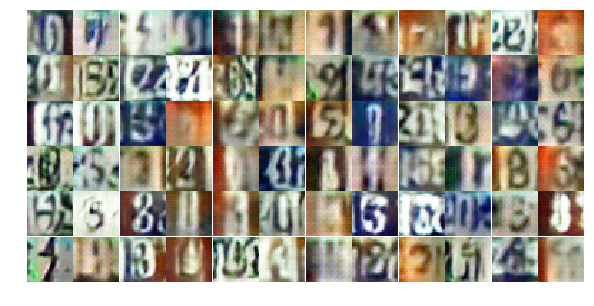

Epoch 23/25... Discriminator Loss: 1.3865... Generator Loss: 0.6985
Epoch 23/25... Discriminator Loss: 1.3798... Generator Loss: 0.7107
Epoch 23/25... Discriminator Loss: 1.3809... Generator Loss: 0.6841
Epoch 23/25... Discriminator Loss: 1.3828... Generator Loss: 0.6892
Epoch 23/25... Discriminator Loss: 1.3856... Generator Loss: 0.7026
Epoch 23/25... Discriminator Loss: 1.3829... Generator Loss: 0.6956
Epoch 23/25... Discriminator Loss: 1.3821... Generator Loss: 0.6907
Epoch 23/25... Discriminator Loss: 1.3824... Generator Loss: 0.6949
Epoch 23/25... Discriminator Loss: 1.3863... Generator Loss: 0.6986
Epoch 23/25... Discriminator Loss: 1.3889... Generator Loss: 0.6936
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


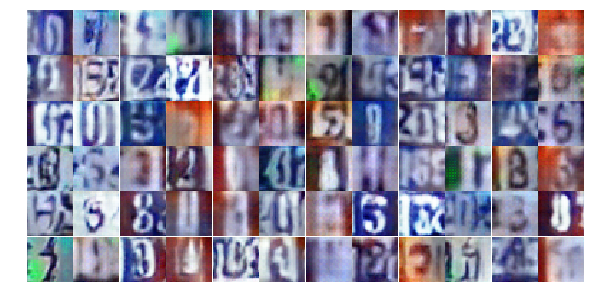

Epoch 23/25... Discriminator Loss: 1.3862... Generator Loss: 0.6935
Epoch 23/25... Discriminator Loss: 1.3844... Generator Loss: 0.6888
Epoch 23/25... Discriminator Loss: 1.3895... Generator Loss: 0.7028
Epoch 23/25... Discriminator Loss: 1.3852... Generator Loss: 0.6757
Epoch 23/25... Discriminator Loss: 1.3852... Generator Loss: 0.7057
Epoch 23/25... Discriminator Loss: 1.3824... Generator Loss: 0.6812
Epoch 23/25... Discriminator Loss: 1.3937... Generator Loss: 0.6982
Epoch 23/25... Discriminator Loss: 1.3820... Generator Loss: 0.7068
Epoch 23/25... Discriminator Loss: 1.3767... Generator Loss: 0.6803
Epoch 23/25... Discriminator Loss: 1.3864... Generator Loss: 0.6967
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


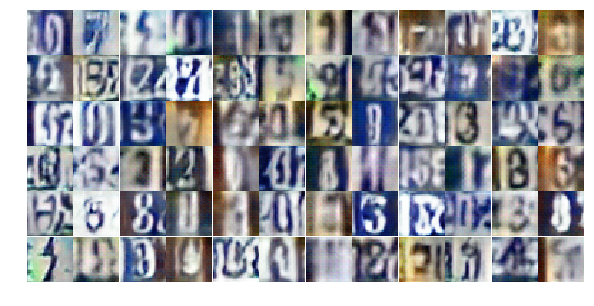

Epoch 23/25... Discriminator Loss: 1.3835... Generator Loss: 0.7098
Epoch 23/25... Discriminator Loss: 1.3809... Generator Loss: 0.6792
Epoch 23/25... Discriminator Loss: 1.3841... Generator Loss: 0.7007
Epoch 23/25... Discriminator Loss: 1.3862... Generator Loss: 0.6983
Epoch 23/25... Discriminator Loss: 1.3880... Generator Loss: 0.6962
Epoch 23/25... Discriminator Loss: 1.3857... Generator Loss: 0.6927
Epoch 23/25... Discriminator Loss: 1.3874... Generator Loss: 0.6765
Epoch 23/25... Discriminator Loss: 1.3869... Generator Loss: 0.6983
Epoch 23/25... Discriminator Loss: 1.3838... Generator Loss: 0.7016
Epoch 23/25... Discriminator Loss: 1.3856... Generator Loss: 0.6783
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


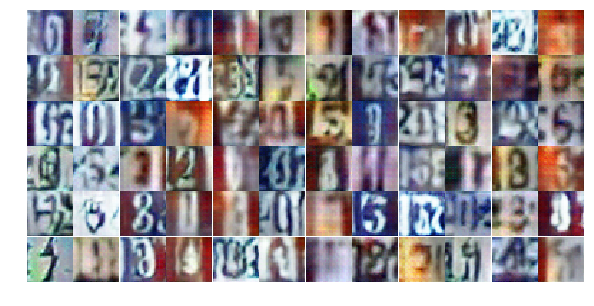

Epoch 23/25... Discriminator Loss: 1.3867... Generator Loss: 0.7007
Epoch 23/25... Discriminator Loss: 1.3845... Generator Loss: 0.7004
Epoch 23/25... Discriminator Loss: 1.3787... Generator Loss: 0.6918
Epoch 23/25... Discriminator Loss: 1.3853... Generator Loss: 0.6933
Epoch 23/25... Discriminator Loss: 1.3851... Generator Loss: 0.6950
Epoch 23/25... Discriminator Loss: 1.3836... Generator Loss: 0.7036
Epoch 23/25... Discriminator Loss: 1.3876... Generator Loss: 0.6907
Epoch 24/25... Discriminator Loss: 1.3823... Generator Loss: 0.6947
Epoch 24/25... Discriminator Loss: 1.3825... Generator Loss: 0.6966
Epoch 24/25... Discriminator Loss: 1.3865... Generator Loss: 0.7050
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


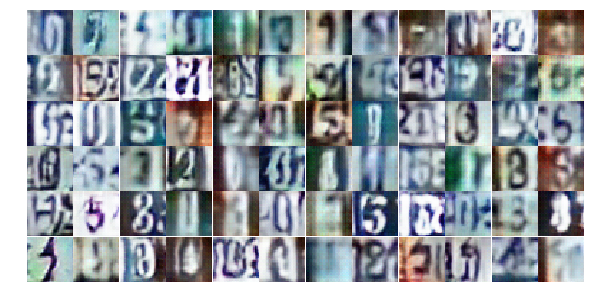

Epoch 24/25... Discriminator Loss: 1.3776... Generator Loss: 0.6839
Epoch 24/25... Discriminator Loss: 1.3872... Generator Loss: 0.7163
Epoch 24/25... Discriminator Loss: 1.3750... Generator Loss: 0.6989
Epoch 24/25... Discriminator Loss: 1.3787... Generator Loss: 0.6852
Epoch 24/25... Discriminator Loss: 1.3885... Generator Loss: 0.6968
Epoch 24/25... Discriminator Loss: 1.3659... Generator Loss: 0.6887
Epoch 24/25... Discriminator Loss: 1.3951... Generator Loss: 0.7039
Epoch 24/25... Discriminator Loss: 1.3888... Generator Loss: 0.6662
Epoch 24/25... Discriminator Loss: 1.3933... Generator Loss: 0.6933
Epoch 24/25... Discriminator Loss: 1.3882... Generator Loss: 0.6952
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


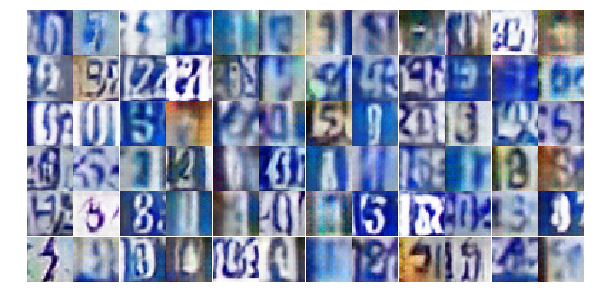

Epoch 24/25... Discriminator Loss: 1.3822... Generator Loss: 0.6911
Epoch 24/25... Discriminator Loss: 1.3870... Generator Loss: 0.6948
Epoch 24/25... Discriminator Loss: 1.3903... Generator Loss: 0.6985
Epoch 24/25... Discriminator Loss: 1.3877... Generator Loss: 0.6900
Epoch 24/25... Discriminator Loss: 1.3809... Generator Loss: 0.6942
Epoch 24/25... Discriminator Loss: 1.3789... Generator Loss: 0.6730
Epoch 24/25... Discriminator Loss: 1.3950... Generator Loss: 0.7054
Epoch 24/25... Discriminator Loss: 1.3835... Generator Loss: 0.6947
Epoch 24/25... Discriminator Loss: 1.3868... Generator Loss: 0.6933
Epoch 24/25... Discriminator Loss: 1.3986... Generator Loss: 0.6747
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


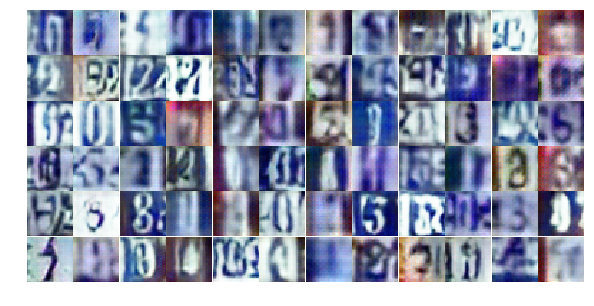

Epoch 24/25... Discriminator Loss: 1.3886... Generator Loss: 0.7063
Epoch 24/25... Discriminator Loss: 1.3860... Generator Loss: 0.6892
Epoch 24/25... Discriminator Loss: 1.4008... Generator Loss: 0.6608
Epoch 24/25... Discriminator Loss: 1.3843... Generator Loss: 0.7298
Epoch 24/25... Discriminator Loss: 1.3874... Generator Loss: 0.6893
Epoch 24/25... Discriminator Loss: 1.3872... Generator Loss: 0.7074
Epoch 24/25... Discriminator Loss: 1.3811... Generator Loss: 0.7011
Epoch 24/25... Discriminator Loss: 1.3852... Generator Loss: 0.6963
Epoch 24/25... Discriminator Loss: 1.3865... Generator Loss: 0.7000
Epoch 24/25... Discriminator Loss: 1.3849... Generator Loss: 0.6920
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


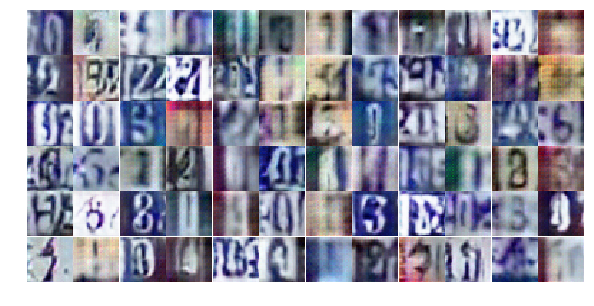

Epoch 24/25... Discriminator Loss: 1.3818... Generator Loss: 0.6824
Epoch 24/25... Discriminator Loss: 1.3811... Generator Loss: 0.7158
Epoch 24/25... Discriminator Loss: 1.3924... Generator Loss: 0.6826
Epoch 24/25... Discriminator Loss: 1.3843... Generator Loss: 0.6540
Epoch 24/25... Discriminator Loss: 1.3931... Generator Loss: 0.7151
Epoch 24/25... Discriminator Loss: 1.3826... Generator Loss: 0.6942
Epoch 24/25... Discriminator Loss: 1.3834... Generator Loss: 0.6939
Epoch 24/25... Discriminator Loss: 1.3917... Generator Loss: 0.6955
Epoch 24/25... Discriminator Loss: 1.3838... Generator Loss: 0.6913
Epoch 24/25... Discriminator Loss: 1.3762... Generator Loss: 0.6879
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


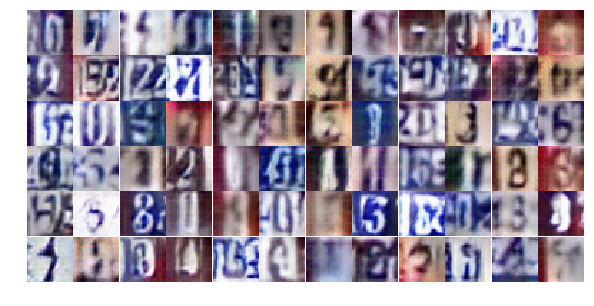

Epoch 24/25... Discriminator Loss: 1.3895... Generator Loss: 0.7104
Epoch 24/25... Discriminator Loss: 1.4003... Generator Loss: 0.6595
Epoch 24/25... Discriminator Loss: 1.3772... Generator Loss: 0.7151
Epoch 24/25... Discriminator Loss: 1.3804... Generator Loss: 0.6823
Epoch 24/25... Discriminator Loss: 1.3864... Generator Loss: 0.6954
Epoch 24/25... Discriminator Loss: 1.3826... Generator Loss: 0.7027
Epoch 24/25... Discriminator Loss: 1.3853... Generator Loss: 0.6875
Epoch 24/25... Discriminator Loss: 1.3842... Generator Loss: 0.6850
Epoch 24/25... Discriminator Loss: 1.3845... Generator Loss: 0.7176
Epoch 24/25... Discriminator Loss: 1.3854... Generator Loss: 0.6952
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


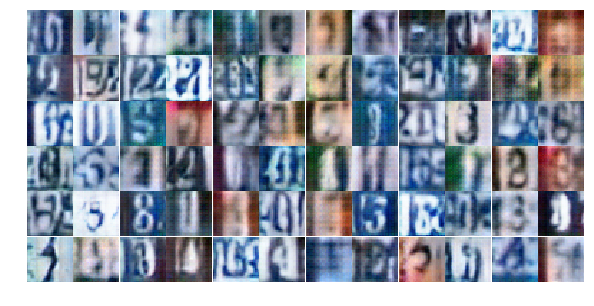

Epoch 24/25... Discriminator Loss: 1.3790... Generator Loss: 0.6914
Epoch 24/25... Discriminator Loss: 1.3830... Generator Loss: 0.7074
Epoch 24/25... Discriminator Loss: 1.4030... Generator Loss: 0.6698
Epoch 24/25... Discriminator Loss: 1.3822... Generator Loss: 0.7021
Epoch 24/25... Discriminator Loss: 1.3859... Generator Loss: 0.6989
Epoch 25/25... Discriminator Loss: 1.3806... Generator Loss: 0.7032
Epoch 25/25... Discriminator Loss: 1.3826... Generator Loss: 0.6932
Epoch 25/25... Discriminator Loss: 1.3858... Generator Loss: 0.6846
Epoch 25/25... Discriminator Loss: 1.3843... Generator Loss: 0.7146
Epoch 25/25... Discriminator Loss: 1.3793... Generator Loss: 0.6956
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


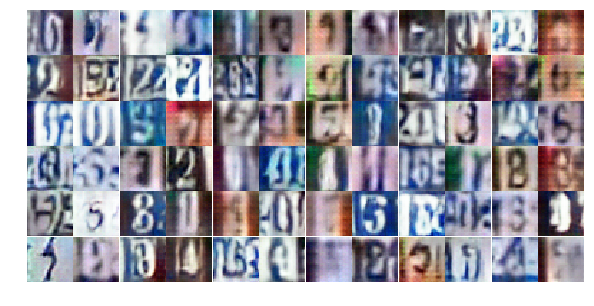

Epoch 25/25... Discriminator Loss: 1.3806... Generator Loss: 0.6967
Epoch 25/25... Discriminator Loss: 1.3758... Generator Loss: 0.6905
Epoch 25/25... Discriminator Loss: 1.3842... Generator Loss: 0.7049
Epoch 25/25... Discriminator Loss: 1.3851... Generator Loss: 0.7053
Epoch 25/25... Discriminator Loss: 1.3817... Generator Loss: 0.6900
Epoch 25/25... Discriminator Loss: 1.3889... Generator Loss: 0.6821
Epoch 25/25... Discriminator Loss: 1.4054... Generator Loss: 0.6966
Epoch 25/25... Discriminator Loss: 1.3830... Generator Loss: 0.6938
Epoch 25/25... Discriminator Loss: 1.3914... Generator Loss: 0.6862
Epoch 25/25... Discriminator Loss: 1.3928... Generator Loss: 0.6832
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


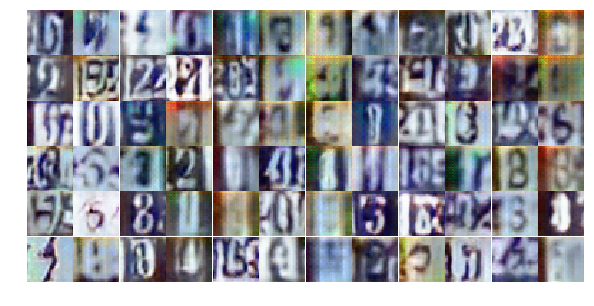

Epoch 25/25... Discriminator Loss: 1.3851... Generator Loss: 0.6916
Epoch 25/25... Discriminator Loss: 1.3766... Generator Loss: 0.7049
Epoch 25/25... Discriminator Loss: 1.3899... Generator Loss: 0.6910
Epoch 25/25... Discriminator Loss: 1.3956... Generator Loss: 0.6847
Epoch 25/25... Discriminator Loss: 1.3859... Generator Loss: 0.7086
Epoch 25/25... Discriminator Loss: 1.3803... Generator Loss: 0.6967
Epoch 25/25... Discriminator Loss: 1.3881... Generator Loss: 0.6919
Epoch 25/25... Discriminator Loss: 1.3985... Generator Loss: 0.6829
Epoch 25/25... Discriminator Loss: 1.3786... Generator Loss: 0.7059
Epoch 25/25... Discriminator Loss: 1.3735... Generator Loss: 0.6788
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


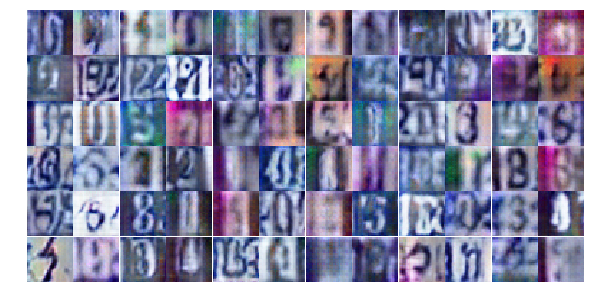

Epoch 25/25... Discriminator Loss: 1.3845... Generator Loss: 0.7110
Epoch 25/25... Discriminator Loss: 1.3754... Generator Loss: 0.6837
Epoch 25/25... Discriminator Loss: 1.3820... Generator Loss: 0.6962
Epoch 25/25... Discriminator Loss: 1.3842... Generator Loss: 0.6886
Epoch 25/25... Discriminator Loss: 1.3882... Generator Loss: 0.6958
Epoch 25/25... Discriminator Loss: 1.3912... Generator Loss: 0.6984
Epoch 25/25... Discriminator Loss: 1.3888... Generator Loss: 0.6797
Epoch 25/25... Discriminator Loss: 1.3786... Generator Loss: 0.6967
Epoch 25/25... Discriminator Loss: 1.3891... Generator Loss: 0.7226
Epoch 25/25... Discriminator Loss: 1.3847... Generator Loss: 0.6763
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


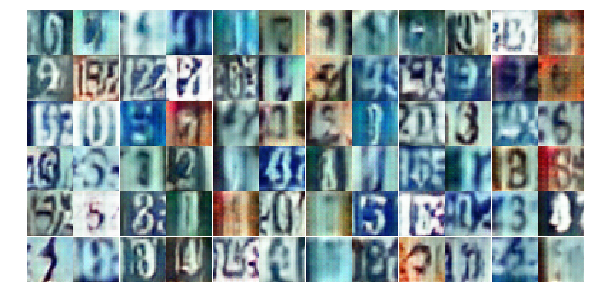

Epoch 25/25... Discriminator Loss: 1.3801... Generator Loss: 0.6982
Epoch 25/25... Discriminator Loss: 1.3854... Generator Loss: 0.7018
Epoch 25/25... Discriminator Loss: 1.3861... Generator Loss: 0.6974
Epoch 25/25... Discriminator Loss: 1.3848... Generator Loss: 0.6835
Epoch 25/25... Discriminator Loss: 1.3843... Generator Loss: 0.6960
Epoch 25/25... Discriminator Loss: 1.3802... Generator Loss: 0.7079
Epoch 25/25... Discriminator Loss: 1.3853... Generator Loss: 0.6891
Epoch 25/25... Discriminator Loss: 1.3734... Generator Loss: 0.7136
Epoch 25/25... Discriminator Loss: 1.3711... Generator Loss: 0.6635
Epoch 25/25... Discriminator Loss: 1.3823... Generator Loss: 0.7125
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


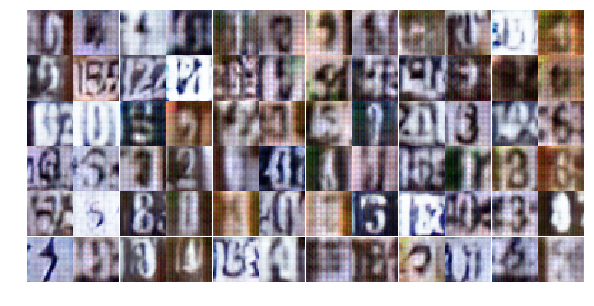

Epoch 25/25... Discriminator Loss: 1.3843... Generator Loss: 0.6903
Epoch 25/25... Discriminator Loss: 1.3828... Generator Loss: 0.7015
Epoch 25/25... Discriminator Loss: 1.3782... Generator Loss: 0.7060
Epoch 25/25... Discriminator Loss: 1.3890... Generator Loss: 0.7002
Epoch 25/25... Discriminator Loss: 1.3811... Generator Loss: 0.6930
Epoch 25/25... Discriminator Loss: 1.3583... Generator Loss: 0.6561
Epoch 25/25... Discriminator Loss: 1.3905... Generator Loss: 0.7118
Epoch 25/25... Discriminator Loss: 1.3872... Generator Loss: 0.6873
Epoch 25/25... Discriminator Loss: 1.3849... Generator Loss: 0.6809
Epoch 25/25... Discriminator Loss: 1.3827... Generator Loss: 0.6820
generator():
...z.shape: [None, 100]
...output_dim: 3
...x.shape(): [None, 4, 4, 1024]
...x.shape(): [None, 8, 8, 512]
...x.shape(): [None, 16, 16, 256]
...logits.shape(): [None, 32, 32, 3]


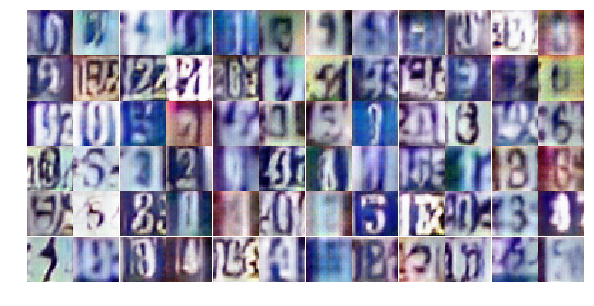

Epoch 25/25... Discriminator Loss: 1.3735... Generator Loss: 0.7044
Epoch 25/25... Discriminator Loss: 1.3811... Generator Loss: 0.7187


In [132]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

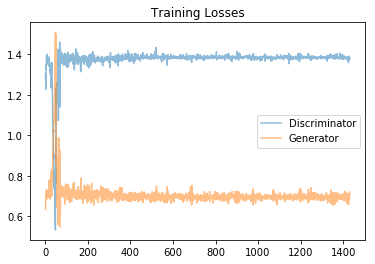

In [133]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

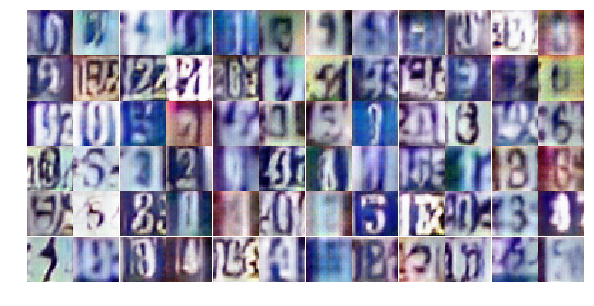

In [134]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))